In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
from konlpy.tag import Okt 
from ckonlpy.tag import Twitter #prompt에서 pip install customized_konlpy 로 패키지 설치

In [8]:
#크롤링한 데이터 파일 불러오기
#중복제거 및 널값제거 
df = pd.read_csv('../datasets/crawling_from20200101_to20201015.csv', index_col=0)
df.drop_duplicates(inplace=True)
df.dropna(subset=['title'],how='any',inplace=True)
df.reset_index(drop=True, inplace=True)
print(df.info()) 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18779 entries, 0 to 18778
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   title   18779 non-null  object
 1   date    18779 non-null  object
dtypes: object(2)
memory usage: 293.5+ KB
None


In [9]:
#한국어에 사용할 토크나이저
twitter = Twitter()

c:\users\024\anaconda3\envs\machinelearning\lib\site-packages\konlpy\tag\_okt.py:16: UserWarning: "Twitter" has changed to "Okt" since KoNLPy v0.4.5.
  warn('"Twitter" has changed to "Okt" since KoNLPy v0.4.5.')


In [115]:
#토큰화에 제외할 단어 토크나이저 딕셔너리에 추가 
twitter.add_dictionary(['네네치킨,''뿌링클','맛스타그램', '맛스타', '푸라닭', '스타그램', '인스타', '또래오래', '배달의민족','배민', 'instagram', '뿌링클', '고추바사삭', '뿌링뿌링','뿌링뿌링소스' ,'뿌링소스', '또래오래', '인스타 그램','인스타그램', '황금올리브','네고왕','맘스터치','에어프라이어','블랙치즈볼','블랙알리오','청년치킨','청년피자'], 'Noun',force=True)

#for word in imp_wrd['important_words']:
#    twitter.add_dictionary('{}', 'Noun').format(word)
    




In [11]:
#딕셔너리 추가된 것 테스트 
twitter.morphs('일주일만에 다시 찾은 뿌링클 맛스타그램 네고왕')

['일주일', '만에', '다시', '찾은', '뿌링클', '맛스타그램', '네고왕']

In [12]:
#stopwords 현 디렉토리에 추가 해야함 
stopwords = pd.read_csv('../datasets/stopwords.csv',  encoding='CP949' ,index_col = 0) 
print(stopwords.head())
print(stopwords.tail())


  stopword
0        아
1        휴
2      아이구
3      아이쿠
4      아이고
    stopword
661       추천
662       일상
663     있습니다
664       이라
665       많이


In [13]:
#프랜차이즈 리스트 
stores = pd.read_excel('../datasets/프렌차이즈.xlsx')
stores
stores.reset_index(drop=True, inplace=True)
print(stores.info()) 
stores.columns
#stores = pd.read_csv('./stores.csv', 
#                    encoding='euc-kr', index_col=0)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1835 entries, 0 to 1834
Data columns (total 15 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   한식      1835 non-null   object
 1   분식      455 non-null    object
 2   중식      111 non-null    object
 3   일식      201 non-null    object
 4   양식      181 non-null    object
 5   양식(외)   109 non-null    object
 6   패스트푸드   102 non-null    object
 7   치킨      519 non-null    object
 8   피자      183 non-null    object
 9   제과제빵    172 non-null    object
 10  아이스크림   40 non-null     object
 11  카페      456 non-null    object
 12  커피외음료   84 non-null     object
 13  술집      315 non-null    object
 14  기타외식    1001 non-null   object
dtypes: object(15)
memory usage: 215.2+ KB
None


Index(['한식', '분식', '중식', '일식', '양식', '양식(외)', '패스트푸드', '치킨', '피자', '제과제빵',
       '아이스크림', '카페', '커피외음료', '술집', '기타외식'],
      dtype='object')

In [112]:
#토큰화 및 텍스트 데이터 전처리 
cleaned_sentences = []

for sentence in df['title']:
    E_sentence = re.sub('[^a-zA-Z]',' ', sentence)  #영어텍스트만 뽑아오기 
    E_token = E_sentence.split(' ')   #영어텍스트를 띄어쓰기 기준으로 토큰화 
    K_sentence = re.sub('[^가-힣]',' ', sentence)  #한글텍스트만 뽑아오기
    K_token = twitter.nouns(K_sentence) #한글텍스트를 토큰화 및 명사만 남기기 
    K_token = pd.DataFrame(K_token, columns=['word'])   #토큰화된 한글텍스트를 다시 데이터프레임으로 만들기
    token = E_token + list(K_token['word'])    #토큰화된 한글, 영어텍스트를 합치기 
    cleaned_token = pd.DataFrame(token, columns=['word'])   #합친 것을 다시 데이터프레임으로 만들기 
    words = []
    for word in cleaned_token['word']:  #불용어 제거 
        if len(word)>1: 
            if word not in (list(stopwords['stopword'])): 
                  words.append(word)
            else: print(word) 
        else: print(word)    
    cleaned_sentence = ' '.join(words)
    cleaned_sentences.append(cleaned_sentence)

df['cleaned_content'] = cleaned_sentences


















































애
씨
오늘


































































































































애
여러분
거의























































































애
거
















































































애
더
킹
리얼



























애
















































애
움













































애
내
볼
담

































































































애
습
짱
아하
데
리뷰
선
후
율
번
포







































애
내














































애
진짜














































































애
전
다만
육








































































애
습
업
우리
요


































애
습






















































































































D




















































































고
퓨
진짜
를
왜
요















































D






































고





































































뭘
더
어요



























































































뭘
완전
보
























































































뭘
생각
욤
용
요















































































































































































뭘
저
진짜
아하
데
수
거
기
주문
돈
너
젠
저
꼭
어요

























































































뭘
어요


















































뭘







































































































뭘
완전
완전
저
요


















































































































































맘
집
내
더
맘
맘
볼
더
것
거
저
당장
어요
맘





































































































































































































































































맘
집
내
더
맘
맘
저
적
맛
낼
안
개
슬
를
조금
진짜
맛
고
조금
돌
해도
안
맛












































































맘
집
내
더
맘
저
어요































































맘
집
내
더
맘
꼭




























































맘
집
내
더
맘
어요
































































































맘
집
내
더
맘
맘
표




































































맘
집
내
더
맘
맘




































































































































시간
맛
요
































































































































시간
맛
그
완전
조각
어요
님
볼
쏙
전
느낌
랄


































































시간
맛
거
뎅























































































시간
맛
왜
워

















































































코
트
개
진짜






































언
옷
모



















































































































볼
땐
보
입



































































이
짓




























































































































나
살
것
안
안
게
함
식





























































진짜







































옷
요

























































살
왜
바로













































































윤
윤
리뷰
요
오늘

































































































윤
윤
리뷰
욤
말



























































윤
윤
리뷰
등







































































































윤
윤
리뷰
내
이번
생
화
화
화
화































































윤
윤
리뷰






































































윤
윤
리뷰
쌤
무엇

























































윤
윤
리뷰
등












































a
떡








































































떡
완전
아하
데





























































































































떡
젠
집
메뉴
눈
거의












































a

I
떡
















































떡

































































































































































































































































































































술
떡
떡
회
태
것
술
주
보
면서
저
요
게
내
뜻
대로
일
내
왜
후
힘
수
도
것
오
용
매번
것
정말
요
오늘


























































































술
떡
떡
회
태

































강
강




































































강
이
과
손
뿐





































강
찍
줄






















































강
또
심지어










































강
너
앜
개






















































































강
즘
조금
힘
완전









































강

























































강
강
흐
후
바
흐
막
심

















































강
중
이























































































































봉
메뉴
꿀
까지
꿀
진짜
속
꿀
완전
완전
구
오늘
안
꿀
요
























































































봉
메뉴
꿀
까지
제
메뉴
담
거
진짜
























































































봉
메뉴
꿀
까지
처
데
내
다시











































































































자
킨
후
킨
자
킨
리뷰
싱












































































자
킨
후
킨
자
킨
핫
저희


















































































자
킨
후
킨
자
킨
비
진짜
눈
귀
호


















































































자
킨
후
킨
자
킨
맛




























































































































자
킨
후
킨
자
킨
저
봣
단
끝
맵
해
맛
요
치



























































































































떡
떡
리얼
볼
입



























































떡
떡
리얼
정말







































































































떡
떡
리얼
자
저
오늘











































떡
떡
리얼












































떡
떡
리얼









































































떡
떡
리얼
등
해


































































떡
떡
리얼
일단
느낌




















































떡
떡
리얼
어요











































떡
떡
리얼

















































떡
떡
리얼

































































떡
떡
리얼
왜
질




























































떡
떡
리얼
볼

















































떡
떡
리얼


































































떡
떡
리얼

















































































빵
뽀
트
빵
음
리뷰
트
생각
맛
기
좀
요
느낌
트
메뉴
리뷰
볼
수
어서
어요












































































빵
뽀
트
빵
음
리뷰
맛
바로
희


































































































빵
뽀
트
빵
음
리뷰
희
건
진짜
나
밥
어서




















































































































빵
뽀
트
빵
음
리뷰
트
볼
달
실
처
어요
리뷰
신
감



























































































































빵
뽀
트
빵
음
리뷰
희
저
맛
트
희
거
보
어요






















































빵
뽀
트
빵
음
리뷰






























































빵
뽀
트
빵
음
리뷰
내
아하
뽀
침








































































빵
뽀
트
빵
음
리뷰
빵
양



























































































































빵
뽀
트
빵
음
리뷰
리뷰
어요
뭘
어요
처

비
날
여러분
맘
후






























































































맘
비
날
여러분
맘
맘
더
요























D


O
햄
리얼
더























I
I
햄
리얼
더






















































































햄
리얼
더
것
란
맨
밑
왜
안
심지어
란
거
























햄
리얼
더























햄
리얼
더
























햄
리얼
더























햄
리얼
더























a

햄
리얼
더


















































햄
리얼
더
면서
마치
환
기























햄
리얼
더























햄
리얼
더
























햄
리얼
더
































































햄
리얼
더























햄
리얼
더























햄
리얼
더























햄
리얼
더
























I

햄
리얼
더
























햄
리얼
더





























I

율












































































































율
다른
건
눈
어요


w
































틐
w
















































건
시
w






























w
































































구
임
w










































때
w




















w
























































진짜
게

























































씨
리뷰
집
더
짐
양
비
금
데
선

















































































씨
리뷰
집
더
짐
양
비
저
양
저
원




























































































































































































































































씨
리뷰
집
더
짐
양
비
꼴
집
진짜
임
고
때
저
편이
때
손
머
거
거
진짜
손
리
해도
그
김





































































씨
리뷰
집
더
짐
양
비
뭐



























































































씨
리뷰
집
더


리얼





































g

r
n
g

n


























































I
I
리얼
얼마나
합
나
유
이





































g

r
n
g

n

리얼





































g

r
n
g

n



















































리얼





































g

r
n
g

n

리얼





































g

r
n
g

n

































































리얼
닝
저
어요





































g

r
n
g

n

리얼








































뿐
빠





















a














































































































a











































a
I
a
























































































a






















I
I























































































































































































































핫
빨
진
완전
완전
호
님
호
정말
고
어요
저희


























































































































































































핫
빨
진
괒
님
손
저
약간
분
손
생각
















































































































핫
빨
진
여러분
욕











































































































핫
빨
진
살
면서



































































































































핫
빨
진
뿌
낼
낼
바
오늘































































































핫
빨
진
괒
초
구

























































































































































































핫
빨
진
괒


































댁
먹기
불
말









































































댁
먹기
불
탕
비
연










































































댁
먹기
불
탕










































































































댁
먹기
불
탕
진짜
우리
것
귀







































































댁
먹기
불
탕
생




















































































































댁
먹기
불
탕
진짜
알
우리
어요
오늘










































































































댁
먹기
불
탕
입
때
이
진짜
이






























































































댁
먹기
불
탕
둘
역시







































































댁
먹기
불
탕
면

























































































































































































































시
역시
내
리뷰
신
메뉴
츠
더
간
훅
어요





















































































































































































































시
역시
내
리뷰
신
메뉴
진짜
까지
말
좀
그
런
수
더라도
맛
함
전
안
것
무
거
보
꼭
어요

















































시
역시
내
리뷰
신
메뉴
오
옷


























































시
역시
내
리뷰
신
메뉴
욬










































































시
역시
내
리뷰
신
메뉴
내
핵




























































시
역시
내
리뷰
신
메뉴
니
분
것













































시
역시
내
리뷰
신
메뉴
어디






































I
시
역시
내
리뷰
신
메뉴






































a

시
역시
내
리뷰
신
메뉴
































































































































이
나
누가
입






















x





























거
셔






















x


















































거
손
것
고






















x























거
귀
여
워






















x























거
줄







































리얼







































































리얼
형








































리얼












































































리얼
뭐
돈





















































리얼
보




















































리얼
이
람
손



































a

리얼

































































리얼
까지

























































리얼
끼



























































































































리얼
끼



















































리얼

























































I


































a



































































































































































































































































나
그
무엇
그
무엇
나
기
수
이
곳
전



































































































































































a












































































































































































































































진짜
맛
보
굿

































































솔
젤
중























































































































소
생각
다음
떡
떡
회
바
등등
어요
































































윙
탕
그
못







































































































































































흥
노
청
흥
까지
이번
오
저
어요






































































































































































































































흥
노
청
까지
워
다음
더
생각
워
고
인
또
옹














































































































































































흥
노
청
오늘
구
추천
면
전
































































































































































흥
노
청
제
아하
분
어요
분
면서
오늘

































































































































































살
입
입
저
흠
복
어서
제
것
























































살
요





















































살
맛
거






















































































살
입
입
오늘
저






























































살
딩
복














































살
잔
















































살
워






























































살
앗
오늘





































































살
꼭



















































































































살
메뉴
워
자
명































































































































나
리얼
영
왜
안
데
나
보
면서


























































나
리얼
나
여기
은
입























































































M















































































































































뭐
필
기
종
건
욕
저
더
앞
M


























































































뭐
필
기
종
핀
건
M







































































































뭐
필
기
종
건
밑
M












































































































뭐
필
기
종
건
면서
진짜
워
필
워
M











































































뭐
필
기
종
존
워
진짜
M
















































































뭐
필
기
종
건
M








































































































뭐
필
기
종
닭
세
네
손
이
벅
M


































































































뭐
필
기
종
덜
속
정
진짜
M




































































X











































I

인
짱
신
메뉴
블











X

































































인
짱
신
메뉴
블
보
자마자
침
정말











X





























































































































인
짱
신
메뉴
블
당신
그
당신
당신
팬
나
당신
팬
중
하나











X












































인
짱
신
메뉴
블











X












































i

인
짱
신
메뉴
블











X
































































w










인
짱
신
메뉴
블






















































원
귀
쁜
























































































원
함
시각







































원












































원
원







































원






































i
원






































원






































원

















































저





































명























































데
무슨
맛












































떡
떡













































떡
떡













































떡
떡












































I

떡
떡













































떡
떡












































떡
떡












































떡
떡













































떡
떡













































떡
떡












































i
떡
떡













































떡
떡












































I
I

떡
떡












































떡
떡













































떡
떡












































u

떡
떡













































떡
떡












































i
떡
떡





















































































곰
웅
소통
약간






































































곰
웅
소통
삐









































































곰
웅
소통
추가
진짜
임












































































































곰
웅
소통
조차
아하
힝
어요
아하


























































































곰
웅
소통
소통
치
못














































I

곰
웅
소통


























I
I
I
I
a
a
짱
리얼






















짱
리얼






















I
i
짱
리얼

















































p






































































짱
리얼
붕
켜
오늘
찌
볼
해
쭉
제
깨
어서
번
어요
욤



























짱
리얼

































짱
리얼











































짱
리얼
귀
요





























































짱
리얼


































































































































리
폭
엽
생
리
콘





















































































































리
폭
엽
생
리
시
두
분
난
실
















































































































리
폭
엽
생
리
진짜
드
분
이
















































































































리
폭
엽
생
리
진짜
너
무
보
어요






























































































































리
폭
엽
생
리
완전
인
떡




































































































































































리
폭
엽
생
리
돌
진짜
어요
리
다음
날
뭐
















































































리
폭
엽
생
리
당신
















































































































































































킹
단
욥
여
겉
빵
안
정말
변
















































































































추천
메뉴
고
고
키
하나
저
반
속
쭉











































































































거
주문
때
주문
저
점
어요


















































































































누
밥
볼
누
밥
볼
집
려
볼
때
빠
각
























































































































킨
점
메뉴
세
맛
고
하나
더
원
이
더
킨
안
































































































































반
았
온
앞
뻔
개
내



























































































































우리
집
닝
향
우리
집
진짜














































































































































노
막
느낌
빵
피
거의
급
전
이
면
어요
맛
돠










































































































잠시
하나
어요
어찌
맛
개











































































































점
단
봉
안
다른
점
빵
빵
비
선
조금
고
만

































































































리
평
개
추천
요
저
아하
데
다시
돈
맛




















































































































볼
신
메뉴
약간
쭉
역시









































































































메뉴
추천
킹
안
느낌
고
느낌
고
느낌
요















































































D
























리뷰
치
나
까지
나
그때
꼭
메뉴
수

















































































































































































































윤
킹
좌
킹
날
메뉴
저
맵
개
도










































































































진짜
하하
집
이
거













































































































메
츠
메
츠
겉
속
꿀
함
메뉴
도
애



























































































































양
맛
첫
맛
맛
메뉴
년
월
주문
맛
탕
원
원
원





























































































거
이상
거
오늘
셔













































































































역시
아이
맛
맛
어요
매
안
또



















































































































메뉴
핫
입
옆
요
진짜
메뉴
방








































































































































































































계
쭉
주문
때
이번













































































































거
겉
맛
욬
딥
딥













































































































저희
추가
진짜
저희
잔
추가
추천
것
고














































































































등
저희
식탁
위
등

















































































































황
마리
저
부터
왜
요
향
안
향



































































































볼
안
맛
맛
느낌
도
노
어서
겉















































































































콥
후
진짜
때
걸





































































































닭
살
윙
닭
개
개
봉
개
개
왜
고














































































































































피
추천
기
안
약
달
면서
맛
저
봉

































































































































솔
맛
저
번
조각
번
조각
반
마리












































































































점
보
추천
요
개
원
작
닝
어서
좀
잡
유














































































































주문
성
요
님
볼
안
담



















































































































요
조각
반
마리
개
개
저
개
개
개
어요































































































































연
요







































































































신
메뉴
집
느낌
빵
더
것
나
아하
재
























































때
그
년
처



















































































































킨
떡
빵
식
어요
욱
맛
나









































































































평
겉
데
게다가
더


























































































































추천
모
어요
중
곳
이
꽤
다만












































































































맛
겉
때
글
맛
진짜
맛
음




















































































































마
및
안
어요
어요
겉
언제







































































































































쿡
어요
자
준
다음
볼















































































































트
살
쉬
아이
아하
고
저
더
어요
애
어요

































L













































런
안
살
킹
킹
킹
달
맛
르
수




































































































바
메뉴
바
메뉴
팍
때
만큼
활








































































































점
줄
약간
느낌
안
고
더
다음
날


























































































땐
갑
추가
주문













































































































오
정말
이상
안
생각
땋
이상
것
볼
수
그
이상
































































































































조각
황
반
마리
개
황
역시
안
개
색
것
빛
도
건
어요
전
다른

































































































































완전
안
산
전
요
덜
맛
나
자
































































































































어요
마리
개
원
주문
주문






























































































































신
메뉴
핫
안
어서
알
해
신
메뉴
핫
































































































부터
막
때
그
맛






































































































리뷰
진짜
단
맛
법
맛
이번
두
































































































찬
저
얼마
안
푹
거의
일
어요
이번


































































































듯
듯
얼마
후
조금
짐
고
역시
언제

































































































































점
반
볼
젤
처
안
볼
안
어요
달
진짜
어요
입
물
싹






















































































았
원
좀
또
빵





























































































































































































































































아이
저
아하
거
집
어요
콕
찍
어서
어요











































































































































마
볼
코
맛
도
맛
볼
애
뼈
원
살
원
































































































닭
닭
도
맛
게
닭
느낌

































































































점
어서
나





























































































































요
운
어요
입
안
요
때












































































































추천
먹기
추천
먹기
먹기


















































































































집
까지
고
번
꼭
개
주문
겉
나
개
비
치
거

































































































































































































약간
날
이
것
어서
캔





























































































































동안
닉
킹
도
안
차
전자
피
맛
말








































































































추천
뼈
까지
제
살
고
거
주문

































































































개
원
겉
게
맛
속
안
쭉


















































































































































날
리뷰
군
이
듯
까지
곳
중
곳


















































































































핫
뿌
핫
불
거
핫
핫





















































































오늘
역시
것
생각
맛
두
번
어요
































































































내
첫
난



































































































































반
날
마리
창
바
볼
수
로
주문
안
겉
































































































































어요
쫙
쫙
더
아하
요
번
동안
안






































































































































내
정말
만
우리
수
또
료

































































































































노
전
시
저
시
고
고


















































































































밀
신
현
리
이
점
오로지

































































































































반
마리
점
조각
반
마리
무슨
맛
역시
마리









































































































메뉴
까지
어요
약간
볼
느

노
앗
앗
맛
목
얘
쟤
































































































































































햄
옥
일
청
제
동안
내
터
까지


























































































































주문
다음
리뷰
요
아이
그































































































































콩
닭
월
추
이
닭
오늘
안
화
































































































노
중
핫
어서
노
노
점
곧






















































































































































쌀
점
메뉴
리뷰
시
볼
수
점
쌀
점
추가
더
느낌










































































































리얼
개
주문
때
리얼





























































기
앤
도
분
맛
전
후

























































































































































































신
메뉴
마
살
스
돈
산
볼
개
원
리뷰
원
생각
맵
이번






















남

















전
후










































































볼
나
볼
맛








































개
통



















































B






































































































아이
아하
매번
돌







































까지

























































































저희
주문
건
바로
이
셋
중
수














































































아이
간
이
솔
후



















































































표
아이
겸
아이
아하
물
아이





















































































보
까지
까지
준
그
볼


































































































































































비
상
함
때
함
모
듯






















































































































비
상
함
때
함
모
듯






















































































































비
상
함
때
함
모
듯






































































































우리
추가
류
해도
두
개
어디
거
맛
맛






















































































































비
상
함
때
함
모
듯

















































































































닭
살
볼
볼
볼
돈
산
닭
살
볼
볼
볼
돈
산
닭
살
때
맛
어서






















































































































비
상
함
때
함
모
듯














































































































































































옥
거
아이
늘







































































































팝
닝
진짜







X




































































































후
개
개
약간
닭
알
느낌





















































































































메뉴
추천
개
것























































































































위
닝
어요
반
수
일단
부터












































































































자
킨
메뉴
주문
어요
요
살
산













































































































자
킨
살
살
위
찍
더
둣
군













































































































문
그
제
습
말
로
난
끌
빵


















































































































굽
양
조금
부
데
생각
맛
























































































































주문
황
안
까지
빵
느낌
적
좀
슴
황
부터

















































































































오늘
누구
아하








































































g



















































언제
덕
팁
떡
때






































































































조각
개
원
비
원
까지
함
진짜
전











































































































자
킨
리뷰
내
맛
심지어
식
어서
약간
떡
안






























































































































반
오
제
결
링
추천
오늘
까지
몇
조각
못
양
것
살
왜
빠





















































맛
첫
맛
맛
메뉴
년
월
주문
맛
탕
원
원
원





























































































거
이상
거
오늘
셔













































































































역시
아이
맛
맛
어요
매
안
또



















































































































메뉴
핫
입
옆
요
진짜
메뉴
방



















































































































추천
추천
번
좀
주문
왜



















































































































점
떡
볼
때
왜
내
탑












































































































계
추
메뉴
볼
수
어서
듯
입
뭐
뭐












































































































핫
계
어요
전
계
어요
듯
해
적
어요
고
좀
덜
역시
조금






























































































































































































네
왕
비
추가
개
원
개
원
네
왕
개
반
마리
도
원


























































































































점
교
비
언제
교
비
언제
님
리뷰
점
님





































































































추천
추천
부터
말
진짜
개
맛
계









































































































계
쭉
주문
때
이번













































































































거
겉
맛
욬
딥
딥













































































































저희
추가
진짜
저희
잔
추가
추천
것
고














































































































등
저희
식탁
위
등

































































































































































































노
적
어서
번
진짜
옷
뭐
저
볼
데
























































S





































































노
돈
산
핑
주문
볼






















































































































피
추천
기
안
약
달
면서
맛
저
봉

































































































































솔
맛
저
번
조각
번
조각
반
마리












































































































점
보
추천
요
개
원
작
닝
어서
좀
잡
유














































































































주문
성
요
님
볼
안
담



















































































































요
조각
반
마리
개
개
저
개
개
개
어요






































































































모두


















































































































계
파
리뷰
계
계
파
어요
계
리뷰
진짜
어요
입





























































































까지
드
막
느낌
또
듯































































































바로
제
개
약
두
볼
용



















































































































어요
어요
문





























































































여러분
아하
저
땡
점
집
곳
어서
언제
수






































































































살
진짜
면서
안
수
정말
추천
원


















































































































메뉴
추천
스
보
신
생각
생각
비

























































































































노
오늘
친구
말
집
앞
노
생각
편이
색

















L












L










































L











































살
대해
볼
살
겉
어서
어요
고

































































































노
추천
량
돈
산
리뷰
노
아하
중
하나
통
집
면서
먹기


















































































































반
까지
즈
거
진짜
어요
쫀
짤



X












































































































모
그
다음
여기
맛
요
저
순
어요
개
느




















































































































앤
하나
특
그
느낌
하나
어요
다른
곳
판




































































































법
먹기
일
아하
우리
입
확
어서









































































































원
어디
입
베
꼬
면서
맛
염
그








































































































































반
메뉴
추가
닭
팝
메뉴
아이
추가
주문
해도
전









































































































내
애
입
때
우리
뚱
침
중
걸

















































































































노
시
처
나
진짜
생각
맛
달
안
막
진짜
더
























































































맛
고
안
어요
만큼
어요
담












































































































볼
내
추가
속
환
때
더
모두












































































































전
개
걸
것
어요

































































































































볼
품
제
맛
볼
수
느낌
































































































촉
입








































반
마리
돈
산
개
거
뭐
다만
개
볼
왜
저희
일단












































































































왜
애
환
맛
거
킹
마리
어요
킹
맛
며
끝


















































































































추천
반
어요
진짜
안
완전
제
개











































































































































추천
콘
추천
해도
어요
하하
바로
저











































































































픽
점
리뷰
개
어요
앱
두
개
아하
면
맛
저














































































































































덕
짱
비
씨
어서

















































































































점






































































































닭
살
리뷰
앞































































































완전
얼마나
어요
저
맛
완전



















































































































원
주문
및
역시
까지
개
냠
전
부터





































































































집
진짜
약간
달
다른
맛
생각
어서



































































































































추천
빚
볼
저
때
용
하나
어요












































































































떡
떡
주문
어요
메뉴
요
량
어요
좀
편이
어요
메뉴
떡
떡


















































































































반
마리
개
원
번
번
원
저
어서





















































































































집
아하
오늘
볼
거
면
요



N







































































트
월
트
새
입
원
맛
입




















































































































방
신
메뉴
핫
샷
맛
맛
이
메뉴
이
쯤
볼
메뉴
것








































































































메뉴
추천
저
메뉴
생각
요



































































































































시
점
회
까지
세
명
시간
맛
닭
닭
말























































































































로
문
살
면서
오늘
헬
온
모두
맛
알























































점
저
이













































































































촉
꺄
진짜
아이
반
안
수
저
움








































































































고
안
역시
누가
앞
































































































속
때

























































핫
이
집
추천
용
핫
핫
추천
































































































































인
기
문
그
무엇
때
수
자
























































































































년
전
오늘
고
책
권
년
전
오늘
고
책
권
의
속





































































































































































그
킹
맛
로
킹
맛
로
빠
맛
더


















































































진짜
말
얼마
맛
























































































































아이
아이
위
메뉴
요
안
겉
쭉
























































































킹
중
젤
았
킹
역시
게
군
킹
맛
것



















































































































추천
생각
어서
향
맛








































































































일상
디
비
이
진짜
맛
남

































윙
감














































































































전
어서
기
징
돌
전
함









































O

















O





































체
내
자
여부















































































































것
오늘
완전
어요
바로
것
완전



















































































































































찍
일상
현
옥
일
톰
오늘
쯤
밥
게
생각
것
것












































































































아하
데
어요
겉
안
입
베
안
데
속
완전

























거
나










































신
점
살






























































































































































시
처
원
추가
단
개
후




















































































볼
구
맛
어요
등
맛






































































































































논
자
점
았
신
새
강
추가
조각
주문
고
맛
거
진짜
어요









































































































추천
볼
수
특
스
더











































































링
쥐
글
다음
때















































































































노
메뉴
시
처
봄
고
노
뭐
이
뮤
저
롱
아하
데
또
거
대로















































































귀
개
큐
푹
반
쫙





















































































집
때
헬
맛
모
나





















































































킹
원
저
추가
어요





















































































































































































































































































































































































볼
빅
어서
볼
때
거
생각
수
분
분
어서
먹기
꽉
맛
볼
어서
역시
입
수
어서
더
맛
담
면
추천
건
면
추천
추천





























































































































급
기
뜻
안
잔
캔
햄


































홈
킹





















































































































































































































































































아하
어요
맛
거의
달
맛
걸
원
저희
집
어서
코
트
추천
술
쿡
팔
치
반사
줄
맞팔

















































































L













진짜
리뷰
가치
식탁
건
네이버
검색
꽉
어서
입
자마자
바로
느낌
것
일단
저
호
일상
아이
리얼
리얼
선팔
맞팔
선팔
맞팔








































































































































년
년
친구
행
스
스
점
스
점




























































































































































































































































L















































진짜
리뷰
가치
식탁
건
네이버
검색
리얼
리얼
개
아하
못
입
쏙
수
역시
때
맛
기타
만큼
리얼
리얼
움
갑
선팔
맞팔
팔
단






































































































오늘
육
급
용
여
매










































































































































































































































































































































































































































































































































































해

























































































알
알




































































































































































































































































































































































f
f
l
l



























































































































































































































만

















고
조
셧
신
인
어요
혼자
어서
효
어요
잔
맞팔
팔
일상
빵
맞팔
소통



































오늘
중
어요
이



























































































































그램
맞팔
소통
팔
맞팔
맞팔
선팔
맞팔
떡

































































































































































































































































































































































땐
이
바로
볼
것
마
환
홀
약간
굽
맛
정말
짱













































































































오늘
향
확
나
면서
맛
고
향
해















말












































































닭
꼭
주문
생각
잔
닭






















































































































































어서
또
밀
탕
복
탕
탕
감
감































































































































































































































































































































































































































이
















































비








































































































































































































































L





















진짜
리뷰
가치
식탁
건
네이버
검색
리얼
리얼
리얼
볼
늘
이상
품
다른
거
품
훨
완전
우리
이
오늘
또
징
쩡
리얼
리얼
완전
리얼















































당장















































































































































































































































































































































































































































































































































































점
용
저
왓
어요
친구
집
자
면서
우리
친
마리
왓
용
데
제
요
까지
오늘
저
떡
이
진짜
욤
던
산
저
질
염
유
점
추천
추천
메뉴
돈
기
돈
산
낼





















































































































































































































































































































핫
친
알
어요
데
검색
일단
입
때
맛
어요
친구
제
뒤
맛
나
저
게
데
맛
어요
치
링
느낌
자
킨
치
링
추천
자
킨
치
링









































얘
남
비
씨



































































































































































































































































































































꿀
임
안
추가
개
모두
임
넷
이
부
팅
얼마나
이번
주
량
요
임
이번
주
















































매번
얼마

























































































































n


분
빵
진짜
임
촉
빵
왜
식
맛































놈


































































































































































































































































































































































































































































































































































마
마
반
마
살
빵
신







































































































































혼자
실
습
만큼
못
개
촉


























































































































































































g






































































































































































































































































































































































































































































어요





























































































그램
맞팔





















































































































































































































































































































































































































































































































































































































































































































































































































































x














































너
무











































































































































































































































































































































오늘
내
울
준
돈
우리
맛
좀
아이
르
홍
구
은
병





















































































































르













































































































































급
주문
반
옷
이번

















































































전
떡
떡








































































































































































































































































도
























































































































































































































































































































































































































































































































닥













































































부
살










































































































또
역시
둘
다음
꼭
셋
뇨
술





































































































































































































































































































































































































































































































































































































































얼
무엇
집
앞
집
함
피
반
속
까지
마
개
담
다른
메뉴
재

































































보
신
분
우리
집
식탁
킹
단
단
표
술






































혼자
점
먹기
살
리뷰
봄
못
배





































































































































































































































































번
혹시
입
조각
요
아하
데
맛
향
맛
개
개
어요
길
어요
친구
집
정
이번
원

















































































































































계



























































































































































































































































































































































































































































일
팩
완전
요
까지
주
번
그
다섯
것
그
팩
양
하나
둘
것
안
광
용
초
팩
성
질
팩
겔





























































사
먹기






















































































































































































분
셔
분
팥
아이
식









































































































































































































































































































































































































































































일
돌
맛
거
징
집
조금
후
램
닭
환
티
일상
살
덜










































































































계
무슨
르
오
메
계
윙
일상





































































































































































































































































































































끼
거
메뉴
























































































































































































































































































































































































































































































































































































































































































나
우리
자
왜
쨘
친구
건
돈
등
년















입























































































































































































































































과
이
어서
원
함
맛
빵
더
탕
탕
게
호
떡
이
어디






































































어서
좀
진짜
날
땨











































































































































































진짜
다섯
달
내
이
맛
진짜
입
자마자
눈
맛
맛
양
적
어서
반
절
봉
하나
두
개
몇
개









































































































































































































L
진짜















































































































꽃
여기
파
유
일상
유
떡
떡
꼬

























끼
불
보


















































안
맛
마













































































































개
것
안


















































































































































































부터
셔
바
요
숯
떡
떡
무
점
길
집
추천
닭
낮




























































































마리
킨
킨
추천
추천
진짜
맛






































































































































































































































































































































































































































킹
킹
킹
음
다른
맛
보
단
추가
맛
보
느낌
향
강
맛
느낌
더
고
닭
더
느낌
말
갠
콤
똭
콤
것
좀
더
그
자
맛
땡
맛
킨
용






















내




































투
투









































밤
역시
굿
당
진짜
































































































































































































도
까지
어요
건
조금
점
다음
거
먹기
맞팔
팔
팔
맞팔
팔
맞팔
돈
산
그램





























































































































오늘
셋
마리
묵
소통
선팔
맞팔




































































































f
f















































킹
맞팔
소통
꿈
일상
리
일상
일상
그램
램
오늘
친
맞팔
요
























씬
핫















































































































































렉
중
요
샵
년
이상
원
별
룸
어요
걸
샵
욤
젠
층
샵
일
팅
펌
손
젤
소통
반
리
맞팔




















































































































































































































































































































































































































































술
은
촌
안
바
때
촌
특
맛
배
수
오늘
풀
감
예
끝
맛
좀
어요
듯
그
거
어요
꿀
생각
향
또
꿀
더
살
맛
고
만
면서
어요
친구
분
곳
추천
















진짜























































































































며
점





































































































































































E



















































































































































떡
킨










































































































































































































































L




진짜
리뷰
가치
식탁
건
네이버
검색
리얼
조금
나
맛
진짜
리얼
어서
차
다음
어서
리얼
리얼






















































i






























































































이
별
별
단
완전
촉
향
완전
약간
살
간

































메뉴
업
















































띠









앤































n












얼마
일







































































































































































































































































































































































































































































































































































































































































e



















































메뉴
살
마
마
원
마
중
또
마
마
더
게
어요
더
요
거
맛
욬
순
완전
욤
마
맞팔
소통
소통
소통
요
우리
소통
맞팔
맞팔
선팔
맞팔
그램
맞팔
추천
그램
램













































































































































































































오늘
즐
시간
링
임
팥
청








































































남
집
운
알
고
김














































































































































































































































낮
굽
추가
분
담
꼭
추

돌
아이
더
리얼
리얼

















































































































































































































마
스
다시
빵
비
반
말
모
모두
모두
인
빵
빵
혼










































































































후
땜
것
것
더














































































































































































































































































































v



리
굿
























































































살


















































































































































































































































































































































































































































































































































































































































친구
집
소
덤
일상
그램
그램
그램





















































후
준
님
표


































































































꼭
욥




































땜
각
남
온
생각
요











































































닭
진짜
맛
골
나
임

















































































































각
방
돌
떼
밤
걸

































































































































역
그램
신
메뉴
팔
맞팔
팔
떡
퀸






















































































































































































































































































































촌
메뉴





















































































































































































































































































































































































































































































































개
황
마리
개
약간
감
어서
개
황
반
더
개
개
물
번
거
추천
황
말
것
데
용
개
어요
저
둘
중
더
추천
추천









































오늘
림

































































































































































































































































호
핫
매
킨
쫌
각
아이
편
꽤
맵
꿀
버
진
감
일
고
편
생
데
정말
것
감
꿀
까지
꽤
맛
얘
옷
건
순
갠
갠
때
더
생각
닭































































































































드
눈
먹기
쪽
쪽
생각
드







































































































































































































































































이번
신
메뉴
고
원
어요
신
메뉴
조각
반
마리
개
원
달
어요
맛
향
어요
오늘
은
집
탑




























































































































































































표
표
간
중
표
거
매
자
안
하나
일상
리
그램
늘









































































































































































































































































































찜
시
까지
얼마나
일단
오늘
점
밥
생각
때
까지
도
좀
과
진짜
덕
진짜
고
찜
약간
계
낌




























































































































































































b




















































































































































시간
친
빈
친구
진짜
댱
맛
맛
맛
맛
맛
손
탓
담
연
내
방
넌
먹기
언제
집
친구
또
친
맛
향
맛
맛
맛
일상
그램
퇴
일상
주문

























































































































B





B





































































































































































































x





























































































































































































맛
맛

























































































































새
온
신
메뉴
젤
쥐
오늘
추가
보
일상
소통
데
핫
선팔
맞팔



























































































































































































































































































달
몸
이번
신
메뉴
바로
주문
좀
겸
주문
둘
리
우리
집
집
맛
진짜
어서
마리
오늘
신
메뉴





















































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
어요
때
양
꽤
어요
도
더
터
맛
리얼
리얼

































































추가
추가
템
소통
셀











































































































일상
소통
치
추가
녹
림
셀



























































































































































































































































닭
추천
리
리
리
쿡
살
가
언제
맞팔
선팔
맞팔
옷
저
대로
길
바로
답
회
임





























































































































































일상
맞팔
선팔
셀
선팔
맞팔
맞팔
선팔
선팔
맞팔
맞팔
선팔
선팔
맞팔
맞팔
요
선팔
요
꾹
그램
반사
늘
늘
반
영
선팔
맞팔
그램















































































































































































































































































































































































































































































































































































































































느낌
하나
바로
팁






















































덕



























































































리뷰
하나
더
어요
정말
적
맞팔
팔









































































무
잼
투
킨
팔
팔
중





































































































































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
맛
요
개
안
고
그
더
기
어서
조금
다른
수
맛
요
추천
추천
추천
리얼
리얼































































































































































































































































































































































































































































































































L
l













어요
주문
시간
어요
약간
약간
함
수
어요
밥
맛
밥
밀
덜
어서
면서
어요
더
어요
역시
손
수
뼈
것
램
소통
일상
맞팔
맞팔
선팔
맞팔
선팔
맞팔
팔
해















































































































































































































































































































f
소통











































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
아하
데
어요
어요
아이
리얼
리얼







































































































































































































































































집
후
기
데
생각
온
후
자마자
후
끼
데
값
곳
후
르
















































































































































































































































































































































































































































































































































떡
떡
볼























































































































점
곧
중
조금
점
존
킹
킹
오
케
씨
곧






































































































































































































































E






























































































































































































































































































































































오늘
메뉴
떡
떡
떡
볼
리얼
내
너
하나
내
메뉴
남
명
명
월
자
수
까지
월
알
기
월
일
까지
요
볼
천
원
요
천
원
천
원
월
일
월
일
까지
단
원
단
단
리얼
볼
떡
떡
추천
목
월
월





















































































































































































































































































































































































































































































































































































































































L

































































































감
어요
감
과연
몇
개
요
감
감
수
달
월
일
자
화
명
마리
명
월
딸

















































































































































































































































































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
안
진짜
면서
둘
수
맛
리얼
리얼






































































































































































반사
반
선팔
선팔
맞팔
늘
반사
소통
일상
감
방





















































































안
진
저
두
마
마
추천
맞팔



















































































궁
제
































































































정말
내
때
감

























































l
l
비
씨
맞팔
선팔
바로
반사
반사




















































































































































































































































































꽃
새
소
때
면서
귀
볼
볼
조금
수
개
볼






















































길
옵
나











































































































































































































인
뚱
맛
택
맵
다른
혼자
뚱
추천
그
맛
맛
맛
진짜





































































































































































































































































































































































































































오늘
님
진
결
다른
맛
주문
요
답
생각
함
닭
밀
고
길
어서
느낌
것
이상
돈
내
마리
찜
점
리뷰
끝
두
마리
찜
두
마리
찜
점
돈
산





























































































































부터
치
내
돈
운
일상
맞팔
선팔
소통
일
추
부터
































































































































얼
오늘
표
발
밥
년
일
안
도










































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































애
로써
스
조각
정
나
조각
반
다른
후
모두
상
그
맛
알
너
무
오늘









































































렛
밥

























































































































































































































































































































L

































































































감
어요
감
과연
몇
개
요
감
감
수
달
월
일
자
화
명
마리
명
월
딸










































































































































































































































































































메뉴
것
메뉴
입
어요
보
칩
담
번
손
수
마
맛
느낌
맛
닝
더
수
어요
장
통
촉
종
까지
맛
보아
메뉴
메뉴







































추천















































































































































맞팔
그램
이번
역시
옴
맛
듯
난
렁













































































초
메뉴
떡
드



















닭






































l


























































































































D
떡
리얼
수
요
셔


































































































































































개
진짜
어요
겉
피
거의
속
말
안
느낌
완
진
못
약간
품
수
것





































































줄
월
일
메
내
아하
소
일상
리












































































































































































































까지
날
고
집
수
이
기
각
일상
일상
반사
소통
틴
추천
확
밤






















































































































루














































































































































































































































































꼴
너
일상
친






































집
기























































































































































































































































































































































































































































































































































































































































































































































것





















































































































































































































































































































































은
주
닝
그
중
역시
추가
원
치
닭
닭
감
일상










































































































































































































































































































































































































































































































































































































































































































것
개




















































































































































































































































































































































































































































































































































일
옥
끼
오늘
옥
쌀
내
아하
덕
어서
더
후
물
다시
도
떡
맛
거의
여기
맨
어요
말
다른
시간
시간
역시
때
동안
길
옥
맛






















































































































































































































맛
메뉴
봄
어서
봄
식
어서
갓
봄
정말
닝
그
은
메뉴
메뉴
추천
메뉴
추천
맛































오늘
까지








































































































































































































쌩
합
도






































































































































































데
거
면서
느낌
주문
때
까지
니
함
감
고
도
은
못

























































개
울





























































오늘
뭐
일상
팔
태
반
떡
떡






























































볼
술























































D



































































































































나
















































































람
닭
다시
일상

































































































































e
록
그램
떡
맞팔
선팔
맞팔
선팔


























































































































































































































































때
것
그
거
어서
컷
바로
입
빈
빈
표
전









후
소

















































































진짜
욤
맞팔
팔
맞팔








뿌
링
뿌
링



















































































또
것
입
정
어서
탕



































































치
티
볼



























































더
거
번























































































촌
까지
추가









































































언제
일상
점














































































































































































































































































































































오늘
뭐
메뉴
추천
메뉴
메뉴
























































































애
킨
자마자
못
젖
렇
면서
킹
















































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































n











년
메
년
부터
의
정말
니
면서
난
잠깐
간
쉬
면서
돈
구
때
나
하나
난
오히려
일
일
생각
문
노
동안
시간
액
고
다시
일
내
이
왜
동안
면서
돈
나
놀
게
게
내
하나
어서
룰
나
년
중
말
아
생각
것
수
함
건
돈
분
























































































































































































































































급
회
다시
주
후
날
모
회
네
후
묵
묵
볼
윙































































































































































































































































































































































































































































노
개
돈
산
똑
친구
추천
준
친구
주
맘
더
그
태
요
추천
면서
츠
느낌
데
단
고
맛
내
안
준
강
핵
























































































































































































































































































노
노
집
데
또
이
놈
시
처
또
임
이
링
전





































































































































































































































































































































































안
모
안
볼
진짜
진짜
누가
생각
혹시
질
새
끌
모
오
자마자
좀
후
담
더
찍
어서

















































































































































칸
내
칸
칸
우리
집
앞
맥
당
말
















































































































































































































f
f
중
성
맛
추가
산
이
꽤
편이
맛
랄
맞팔
그램














죠











































































































































































































































































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
생각
어서
어요
진짜
비
완
꿀
맛
추천
요
리얼
리얼









































































맞팔
팔
맞팔
반
영
선팔
맞팔
선팔
맞팔
선팔
맞팔
개
어요
































충
매
기
중













































































































































































































































































































꼭
치









































































개
















































조각






































































어요
어서
어요

















나

































































































































































































































































s




























































































































































































































































































L





진짜
리뷰
가치
식탁
건
네이버
검색
맛
하나
조금
귀
안
임
맛
하나
치
귀
애
도
먹기
찬
리얼
리얼
































































































흥
단




















































찜








































































































월
일
아하
감
담
개
윙
트
윙
웨

















































































































































































































































e

























































별
맞팔
맞팔
소통
맞팔
맞팔
맞팔
맞팔
맞팔
요
맞팔
선팔
맞팔
영
반
소통
요
소통
소통
그램
소
일상
일상







































첫

































































































































L
리얼
리얼
움
식
굿
진짜
리뷰
가치
식탁
건
네이버
검색
리얼
리얼

















































































































































































































































































































































































































타
눈
비
요
메뉴
요
메뉴
안
타
토
표
수
타
거
타
그
만큼
갓
촉
타
입
정말
맛
때
메뉴
해
인
개
귀
비
맛
리
후
및














































































































































































보
킹
밥
팔








최
집






















































































































































































































































































































































































































































































































































































































































































































































































































































베
차
맘
일상
소통






























































































































이번
아하
나
아하
먹기
처
점
하나
더
떡
떡























































































































































































































죽
핫
것
더
어서
입
개
당
임
빵
추천
빵
그램
뿡
추천
달
일상
리
맞팔
팔
맞팔





















































































































중
짱
어요
팥
팥
츠

























































































































































집
놀
우리
사
깅
맥
마
전
맥





















































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
분
분
아하
데
건
집
수
어서
리얼
리얼








































































































떡
떡
차
먹기
끝
다시
일상
중
그램
맘
그램








































































































































































우선
때
부터
맛
움
환
맛
보
당장

































































































일상
선팔
맞팔
헬
운
운


































































































































































































둘
건
안
둘
다른
어서
둘
중
하나
더
맞팔
현
























































반

























































































































































































































































































































팔














































































































































































































































































































































































































































































































































































































































































































































































































































































































































































날
전부
전
우리
보
칠
날
따위
















































































































































































































































































































































선팔
소통







































뇨

















































































































찜
마리
좀
질
찜
마리
제
팔
맞팔
































































































































































































































































































































































































































































































































































































































































































































안
소
옹
친구
안
소
안
소




































































L













































































































진짜
리뷰
가치
식탁
건
네이버
검색
리얼
리얼
아이
우리
율
입
율
댕
부터

























































































































































































































































































































































































날
거
상
조금
오늘
역시
시
적
닭
추천
리
리
리
쿡
살
가
언제
맞팔
선팔
맞팔
옷
저
대로
길
바로
답
회
임




















































때
까지
램



















































































데
개
먹기
등
등
홀
마


























친구


































































































































































































































































































































































































































































































































































































































































































































































































일
수
일
제
일
그
저
제
나
면서
일
저
것
알
날
옮
군
빈
안
역시
맘
것
중
게
월
일
옆
애
























































































































































































































































































































































































































































































































































































































































































































































































































































































적
혹시
구
분
이
상
금
시
수
기
법
어요
분
깝
도
분
제
법
어요
그
시간
저
저
분
요
시
소통
친
막
적
어요
담
적
법
법
어요
더
건
수
적
적
팀

















































































부터
힘
우리
그램
























































































































































살
꽃
아하
꽃
둘
딸
어서
오늘
딸
차
투
언제
리
너희














































































































































꿈
너
꿈
널
잡
어서
아이
잠깐
습
분
셔
드
전
생각
안
고
그때
그
속
잠시
욬
용
저
곡
앞
적
오늘
주
공
메뉴
메뉴
고
달
끼
부터
곳
핫
핫
곳
계
자
용
파
전
메뉴
쮸
중
꼬
주문
메뉴
하나
쮸
까지
기
자마자
생각
양
하나
속
고
진짜
제
살
아하
오히려
살
고
무슨
단
따위
부터
우리
알
하나
더
여기
리
면
저희
용
그
만큼
양
또
일상
일상
소통
리
핫
핫
계
맥
촉
소통
요
맞팔
오늘
뭐















































































































































































































g































































































틴
단
틴
수
물
단
중
분
틴
명
물
틴
틴
봉
자
물
틴
단
단
틴
틴













































































































































































































































것
나
더
셀
뷰
일상
오늘
럽






























































































































역시
아하
내
아하




































































건
볼
눈






































시

















































































































내
찡
늦
어서
회
키
술
먹기
시
까지
병
일상






























































































































































































































































































































































































































































































































































































































차
말
맛
재
군
소통





















































X
























추천
추천
메뉴































































































































































































g






































































































































































































































































































































































































































































L




































































































































































































































































































































































































































































































































































































































































































































































































































































































































































면서
준
덜
단
손
맛
단













나
















































































































꿀
반
고
일단
거
담
또
진짜











































오늘






































































































































































































왜
술
맛
간






















































































































































































만큼
쯤
집
그
맛
그
메뉴
란
팩
어요
식
바로
식
탕
총
종
끈
신
메뉴
바로
































































































































































































































































































































































































































































































































































































































































































































































































임
주문
각



































































































































































































































내
진짜
게
핵
칩
완전
어찌
밥
생각
진짜
마
칩
말
요
까지
더
쥬
뉴
종
루
메뉴
메뉴
메뉴
메뉴
칩
칩










































































































































































































































































녀
당
차
후
집
두
딸
집
털
어서
차
나
당
추천
집












































































































































































































L















진짜
리뷰
가치
식탁
건
네이버
검색
다른
딸
배
분
달
짤
단
딸
딸
리얼
리얼
딸
또
마


























































오늘
나
배
배
나









빵
구




















































































오늘
곳
오늘
이
아하
층
중
딸




































































역시
칭









밥





























































































































































































































































오늘
어요
알
데
진짜
어요
일
느낌
모
그
맛
또
맛
요
고
여기
요
팔
맞팔
쥐


































































































































































































































































































































































































































































진짜
리뷰
가치
식탁
건
네이버
검색
부터
매번
해
정말
맛
함
꽤
리얼
리얼
리얼















































































































티
감










































곧
맛





























































































































안
홈
반
쿡
맛
친
일상
소통
오늘
뭐




























































































































넛
안
홈
반
쿡
맛
친
일상
소통
오늘
뭐
























































































































































오늘
살
일
또
조금
담
것
거
내
탓
선팔
맞팔
반사
조금








































중
소
원
오늘












함
























































































































울
맛
거
기
밥
몇
돌
면서
새
곳
담
또
닭
맛
배
기


































































































































짐
시간
보
반
반
반
무
일상







































































































































































































































































































































































































































































팥
빠
우리
빵
그
접
줄
일단
면서
또
저
팥
더
아하
파
심지어
까지
함
추천
오늘
다른
거









난








































































































































































































































진짜
오늘
울
만큼
결
배
오늘
왜
못
러
율
증
기
날
땅
중
소통
일상
소통































































알
어요





















































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
가치
식탁
리얼
리얼
담
애
어요
맛
리얼
리얼

























































킹
맵
역시





































































































































































































































































































































































































































































































































































































자
킨
치
링
반
치
링
무슨
맛
핫
제
번
여러분
정말
일단
안
약간
마
핫
어요
느낌
치
링
생각
다른
맛
이
조금
것
이
더
전
개
표
데
이
조금
느낌
치
링
닝
치
링
둘
중
것
치
링
닝
진짜
전
여기
거
맘
어요
자
킨
제
중
것
이
핫
오히려
더
것
수
것
어요
I






















































일상
공
트






































































































































































































































e
















우리
집
돈
일상
소통
친구
요































쥬
램
소통



















































































































































































































































































































































































































































































































































































































































































































































































































































조
























































종
오늘
내
운























































































































































































































































f
f



징
거의
달
쯤
아이
릿
집
살
면서
핫
비
날
조
아하
데
맛
옷
추천
아이
릿
아이
릿
아이
릿
맞팔


















































































밥
롱
오늘
오늘
조금
자




































































































































































































































































































































































































































































































































































































































































































































































일
밥
바
탕
술
소
분
땅
칼
폭
핵
맛
개
주
살
분
분
오늘
다시
글
부터
날
도
안
치
빠
술
칭
입
힝
어서
날
바
탕
술
오늘
오늘
운
헬
땅
소
운
소통


























































































































































































































































































































차
추가
보
민













































































































































































































































































































































































해
피
후
건
후
오늘
여러분
요
전
자마자
바로
어서
저





















































































































































































































































































































































뇨






































































































































어요
카
유
반
마치
살
살
추
거의
닭
각































































































































































































































층
추천
준
어서
나
병
혼자
병
더
못
도
반
듯
혼자
병
못
바로












































곧
점
존
씨
킹
킹






























































무슨
맛
떡
떡

























































































































































로
층
호
개
원
원
소
원
밥
원
원
시간
개
소
밥
일상
빵
밥
빵




























































내
면
때
행
줄
럽
















































눈
맛
제
번
볼



































































































































































































































































































































































































실
어요
역시
국
국
맛
국
등등
내
조금
맛
안
셋
국
꼭
조금
맛
못
이
걸
건
오늘
메뉴
단
오늘
뭐
더
표
소통















































































































































밥
찜
오늘
고
이
줄
량
초
시간
난
애
오늘
조금
찬






























































































































































































































































탕
탕
이
둘
건
탕
친구
더
맞팔
팔
줄
반
소통
선팔
맞팔












































































































































































































































































































































































































































































































































































































































































곧
후



































































































































































































































































































































진짜
만큼
외
겨우
겨우
우선
적
말
개
뭘
입
개
모두
노
어서
추가
걸
급
햇
얼마
전
다섯
까지
까지
불
건
밀


























































































































































































































































































































































































n


해
피
후
건
후
오늘
여러분
요
전
자마자
바로
어서
저
어요
까지
이
마
안
만큼
것
것
































































































































































후
팔
확
자





































































































































































































































































































































































































































































































































































메뉴
핫
중
원
핫
신
메뉴
맛
중
거의
어요
추가
어서
은
안
맛
살
데
것
맛
다음
맛
어요
맞팔
신
메뉴
맞팔
선팔
맞팔
선팔
맞팔

































































난




















































층
메
티
층
메




































































































n












돈
적
거
몸
로

























































































































































































































































































































































































































































































































































































































































































































































































































맵



































































































































































































































































































아하
것
핫
일단
맛
맛
맛
안
때
안
맛
맛
안
나
것
개
핫
점
점
드
점
점
점
점
이상
점
점
먹기
능
핫
핫
핫






















































































































유
판
아이
표
오늘
그램
밥
맘






















































































































분
글
글
오늘
원






















































































































































































































































































마
원
원
새
어요
저
아하
맛
제
구
톡
맛
삭
식
입
느낌
어요
다음
날
더
또
추
마








































































































후
내
검색
곳
랍



























볼















































































































































































































































탕
사
손
언제
함
탕
집
집
술
일상
일상
소통
리




































































































































































































욱
중
다른
추천
것
오늘
더
제
스
찌
요
떡
어서
탈
다른
것
후
어요










































































































































































































































오늘
나
일상
고
반
맞팔
맞팔
인
영













마















































































































































































































































































짱
심



































핫






































친구

































































































































































































































































































































































































































































































































































오늘
죽
내
맛
오늘
오늘
중
식
추천
유
맘
소통
맘
소통























































































































































































































































































































































































마
왜
내
꼭
날
문
화
하나
더
개
탓
진짜
왜
또
딬
생각
데
원
원
원
추천
맞팔
팔
씨
일상
리
소통
띠














또

























































































오늘
일상
램
오늘
뭐
더
삭
오늘

























































































































































































































































































































































































왜
실
나
밥
데
절
컬
노
의










































































































































































































































추가
메뉴
완전
호














































































































태
태
볼
킹
머
술
리
일상
일상











































































































































































































































































































































































































































































점
점
주문
꼭
것
나
먹기
위
먹기
주문
닭
추천
추천
추천
맞팔
맞팔
요








































































양
키
킨
치
킨
추
통






































































































































떡
진짜
왜
내
집

































































차
킹
타




















































































































































































































킹
도
어요
단
도










































































































































































































































































































































개
더
볼
알
볼
맛
볼
진짜
집
등
또
듯
볼
맛
볼
게
자
무
사
먹기
사
까지




































































































































































































































































































































언제
빔
집
머
썩
우리
그
살
나
듯
흐
헝
쇠
날
마리
것
살
내
다른
껌
후
뭐
일
식
당

















































진짜





















































































































































































































































































































































































































































이상






























































































점
거
그램
일상




















































































































































































































































원
겉
어서
구
적
저
무슨
맛
람
재
주문
추천
추천
맞팔
소통
요
치
최
킨
맛
맞팔
요
맞팔
요
우리
맞팔
선팔

































































































































































































































































계
옷
아하
편
옷
생각
고
계
반
추가
은
어서
맛
약간
과
개
내
은
위
어서
더
계
전
느낌





























































































































































역시
단
오늘
막
옴
봉
캔
줄
네
봉
짐
쁜
애
꿈





































































































계
추
감
계
봄
역시





































































































































진짜
떡
식
약간
이
오늘
못
말
쥐
첨
양
좀
적
리뷰
용
능
빵
느낌
담
또
살
반
살
살







































캔





























































































































































































































































































































































































































































































































































































노










































































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
집
확
리얼
리얼
리얼
정말
왜
습
손
둘
습
말
오늘
확
리얼
리얼





























































































































































































































































































































































































































































































































































































































































































































































































반
안
땐
저
게다가
저
거의
년
옷
맛
좀
어요
그
양
전
맛
절
쓥
























X



































































































































































































































고
마
원
요
월
일





























































































































































































































































































































































































































































































































































































































































































































































































































































































콤



















































































































































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
정말
말
리얼
녹
리
아하
아하
대로
대로
면서
진짜
어요
리얼
리얼









































































































































































































장
보
면서
탁
보
바로
개
거
구
치
병
탁
울
탁
집
반
반
어요
일상
























































































































































































































































































박
일
빵
빵







































































































메뉴
갑
비
씨
일상
리
소통








차
















































D




















































































x






































































































뻔
이
리
굽
정말
셋
템













































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































어요
왜
어요
면서
면서
어요
비
씨
개
더
요
환
맛
맞팔
팔
봄
첫




























































































































































































































































































































































































신
메뉴
마
어요
요
맛
저
맵
어요
땐
아하
시
분
















































































































































































































































































































푹
다른
이번
다른
다음
이
이
핫
로
어요
꽤
폭
반
은
맛
요
이
꽤
땐
그
맛
어요
다음
용

























































































































A
Z

























































































































































L













































































































































































































































































명
를
알
여러분
년
다시
시
명
를
월
일
및
명
자
수
글
및
램
글
명
남
끝
친구
시
시





















































































네이버
뒤
뒤
마
후
나






































































































































































































































낯
부터
주
보
레
살











































































































































































































































































































































계
처
맛
강
맛
어서
우리
완전
계





































































핏
핏
시
핏
만
치




















































































































































시간
우리
정말
얼마
거의
백
얀
배
터
면서
우리





























































































































































































































































































































일
님
적
고
좀
고
내
몇
번
진짜
나
좀
안
것
셔
치
거의
말
보









































































































































































































































널
여기
끼
























































































































































































































































































후
운
시간
때
어요
혼자
리
달














































































































































먹기
욧
욧
부터
리
선팔
맞팔
선팔
맞팔
소통
반사
감
부터
선팔
맞팔
맞팔
러








































이
바로

















































































































































































































































































오늘
메뉴
오늘
메뉴
메뉴
살
반
마
템
량
보
잠시
후
오늘
메뉴
중
어서
소
시간
어요
것




















































































































코
술
밤























































































































것
것
배
개
감
절
























착
람
만
































년























줄


























날




















































































쿡
민
요
오늘
진짜
네


















































































반
어서
주문
면서
밥
맛
당

















































단
































































































































































































































































































































































계
역시
아하
데
윙
계
윙
트
하나
윙
트
어서
주문
무엇
계
감
데
더
편
언제
배
윙
트
원
웨
원
추천
웨
맞팔
팔
일상
리
소통
띠






























그
반
감
역시
앞
시간
힘
추천
일상
리
맞팔
소통







































































































































































































































입
남
술
어서
차
차
타
킹
술
술
술
술
술
술
그램
샷
그램
그램
램
런






























































































































































































































































































































































































































































































































































































































































































내




































































































































































킹
약간
맵
완전
값
맵
원
맵
완전
움
반사
선팔
맞팔
선팔
맞팔
어요











































































































L






















진짜
리뷰
가치
식탁
건
네이버
검색
리얼
리얼
행







































































































집
점
거
워




































































































































































































































































































































님
오늘
표
도
끝
까지
후
급
것
그
만큼
랄
새
님
달
년
년
월
저
것
요
이번
만큼
일
우리
표
정말
심
적














































































































보
면서
모두
맛
탈
킨
킨






























































































































































































E





































































































































































































































































































이번
닭
오늘
몸
이번
친구
오늘
친구
후
메뉴
남
명
명
목
자
목
까지
월
알
기
월
일
까지
요
볼
천
원
요
천
원
천
원
단
단
리얼
볼
단
추천
목
D














































빵
빵





































































































































































L





진짜
리뷰
가치
식탁
건
네이버
검색
아이
광
롯
마치
거의
거
리얼
리얼
추천















































































































































































































































































































목
킹
킹
데
봄
개
더
킹
닭
주문






































































































산
맛
샷
팔
선팔






























































































































































































































E





































































































































































































































































































여러분
무엇
성
함
핫
맛
함
까지
콤
맛
오늘
맛
땡
내
픽
핫
너
뭐
친구
후
내
남
명
명
월
자
목
까지
월
알
기
월
일
까지
요
볼
천
원
요
천
원
천
원
단
단
리얼
볼
단
추천
목










































날
핫
오늘



















러

































































































































































































































































단
문
밥
데
무엇
오늘
녀
처
몸
낼
닷
메뉴
김
햄
귀
일상
곤
나
렁






























































































황
밥
닭
칼
머





























또
































































































































f
































짐
자
다시
록
일상
마
그램
일상
선팔
맞팔
반사
소통
요
선팔
맞팔
반
면


























































































































불
내
주문
나
무
생각
데
D
























































































































































일
키
킨
점
끝
부터
비
살
살
집













































































오늘
급
까지
맵
개
입
























































































































































































































































































































































































L







































































































































첫
귤
귤
이
원
어서
귤
건
제
치
띠
귤






































































































































































































































































































































































































































































































슬
향

















































신
메뉴
봄
내
맵









요



























줄
개
용
것


























































안
듯




















































































여섯
개
데
여섯
개
곤
맞팔
































































































































































주
일상
뭐
뭐
더
왜
햇
요
판
곳
띠
맘
소통






































































팀
차
입
리
차
남



















































































































































































































































































































































씨
네이버
씨
감
재
네이버
월
달
원
수
주문
점
네이버
씨
씨
재
재
네이버
월
생
닭
발
일상




































































































































































































찬
장
맛
진짜
이
놀
나
또
집
중






















































































































































































































핫
전
어서
보
핫
어요
추가
당
거
정말
어요
어요
어요
더
어요
진짜
저
때
다른
때
보
면서
밤





























































































































































































































































































































































































































































































































































































































































































































































































































오늘
메뉴
반
말
오늘
좀
애
로
마
맛
전
이
생각
버
맛
더
식탁
리
일상


























































































































































내
더
스
완전
더
스
꿀
타
반
반사
선팔
맞팔



























































반
반
누
역시
듯








































추가
송



























































어서
팬
분
나
애
김


































































생각
아하
비
씨







































마
맞팔
살
언제




























































핫
핫
또










































































켜
반
갠



























































































































치
볼
투



























































개
면서



















































































































































































































A
Z

























































































































































L












































































































































































































































































명
시
용
편
다른
명
남
시
명
를
알
여러분
년
다시
시
명
를
월
일
및
명
자
수
글
및
램
글
명
남
끝
친구
시
시



































































































아하
아하
옷
숏


















































































































































고
츠
아하
메
맛
거
완전
당장
주문
햇
그램
추천
애
소통
소통
맘
선팔
맞팔
반사
반




































































































앞
듯
찰
































































































































































































































































































































































































T




돈
산
추천
내
상
류
날
휘
휘
얼
휘
더
맛
때
다른
점
더
감
더
수
닝
더
덜
먹기
랄
분
덜
먹기
맛
끼
닝
찍
찍



















































































꺄
이번
영
포
까지
이번
우리
월















































































































스
점
스
운
남
렉



































































































일











































































































진짜
어서
도
맛
다른
왜
템












































































































































































































어요
맛
여
또
저
어요
데
오늘
안
욤
메뉴
데
도
도
담
징
일상



































































































































































































































































































물
비
달
레
살
반
각종
메뉴
추천
팀
현
해
스
레
살
반
현




























f
f







































































































































































































































밤
또
못
낼
점
칸
힘
족
맘
맘
소통
일상












































































































































오늘
픽
제
모
추가
갓
어서
요
고
진짜
겉
느낌
안
입
입
맛
오늘
이
글
좀
무슨
욬
여러분
이번
주




























거
뭐
뭐






















































































































생각
안
맛
닭
닭
살
닭
닭
자
킨
점
마










X

































































































































































































































































































































































































































































































































































































































































































































끼
집
오늘
뭐
































































































































































































































































































































































































































































































































































































































맛
적
맛
개
추천
맛
킨
수
추천
팔
맞팔






























































































아하
진
생각
땅
날
우리






































































































































































































































놀
마
우리

















































































































































































































































































































































































































































































































































































































I
a
I
a



























날







































































































































































































































맛

































































어서
말
신
메뉴
메뉴




















































































































웨















































































































































럽
까지
진짜
잠깐
밑
친구
쟁
랄
바
분
기
중
건
밀
기
중
어서













































































친구
준
조각
일상
일상
소통


















































거의
닭























































































































































행
간
김
신
메뉴
핫
도
난
왜
접
것
맛
것
얌

































































































티
쉐
쿡
볼























































































































































































































































































모
콘
볼
맛
노
점






























































































































































































































































































































신
메뉴
핫
어요
얼
바로
살
어요
저
안
느낌
듯
빵
어요
다른
맛
번
걸
신
메뉴
습
신
메뉴
핫
맞팔



























































































































































































































































































































































좀
요
면
옷
몸
우리
몸
몸
옷
즉
우리
몸
도
날
날
등
등
내
몸
망
게
내
몸
내
몸
왜
찌
안
빠
내
몸
요




























































































내
거
고
때
봄






































































































처
날
배
날
메뉴
리얼
반
칩


































































































































































































































































































































































































A
Z

























































































































































L













































































































































































































































































램
명
를
알
여러분
년
다시
시
명
를
월
일
및
명
자
수
글
및
램
글
명
남
끝
친구
시
시







































































































































































































































































님
아하
시
때
꼭
개
개
손
왜
메뉴
어요
구
거
매





























































































































겸
반
반사
소통
선팔
맞팔
선팔
맞팔




























































진
욜
눈
반
요



























































































































































부터






































강
밤
치
































































































































































































































전부
추천































































































































역시
이
차
의
향
킹
단
까지
도
멍
잔
끝
맥
술



































오늘
바로
멍
혼자
멍
거
거
멍
팔
맞팔
맞팔
맞팔
요
맞팔
선팔
맞팔
선팔









































































































































































































위
진짜
번
위
안
시
추천
진짜
어요
흥


































































































































오늘
까지
램




































































































































































































































































































































부
부



























































































날
낙
날
오늘
뭐
징
추천
다시
맘

































































































































































A
Z

























































































































































L












































































































































































































































































명
를
알
여러분
년
다시
시
명
를
월
일
및
명
자
수
글
및
램
글
명
남
끝
친구
시
시


































































































































































돈
산
리뷰
아이
주문
안
겉
옷
좀
움
맛
닝
좀
닝
수
이번
맛
그램




































































































나
하
하
제
다시
제

















































나
여기


























































































오늘
메뉴
월
개
역시
램





























일
선
오늘
까지
준
다른
친
번












































































































































떡
떡
떡
치
추천
일상
소통
맞팔
























































































n


시간
또
나
곧

















































































































































































































밥



































































입



















































































































































































































































































































































































































































































집
진짜
빵
무슨
몇
내
머
하나
울
려
머
말
















































































































































































































오늘
오늘
원
느낌
조각
개
군
조금
개
무
잔
무슨
드
폭













용










































































식
때
제




























































































































































































































































































































































































































































































































































































































킥
동안
일상
살






































































































































































































































































































































































































끼
알
울
애
정말
아하
겉
삭
속
생각
면서
입
어서
채
점
도
아이
먹기
말
어요
뿐
온
모두
요
상
조
위
내
바로
주문
능






























































































































































































































































































































































빵
두
송
보
주문
주문
주문
전



































































































































신
메뉴
핫
눈
맛
만큼




















































































어요
정말
어서









집

































































































































































앞
밖
심
점
개














































재
앞
식






































건
삼
금




































맞팔
집
회
회
물















































































일
어요
냠
어요
때
이








































































































































































































































앤
돈
산
점
점
만
점
처
어요
짐
것
맛
자
다만
식
어서
느낌
맛
맛
담
셔
골
점














































































































































































































































































































오
어서
일단
















































































































































































































































































































































































































































































































































































































































































































































































































































































































































필
답
집
즐
어요
역시
다시
여러분
계
욥
일상
소통
맞팔
선팔
맞팔
소통
어요
반사
데
































































신
메뉴
핫
신
메뉴













































































































































































































































친구
분
위
차
친구
밤
시
떡
떡
아하
친구
남
차
떡
떡





















































































































































































































































부
오늘
맛
거
안
여기
좀
루
개
전
오늘
시
분
생각
아이




























































































































f















오늘
은
우리
오늘
닭
이
리
리
맞팔
그램


















































































































































































































































꼭
메뉴
피
고
맛
맛
어서
글
어서
역시
나
그
뭐
맥
습
킨
맥
르
먹기
바로
길




























점

































































































돈
기
원
맵
맵
맛
처
어요



































분
달

































































































점
맛
냥
강
박
개



































































































날
치
링
메뉴
점
자
킨
신
메뉴













































































































































































































































점
집
칠
던
점
던
던
점
던
무
떡
떡

















































































맛
웨
웨
콘




























































돈







































































































































씨
원
진짜
일상
일상
맞팔









































































































까지
를
탓
거
찰




















































































맛
쫄
감
그램
확
맵
쫄
감




























































































































































급
알
때
식
중
데
때
선팔
맞팔
울
구


































































밥
그
건




















































































































































































































































진짜
오늘
별
생각
낮
얘
왕
꿈
주
뭐
꿈




































































































































































































씐










































































































달
이번
달
뭐
안
뭐
눼
랩
중
간




































































































































































맛
욤
어서
더
메뉴
추천
팔
맞팔
칼
탕
밥
추천
리뷰
핫
소
일상























































































































































































































































































































































































































































































































































































































































































































































































































































































































































살
떡
떡
역시
나
개
떡
떡
사
개
메뉴
더
느낌
떡
떡
떡
떡
느낌
디
내
떡
떡
친구


























































































































































































































































































































































































































































































































































E








































































































































f
f



































e














































































































































































































































































































































































































































































































































































































































































































































































































































































































































































맞팔
소통
일상
소통
반

































































































































































핫
급
오늘
역시
이
핫
덜
맵
꼭
추가
맛
진짜
혐
맛
자기











































































































일
밥
닭
땅















































































































뽕
정말
어요
주
다른
좀
팔














































































































































































































































































































































































































































리
일상
리
오늘
맞팔
내
때











































































윙
치
오늘














































































































































































































































































































































말
맛
재
군
소통






































딸
더
무
































































를
까지
어요

































































































































































































































보
보
오늘
기
시간
어요
음
보
시간












































































































































































































































































A
Z

























































































































































































































































































































































































































































































































































































































































































































































떡
퀸
검색
























































































































































































































































































돈
산
님
봄
원
배
완전
개
둘
완전
정말
술

나
확
못
온
내
돈
남
것
또
감
고
생각
세




















살







































































































































































































































































































































일
셔
낮
산
위
치
시간
주문
추천
꽤
콩
반
름
료

























































오늘
오늘
다음
탕


































































































































































































































































































































































































































화
오늘
부터
준
떡
친구
캔
베
화
떡
베

























































회







i

c

























































































































































































































































































































짤
월
멍



































맘
내
아이
추천



































































































































































냠
왕
집
고
킨
모







































































































홈
볼
리
일상
셀


































































































































































































































































































































































































































































































































































































맘
수
산
쌀
맘
의
글
바
모
요
끼
챙
죵
조금
맘
맛
우리
아이
먹기
정말
까지
정말
맘
용
개
봉
용
산
쌀
어요
기
쌀
빵
정말
개
개
아이
바로
밥
때
때
떡
아하
아이
실
후
분
끝
다른
바
쌀
로
정말
정말
국
습
모
총
개
아이
아하
건
맘
모
겉
속
용
제
너
시
효
속
어요
우리
밀
산
아이
위
건
담
분
월
일
월
일
이상
시
시
융


































































































































































































































































날
역시
돈
산
양
착
주문
픽
안
더
해도
만큼
이
함
난
여기
더
까지
어서
더
내
메뉴











































































































떡
떡
맞팔
팔
소통
일상
리
소통
요
선팔
맞팔
선팔
맞팔
맞팔
요
반사




























X






































































































펄
추가
점
생
면
알








































































































































어요
은
번
오늘
소통
육
맞팔
맞팔
맘
맘
기























































































































살
보
급
추천
일상
소통
맞팔









































































































































추천










































귀
컵















































































































































































































































































갓
닭
갓
닭
추가
떡
검색
창
갓
닭
갓
닭
추가
떡
시
보
기
어요
점
원
이상
주문
시
친
홀
주문
시
시
당
매
































































































































































































































































































































































































































































































f
f
계
고
어서
헷
어서
또
배
데
맛
배
고
개
달
걸
여러분
몬
계
계
팔
맞팔
소통













































A
Z

























































































































































L













































































































































































































































































명
를
알
여러분
년
다시
시
명
를
월
일
및
명
자
수
글
및
램
글
명
남
끝
친구
시
시






















조
아하























































































































































































































개
개
개
밥
기
개
오늘
얘
땜
땅



















































































운
맛
칰
보
알
셀








































A
Z

























































































































































L













































































































































































































































































명
를
알
여러분
년
다시
시
명
를
월
일
및
명
자
수
글
및
램
글
명
남
끝
친구
시
시







































































































































































































































































































































f
f
f










































선팔
맞팔
선팔
맞팔
선팔
맞팔
반
댓
반
반
반
반사
테
반사
반사
뭐





























































































맛







































































































땐
집
아이
해
일
너
펜
거
세
마리




















































































































































































































































































































인
타
쿤
요
베
세
원
까지
르
재
오늘
어요
모두
비
디
정
중
못
주문
원
타
파
일상
리



















































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































u
a




























































































































































































































































































팅
힘
시간
오늘
툭
해도
내
젤
아하
냠
잠시
싹
날
낌
킨
자
킨
핫
치
링
도
온
물
운
냠
앤
새
다른
건
이
정
어서
오
하나
하나
암
진짜
맛
아하
소
암
다섯
명
둘
좀
휑
보
이
일
안
벌
어디
혼자
고
둘
고
셋
살
구
짐
증
집
어서
짐
찌
뮤
소
뮤
오
소
오



































































































































































후
헬
날
은
나
더
듯
은
뿐
이번
생
어요
이
니
뭘
도













































A
































































































































































































































































A











B




























































A





























































































































































































집
것
장
원
생
생각
터
도
혼자
번
수
개
재
간
장
원
생
조금
맛
다음
날
상
원
추
모
생각
덕
어서
밥
듯
나
밥
혼자
둘
까지
해
먹기
맛
원
늘
생각
추가
이
재
모
원
안
나
촉
닝
담
먹기
개
먹기
것
재
각
밥
일상
밥
밥
장
장
내



























































담
새
왕
짱
짱

















































































































오늘
까지
말
원
씨
워
씨







































내
집
감




















상
계
























































































































이번
노
뿌
이
각자
메뉴
주문
집
고
닝










































































반
반
일상
맞팔
소통
리







































어서























































































































개
몽
월
기
형



































































































































































































































































































































































































































































































































































































































































































































































































































살
빠



























징





보















































































































































살
주문
통
살
감
까지
집
잼
감
단

































































































































































































































































































































































































































































































































































































슬
술
오늘
용
어디
뭐
안
친구
집
어요
적
배
것
햐
고
준
내
저
이번
너희
우리
모두
맛
거
힘
친
술
술
맞팔
군
맞팔
일상
소통
요





























































































































































































































































































풀
떡
떡
리얼
반사























































날
영
건
다시













리얼


































홈
킹
무엇
































































































































































































































































































































































































































































































봉
원
봉
원
봉
원
저
환
비
울
애
정말
아하
겉
삭
속
끼
알
생각
면서
입
어서
채
점
도
아이
먹기
말
어요
뿐
온
모두
요
상
조
일
로부터
일














































역시


































































































































비
주문
일상
일상
닭






























날
또
























짱










적



























































수
게
느낌
년
데














































































개
때

























































목
핏
용






































































































































































































































































































































































































































































































































































































































































































































































































































































































































































n


중





























































척




























































합




















































































































































































덕
친구
바
역시
더
낼
끝
바
짤
그램
맞팔
맞팔
선팔



















































































역시
역시

















































































































































즉시
닭
핫
후
님
집
추천
닭
닭
닭
닭
완
캔
일상























































































































































































































































































































































































































































































































































































































































술
술


























































파
너
무
치
파
단















































































































































































게
안
오늘
자기
집
일
마치
오
자마자
굿
생각
고
더
줄
초
초
굿
릇













































찍
진
거



















































램
일상
































































































































































































리
상
우리
집
엄
완전
면서
하나
일상
맞팔
팔
맛
요
맘
맘
맘
일상



























































































그램
월
날
























































T





























비
다른
응
양
비
조금
수
어서
맛
역시
어요
도
굿
비
























































메뉴












































































주문
찌
달
새
너
개

































































































































진짜
추천
페


































































































풀
떡
떡
리얼
반사






































조각
중













































































































































































































일상














































위
늘
닭


































함
랩
각



































































































































이
추천
맞팔
팔
맞팔





































































넛
팥
넛
요








쥐
노
워

















































































































































































































































































































































































































































































































































































































































보
맛
얼마
내
다른
시
언제
늘
집
친구
혼자
오늘
경
셔
시간
시
며
차
때
다시
일상
함
봄
다시
일상
시간
내
일상
이
또한
언제









































































































































































































































































소통































































































년
월
일
점
김





























































































하나
하나
압
게
난
더
고
옶









































































































































































































































무







































밥
날
닭
알
햇







































































































































































































































이번
새
온
킹
기
마
어요
바로
욬
백
번
고
분
약간
거
맛
역시
다른
거
말
저






























보
길
바
요



















































































































































































































찰























































































































































































































































































































































































































































































































































































































































































































































































































































































































어찌
하나
겨
혼자
일
혼자
사
아이
셋
어서
더
어서
난
듯
혼자
일
도
일
말
밤
시
때
시
까지
사
도
샵
님
셋
일
때
함
분
힘
혼자
맛
거
어서
자기
생각
김
알
육
김
샵





































































































진짜
다음
다른
곳
월
배
다음
조금





























































































































































































































































































돈
산
아이
닉
추천
어요
더
다시
주문
전
또
또
오늘
제
배
누구
그
확
어요
군
떡
떡
군
등등
등등
램









































































































































부
양
줄
반
부
점
양
송
곡
빵
맞팔
반사
선팔
맞팔
인




















































































끝
전
다시
옹
일상
소통



























































































요
칸
팔
팔
맞팔
팔
식
추천

























































































































































































































































































































































































































































































































































































































































고
탈
밥
승
음
잣
말
자마자
더
두
못
셨
맘
새
단
운
위
발
년
여기
왜
길
어디
론
집
바로
잣
난
푹
주문
난
잣
손
입
며
중




































































































































요
맛
팔
술
식
맞팔
반
반
선팔
맞팔








































































































































상
황
죽
던
어서
기
린
이
보































































































































































































































































































































































































































































































































































































































































































































































































































메뉴
추천
추천
그램






































































































































































































































































































































































































f
f
l
l





















일상
일상
치
소통
소통
요
반
반
유
맞팔
해
























































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































오늘
리뷰
볼
오늘
리뷰
바로
의
볼
혹시
아하
닝
아하
번
닝
즐
수
닝
땐
조금
맛
조금
맛
닝
그
더
수
어요
입
용
요
























































































































































































좀
안
떼
마리
닌
조각
워
스
더
끼
아이
뿐
















목
핏
용
























































































































































































































































































































































































































































































칠
팥
집
일상
소통


































































































































n


또
다른
위
맛
종
까지
맛
관
법
언제
까지
용










r








































































일상
볼
































































































진
진짜
장
소
일상
리
일상
소통
인
영

















































































































































































































































































































































































































































































































































































네이버
검색
나
거
메뉴
때
돌
리얼
리얼
























여기
진짜
언제









































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































오늘
짱
처
것
살
























































































































































































































































































































부터
산
위
치
시간
주문
추천
꽤
콩
반
름
료



















반
핫





















































































































































































































































































































































느낌
뿜
런
산
위
치
시간
주문
추천
꽤
콩
반
름
료


















상











비













위






























































































































































































































































































































































































































































































































































































































































































































































































f
덕
팅
반
선팔
맞팔
그램




















































































































































































































































































































































































































































































































































































































































































































































































구
또
더
구
또
못
해
또
시간
시
문




































































































































































































































































여
닭
면서
닭
못
추가
버
어요
때
다른
그
맛
좀
규
어요
닭
닭






















못
내































































































































































































































































데
내
중
내
다시
글
거
사
바
하나
더
진짜
저
맛
온
뭐
블
거
진짜
보











































































































































쿡
즐
중
쿡
블
머
반
영
선팔
맞팔

















































































































































































































































































































































































































































































































































레
바로
옴
부터
삐
네
안
어서
멋
곳
다만
밖
흠
우리
탕
하나
스
좀
캔
스
워
굴
겸
셋
넹
다시
까지
난
낭
징
월
일
하나
차
탕
워
우리
더
차
차
차
일상












































































































































































































































맛
인
점
얌
반사
반
줄
반사
반
선팔
맞팔
맞팔
선팔
맞팔

















































완전
추천
짱
점















































































































































































































































































































































































































































































































































































































































































































































































































































































































































































량
각자
종
소
































































































































































































마리
반
마리
어요
어요
줄
어요
칸
양
맥
맥
해
칸
칸
점
팔
팔
팔
맞팔
팔
요





















































































































량
볼
귀
거
알
먹기
오늘
원



















































































































































































부
안
집
난
좀
더
느낌
더
끼
느낌
움
앞
부
부
맞팔
맞팔






























































탕
술
집
















































































량
볼
소
보아
양
일
봉
량















































D


































































































































































f
f
주
날
어서
더
일상
리
소통

































































































































































































































































봄
매번
닭
맛
약간
널
맛
조금
이
데
나
다음
볼
이번
도
닭
이
네
준
군
진
이
돌












































































































































































































































































































































































































































































































































































































































































































































































































내
잔
낼
수
일상
다음
병
일상
일
백
펀
킹
숩


































맞팔





























































































































































































































































































































































































































































































































개
까지
님
신
덕
마리
삭
어요
차
내
쫌
좌
저
생각
알
역시
비
치
진짜
용
말
보
좀
헷
월
일
전
꼭
완전
팔
맞팔
팔
소통
소통
반
반사
맞팔
오늘
뭐
치

























































킹
신
메뉴
킹
남
































































































































































































































팔
























































































































마
봄
앞
맵
다음
날
왜
위














































































































































































































































































































































느낌

















































































































































































































로
적
묵
묵
개
집
좀
꽃
일상
리
은
늘
일
알
것
담
턴














































































































































































































































































































































































































































































































































역시



























































































































적
땅
점
바로
를
적
달
안
요
리뷰
도












































































































































































원
고
판
요
맛
램
팔
















































































































































































끝
오늘
까지
널
추천
굽
굽
자
굽
추천
그램
그램















































































































































































































































































































































내
덕
원
진짜
앞
적
네
개
히
맛
맛

































떡
































































































행
덕
원
완전
소통
맞팔
일상
리
끝

































































































































































































































































































































































































































무
이번
어요
계
어요
어요
웨
추가
추가
어요
힘
요
월
요
보
일
날
웨
킹
계
무
보
삼
맘
우리
아이
셋
진
맘
랍
면서
살
요
면서
감
















































































































n

































일
또
어서
또
또
편이
것
것
것
오늘
내
아하
회
돔
것
발
모
아이
키


































낼
끼
뭐



































































































호
술
리
선팔
맞팔
선팔
맞팔
일상
소통








































































































































































































































































































































































































































나
저희
신
감
오늘
산
위
치
시간
주문
추천
꽤
콩
반
름
료
날


























































































보
보
제
아하
사
보


















오늘
폭
뭐






























































































































































































































































































































































석
줄
점
책
검색
곳
자
킨
핫
생
일상
그램
술
램
소통
반사






































































































































































































































































































































































































































오늘
맛



























































































































































































































































































































































































































































부터
딸
오늘
딸






















































































































































































































































































































































































































































































꼬
끼
곳
이번
저희
집
앞
겸사겸사
여기
진짜
어요
로
어서
꼬
덕
까지
데
또
여기
건
메뉴
찰
류
드
구
제
진짜
어요
값
도
일
태
맞팔
빵
일상
맞팔
소통
맞팔
요
































































치
계
리뷰
계
반
반사



























































































맞팔
맞팔






































































오늘
뤼
아이
맘
맘
일상












































끝
계
살
내





































































































































































































































볼
볼
맛
진짜
맛
둘
개
원
맞팔
맞팔
팔
반
추천
맞팔
요
선팔
맞팔
맞팔
선팔
그램
일상














































































추천







































































첫
람
손

























































































김
오늘
팀
김
오늘
맛
응

























































또
원


























































































































































































































































































































































































집








































































































































































































































































































































































































































































집
네이버
기
전
까지
후
별
방
꼭
챙
구
네이버
검색
찜
해도
네이버
메뉴
국
손








제








































































































L
생각
더
가치
식탁
리얼
리얼




















































제














































































짤
분
완전








































































마리
때
김
짱
떡
떡
적






























































































































































































B































B





































































































































































































































































































































































































































































승
변
길
간
동안
범
시간
밥
김
완전
우리
먹기
따위
또
확
























































































































































오늘
안
칩
어서
봄
진짜
탕
쫌
누가
징





































































































































친구
나
킹
왜
비
치
킹
꿈
반사
반
선팔
추천












































































































































더
것












































닭
살














































































월
일
나






























































































뿌
명
추천
메뉴
끼
쇼

















































































































소
물
태
람
간
집
우리
어서
땜
곳















떡
떡
















































































































































































































































































































































































































































스



















































나
못
길












































































































































































































































































































































계
파
비
나
거
감
때
듯
럽
계
파
콘
술
폭
일상
일상
후
교















































엄
오늘
방
집






































































































대해
또
이번
닭
못
뼈
먹기


































































































































































































































































































































































































































































































































































































일
하나
까지
우리
자기
자































































































































































왕
소
힘
차라리
일
짚
식
놀
기
호
껌
일상
소통















































































































징
언제
또
생각
일상
언제




































































나
치
치
맞팔
선팔
맞팔
반사
































































































































































중
자
차
하나
집
하나
내
소
면서
마리
혼자
킨
일
일상
집
우리
집
적
일상















































단
고






























































그
때
그
주문
























































털
케
볼
씨














































































n











후
말
열































울
친
어찌













































































































































































































































L



가치
식탁
리얼
리얼
먹기
데
먹기
후
판
해도
기
가치
식탁
리얼
리얼























































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































시
노
먹기
치
앤
맛
점
어요


































































































































































































































































































































































































D

























































































































































































































































































































































































메뉴
더
메뉴
메뉴
주문
때
주
메뉴
메뉴
드















































































































































네
볼
메뉴
일상
름
선팔
맞팔
그램
일상



























































































































































































































































주문
핫
개
감
개
주문
비
개
추가
맛
하나
고
오늘
욤
킨
핫
피
볼
맞팔
소통
팔
맞팔
팔
팔
맞팔
추천













































































R













































































































응
가치
버
스
일상
소통
핫
스
버
스
냠



























































































































































































































































































































































































년
월
품
품
물
요
아이
공
공
솜
쥐
마리
쥐
중
우리
아이
내
굿
로
색
준
잔
감
고
더
건
아이
것
안
수
의
이상
채
형
채
위
까지
처
글
월
아이











































































































































































































































































































































































맛
개
개
어요
촉
말
정말
꼭
길
추가
어요
저
다음
꼭
군
트
더
컵
어요



























































































































































































































추천
점
인










































































핫
피
원
제
어요
원
그
픽
추가
다른
치
어서
다른
어요
핫
게
저
전부
줄
원
어요
메뉴
원
다른
원
다른
개
원
핫
핫
반
느낌
어요
핫
면서
저
살
아하
데
닭
살
더
어요
하나
하나
어요
거
자
어요
맛
완전
날
것
맛
까지
모두
때


















































































































































































원
원
원
원
밥





























































































































































L













맛
내
콤
여기
오늘
내
가치
식탁
리얼
리얼



















































































































































































L
가치
식탁
때
꼭
이번
실
겉
어서
어요
생각
날
하나
먹기
가치
식탁
리얼
리얼


















































































































비
씨
맛
맛
소통
요
소통





























































































급
오
자마자
집
떡













































오늘
저
선
살










































































































f
f



배
조금
생각
닼
더
통
후
일상
소통











































입
훌











































































































































































































































































































































내
몸
쌀
위
나
다시
내
두
마리
집
말
내
아하
거
떡
떡
사
살
꿀
데
까지
향
맛
맛
오늘
붐
살
우리
집
빵
킨
핫
살
떡
꿀
간
녘
겸
맛
순












































































































































































































































































































































































치































































































































































































L
안
어서
개
이
양
짤
자
면서
번
먹기
데
가치
식탁
리얼
리얼


































벌
어요
















































































증
구
어서
셀
학
어요
류























































































































































































































































































































































































































































































































































































먹기
어찌
까지
요
굿











































































































































































































































































































수
어요
애
의
업
적
적
요
그
면서
왜
것



































































































































































































































쫌
휘
던
조금
조금
표
소통
템
추천
일상
맘





































































































































































































































































































































































































































































































































































































































































L
완전
생각
좀
짤
느낌
뭐
환
저
더
가치
식탁
리얼
리얼
















































































































































































































































































































































































































































점
맛
것
완전
단
면서
손
맛
겉
특
맛
속
순
더
아이
맛
도
점
약간
더
것
나
팁
뭐
뭐
해도
역시
어서
추가
완전
그램
치



































































































































































































L
난
후
중
집
수
용
제
추
가치
식탁
리얼
리얼
용
부터
직
맛
가치
식탁
리얼
리얼
















반




















































일상































































































































































































































































































































































































































































































































































































































































































































때
앞






















































































































































































f
살
심
애
트
층
점
애
트
치
여기
어요
추천



































































































































점
점
찍






























































































































































































































































































































































































































































































































































































































































































뚜
자
맛
어서
어요
아하
데
어서
역시
맛
어요






















































































































































































































































































































































L
진짜
내
때
까지
중
맛
맛
맛
가치
식탁
리얼
리얼


































































































































































































































































































































































































































혼자
인
닭
배







































넬
































































































만큼
메뉴
메뉴
메뉴































































































심










































































































































































































































밥
앞
맛
디
번
리
그램
팔
차
반














































































































































































L
가치
식탁
리얼
리얼
수
능
수
가치
식탁
리얼
리얼







































먹기
순
진짜


























친구








앤












































닭





















































































어서
맛
음
못
추천
제
밥













고



































































모
생
생










































































오늘
밤
닭
르






















말















































































































































































































































































































































































































































































































































































































































인
닭
범















핫
떡
떡






















































































































































































































과
과













































































































기
전
역시
까지
알
앱
주










































































길
밤
핫
반
부터
해





























































여기
오
신
점

























































































































































살
추천
추천
추천




























































































































































































박
행
어서
배
욕
려
건
집
이
시간
빅
떡
떡
맥











































































































































































년
부
오늘
저
분
숍
주
주
다음
날
씨








































































































L
주문
어요
역시
어요
고
어요
가치
식탁
리얼
리얼

































































































l
f
소통
계
윙
트
일상
일상
반
늘
간













h
n



























































































































































































L
제
맛
더
맛
맛
층
더
어요
가치
식탁
리얼
리얼

































집
메











































































































































































































































































































































까지
막
화
킨
개




















































































































운
선팔
반사
맞팔
일상
일상
줄
소통
리





























































































널
만
널
어요
도
































































































































































나
확
적
좀


















































































































































































































































































오

































일
일
삼
뚱
살
일상






















오늘




























































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































오늘
바로

























































































































































































링
메뉴
못
맛
내
걸
어서
링
팔
맞팔
반사






























































































































































































































































































































































































































































































































































































































































































































































































































































































일상
금
우리
차
경
시간
럽
술
차
볼













































거
하나















































































솜
메뉴
마치
맛
때
잡
맛

















































































































































































































황





































































































































































































































































































































































































































































진짜
링
모
시
원
중
모
모
추천
식
글































































































































































































L
아이
아하
집
오늘
아하
가치
식탁
리얼
리얼





































































































































































































































































전부
터
로
딸
역시
단
쩡
담
메뉴
팔
맞팔
일상
리
단















































까지


d












































































































































































































































































































































































오늘
록
핫
반
이
뭐
면
급
집
어요
언제
빼
어서
어요
진짜
좀
낼
쉬
퍼
모두
덜
그
진짜
후
저
도
무
것
월
부터














































































































































































































































































































































































































았
순
맛
순
주문
끈
당
맛
이
나
파
진짜
각
약간
느낌
맛
또
느낌
거
맛
밥
입
손
번
안
선
후
눈
난
짱


































































































g





g







g




g









g





g
















볼
얼마
전
준
빵
자마자
빵
개
분
물
개
슬
장









































































































































































































































































맛
맛
더
더
맛
맛
맞팔
선팔
맞팔
선팔
맞팔
맞팔
요
선팔
맞팔


































































요
다시
점







































































































































































































































































































































































































































































































































L
내
아하
가치
식탁
정말
꽉
차
모
까지
정말
맛
가치
식탁
리얼
리얼



























































































































































































































































































































































































































































































































































































반
반
둘
까지
둘
리뷰
거
맛
무슨
일
만
맛
것
까지
맛
저
말
거
만
내
담
추천
추천
리뷰
추천
추천
추천



































































































































































































































































































일상
일상
소통






























































































































































































































































































































































전
구
뭐
분
추천
좀
또
살
더
함
산
위
치
시간
주문
추천
꽤
콩
반
름
료











































































































































































자
어서
추가
내
고
킹
생각
향
입
더
맛
완전
르







































































































































































































난
것
냠
두
개
초
역시
돈
일상
램
럽




























































































































































































































일상



































볼
볼
























































































































































시간
회
뼈
짐
헬
먹기
나













































































































































































화
화
화
오늘
뭐



































































































































































































































































































































































































































































































중









































































































































































닭
또
디
잉
펍
일
닭
드
름




























































































































































































































































































살
치



















































































금
일
오
뭐
밥

































































































































L






























투
말





















































































































































급
김
애
겸사겸사
석
조
왜
임
그램
맥
점

































































































어서
내
만
함
























































































































L
리얼
겉
면서
속
맛
요
제
요
아이
가치
식탁
리얼
리얼





















































































































































반
반사










































































































































































L
아이
실
칸
아이
그
맛
그
맛
조금
안
함
맛
어서
난
더
가치
식탁
리얼
리얼











































































































전
후
일상
일상
소통
전
후
메뉴
씨
록































씨
월
일
까지
요
앱





































































































































































































개
윙
개
봉
개
총
개
하나
닭
살
그
살
또
메뉴
또
감
리뷰
개






























































원
그
맛
워






























































































































































































































































어요
마리
계
오
혹
면서
거
막
이
다음
또
꼭
추천
날
맘
겨우
반
반
킨
마리
어요
더
램



















































































L
늘
가치
식탁
리얼
리얼
소통
맞팔














































































































































































































































까지
저
이
족
족



























































































오늘
일상
일상
램

































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































L
어요
맛
롯
맛
어서
어요
돈
산
다시
속
어서
맛
아이
아하
요
자
어요
가치
식탁
리얼
리얼

































찜


























































































































































































































































































































n












홍
직
신
주
약
전
폭
눈
남
침
후
면서
더
짐
폭
숨
쉬
남
량













































































































n












이
거
이번
돈
다른
데
다시































































































































































추천
단












































































































































































































































































































































































































































오늘
알
첫
중
왕
임
정말
직
좀
좀
내
고
무슨
맛
굿
저
김
님
일
중
황
추천










































박
주
주
후
주
총






































































































L
저
형
볼
형
더
어요
도
입
먹기
편
맛
요
가치
식탁
리얼
리얼







































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































민
그
개
곳
개
수
개
글
여기
진짜
까지
어
맛
개
어서
난
담
용
비
치
점
주문





























































































































































































































































































































































































































































































































































































L




























가치
식탁
리얼
리얼
팩
맘
꼭
요
꼭
매번
이번
분
어요
역시
저
파
좀
단
느낌
어요
역시
애
거
구
구
또
가치
식탁
리얼
리얼
추천
돈
기






























































































































































































f
f











전
날
어서
우리
꼭
여기
만
이
더
집
줄
일상
반사
반
맞팔
소통
렉
소통
요


























































































































L
집
분
어서
어요
가치
식탁
리얼
리얼























































































































































































































































































































































































L
리얼
리얼
팩
끼
하나
더
옴
기
분
바로
먹기
볼
완전
내
아이
내
입
아이
봄
밥
덜
볼
가치
식탁
리얼
리얼




























































































감
빵
회
맛
일상




























































































































































































































































































































































































추천
추천
주문
주문
봉
링
반
반
반사
요
맞팔
선팔
맞팔


















































































































L
분
어요
가치
식탁
리얼
리얼









































































































































































약
면서
던
우리
렇
것
우리
컷
생각
함
감
감





























































































끝






















































감

























점
알






































































































































































































L
실
기
도
분
것
하나
개
가치
식탁
리얼
리얼

























































































































































L
일단
개
고
생각
양
박
속
또
맛
가치
식탁
리얼
리얼




























































































오늘
아하
먹기
옷
조금
























과연
맛













































































































































럽

















































































































































































































































































































































































































































































































































































































































불
그
년
적
원
내
불
점
번
번
수
곳
몇
리뷰
이번
접
이번
점
옆
시간
떼
먹기
것
주
거
맛
볼
수
거
말
좀
말
끼
해
것
추천
뭐
충
네이버
셔
및








































리
시간
분






































































































































까지
집
것
글
말
수
홈
킹
선팔
맞팔




















































































































































































































































































































































































































g



























































g





































































g






























































































































































맛
까지
산
쌀
겉
속
함
산
산
모
산
수
아이
추천
추천
탑
탑
추천




























































































































































































































































































































































































































































































































































































구
회
소통
맞팔
반
오늘
뭐
















오늘











































































입
꽈
추천






























































































































































































거의
식
줄
하나
꼭
저희
또
거
입
입
찍
어서
내


















































































































































































































































킹
내
집
또
생각
남
메뉴






























































우리
집
마
닭
피
생














































































































































































































































































































































역시
전
오늘
시
집
어요
시간
이
몸
그
어요
반
번
안
어요
다음
또
다른
맛
어요
자































































































컷
홍
일상
















































뜻
















































































































































































































































































































































































































































































































































































































































생







i
i
i
i
i
a













































































































































































































































여기
집
저희
어요
여기
메뉴
그
보
겉
어서
느낌
어서
어요
먹기
추천
도
추천
맞팔
팔
반
선팔
맞팔







































계
기
계
달






































































































































왜
찌
생각
것
말
언제
맛
킨
떼
쿡
더




































































































































그램
오늘
뭐
술
술
생각
날
탕
탕
투
볼
말
술
친
일상
리






















































































꽃
일상
리
그램
































































































































































자
차
리얼



































































































































































































































새
온
무
담
일단
후
맵
로
셔
변
맵
분
담
킹
킹
분
























맥
킹
조각
먹기






































































표
일상










































































































































l
l


























암
진짜
개
어요
맞팔
반
선팔
맞팔
소통
팔
맞팔












































































































































































































트
살
여러분
저
트
어요
비
갑
맛
인
원
난
양
맛
길
바
요
맛
배
양
정말
오늘
다시
어요





















































































































































































































우리












































면
볼
부터
런




































울
시




























































































































































우리
집
나
병
밥
저
나
선팔
맞팔
소통
일상
술
영







































































































잠시
급
위
질
급
챙
표
맛
거
기
새
























































































































































인
어요
조금
월
일
까지
인
밥
날
인
영
맘
맘
맘
소통
일상
맞팔
맘
소통
소통






















































































































































































알
개












































































집
나
건
못
찍
어서
















































































































































































































앞
뷰
보
면서
트
행
트



























































































































































































































사






































































































































































주문
온
메뉴
과
면서
담
맛
주문







































































































































































년
마치
족
북
사
닭
까지
일상
담
범
재



















































































닭
저
어요
쉬
닭
오












































n
























































때
나
어서
애
닭






























































































너
원
개
비
럽
워
언제
롭


















































































원






















맥




























땡











































씨
원
황





























































































































로
일상
선팔
맞팔
선팔
맞팔
팔
팔
선팔
맞팔














































회
회











































핫
























































일
닭













































































































































































































































































































































































































































































































































































































































오늘
조금
맘
르
오늘
것
넹
개
개








































































































































































님
집
아이
해
밖
나
쟈
후
역시
역시
감
그램
사
끼
추천
몸
소통
맞팔










































































오늘
분


































역시

















































































































































































































































































































































































































































































































































































































































































f
f






















l
l
레
살
보
살
추천
추천
맞팔
오늘
뭐
맞팔
요
선팔
맞팔
































































































































































































































































































































































팅
개
팅
저
식
배
나
뿌
친
황
주문
넷
마리
까지
추가
진짜
닭
살
하나
르
더
닭
시간
톔
아이
그
놀
댓
찍
소
혹시
곳
추천
좀
































































투


























































































































































































프
일상
족
프
보
땐
앞
비
람










































































































집
늘
엽
단
좀
덜
맵
이번
리뷰
배
너
담
다른
걸
맛
덜
엽
마
걸
여기
추천
주문
완전
원
원
팔
선팔
오늘
뭐










































































이
시간
맞팔
맞팔
식
추천



























































































































































승
볼
생각
펍
과
해
루
루
요
펍
메뉴



















































































































































































































그때
그
더
더
앞
친
그때
그
요
모두
모두
마
로부터
킨
리


























































































































































































































































































계
어서
겨우
생각
어서
알
고
맛
내
주문
왜


































































































































































까지
주문
분
주문
분
주
먹기



































































때
감
까지
악





























G
떡
또



















떡
떡





























오늘
이
끌

































































































































































































링
떡
떡
추천






































































































































































































L
아하
만큼
진짜
끝
까지
점
고
아하
맛
더
제
가치
식탁
리얼
리얼













































































































































































































































































































































































































































































































































윙
전
뒤
인
반
마리
어요
윙
윙
스
추가
완전
추천
추천
마
냥
어요
고
저기
작
친
볼
별
못
어요
알
질
어요
그
전
다음
추천
추천
난
맞팔
맞팔
소통
소통
요


























































































































































































































































































































선
주문
주문
시간
이
양
이
시간
안
해
점
뇨
주
점
점
무
시
시
까지
중
언제
시간
안
신
메뉴
블
떡
떡
반사
집
리
블
일상
맞팔
식
면
점
추천
























































































































































































후
고
우리
간
킨
반
언제
또









































































끼
밥
회
찜
그램


















































원
원
일상
치



































































































































































































































































도
저
안
아하
데
이
맛
알
려
어요
혐
저
두
개
더
어요
갠
전
떡
떡
더
떡
떡
추천
팔
램
맞팔


























































































































빵
배
귤
식
일
막
주
딸
딸
맘
소통


























































































































































































장
떡
떡
선팔
맞팔
반
반사
줄
반









v













































































































장
떡
떡
선팔
맞팔
반
반사
줄
반











































































































































































바
꼭
도
범
전
기
유
로




































































































































































첫
진짜
르
까지
오늘
둘






























































































































안
또
전부
만
수
비
수
우리
곳
또
검색
해
보아















르














































































































































































































































































































































































































































































































































쌀
찰
쌀
찰
거
맛
반
빵
요
나
풀
어서
먹기
인
닭
거
혼




































































주문
메뉴
원
황
과
알
비
데
앱
임
왜
땐
정말
황
입
진짜
어요
맛
맛
조각
까지
수
어서
만큼
살
보
오늘
어요
조각
반
주
알
나
볼
어요
볼
옷
맛
맛
개
중
저
걸
거
단
것
고
얘
옷
어요
치
점
월
일
까지

























































집
또
곸
































































































































첫
정말
오늘
쟈
여
까지
오늘
진짜
끝








룸
































































































































































































































































두
생각
더
맛
또
볼
원
것
시
즐
것
저
움
만
뷰
까지
치
술

































































짱
원






































































































































































































































주문
원
추가
원
함
돈










































































































































불
부터
까지
떡
까지
후
그램
펍
그































































































은
좀
더
치









운





















































































































































































































































































































































































































































































































































































































양
맥
중
메뉴
추천
거의
내
반
주문
신
모두
답
버
중
어디
순
더
글
것
다음
꼭
순
내
반
편
어서
또
다른
느낌
색
생각
픽
마
마
백
백
정말
정말
마
일단
뇨
것
부터
생각
감
맛
내
만큼
자
























































이번
신
메뉴
메뉴
쫙
스
오늘
뭐
당
램

























































꺄
떡
술
램


























































적





































































































































































우리
심
여기
면서
때
살
면서
거
날
일
원
흥
맘
맘
맘













































































































































































































어요
해
준
뭐
물
빨
제
정말
죽
자기
기
기
기
판
일































































































































































안
수
어요
생각
번
층
옆
어요


















































































































































단
맞팔
맞팔
일상
일상
일상
소통
일상
그램
일상
소통
맞팔
선





















































































오늘
씨
모두
애



















































































아하
데
소
고
딸
집
치








































































































































































































































































맵
감
짐
만
알
여기
등
봉
거
낫
시
좀
진짜
덜
맵
여기
마
위
생
점























































































































































































































































































































































































































































































































































































































































































포
월
초
포
포
포
맞팔
선팔
선팔
맞팔
일상
포








































































































































































































































맛
















































































































































































































































































월
일
오늘
신
메뉴
핫
핫
신
메뉴
콤
콤
월
일
조금
핫
콤
두
각각
다른
쪽
어서
쯤
볼
함










































































































































































































나
날
명
차
까지
킹
살
집
밀
반
반
소통
식
오늘
뭐
일상










































































































































































이번
진짜
비
안
나
주
그
두
마리
이번
주
안
반






















계
















































































































































































































































































































































































































































































































































































































난

























































































































































































































































































































































































































































밤
식








































내
소
개
원

































































































































































































































































































































































































듯
오늘
닭
비
바
업
닭

















































































블
은
왜







































































































































































































































































































































L











아이
밥
짱
난
더
가치
식탁
리얼
리얼
밥

































































































































































































































































































































































울
울










































룸
친구
내



































































육
계
추천
콘




































































마
마
뇨


















































































고
글


















후
진짜









































후




























































식
떡
떡
소
침


















































































































































































































































보
면서
자
롱
쥑
당
저
무슨
링
술
맞팔
선팔
맞팔


























맛












































































원
얘


























p







































































a

















































































































































































































































































































































































































































































































































































































































































일
오늘
개
개
























































































































































































































































































































































































오늘
닭
주문
원
육
아하
면서
온
주문
원
두
배
오
면서
오늘
넹
오늘
당
개
개
내
주문
시간
꿀
일
리



























































































































































핫
고
운
것
식
맛
나
핫
핫
다시
주
것
것













































































































































































뭐
완전
요
앞
징
일상
소통

























쁘
언제
맛
중























































































































































































점
친
먹기
록
탕
술










































































































































































기










































역시
닭


































를
원














































































































































































































































































날
얼마나
걸
물
젖
어서
축
맨
겹
마
덜
느낌
까지
박
나
이
옷
몸

























































































































































































































































































나
힙
스
못
자
신
님
진
수
만
찍
어서
비
면서
뭐
좀
난
힙
스
주문
쫄
네











































































































































































































































































































































































































f
f





















































































































































































































































































































































































































































































































































































































































































































냠
저
울
꼭














































































































































































































































































































































































































































































































































계
먹기
윙
치











































































막
당
막
































































































































































R

































































































































































































a
a



E


성
원
완




































































































앞
듯
찰






























































































































































번
기
비
내
입
즐
뿐
총
마리
통
울
일
등
등등


















































































































































사
보
신
꽃
그
때
끼
건









































































































































































































































































































































































































































링
씨
우리
집
캔
캔
캔
맥
름
거의
다음
자
다음
어디




































































































쿡
전
아하
집
매
핫
시







































































































입
만
표
첫
무엇
표
일상
일상
소통

































































먹기






















































































차
차
차
차
생
점
차
차
점
리









































소통























































































중
메뉴
굽
굽
굽
뚜
뚜
까지
집
































































































































































스
스
스

D























































일상
리
맘
맘
D













































































































데
일상
리
맘
맘

























































































































































치
남
치
마리
세
맛
어서
어요
도
맛
어요
치
맛
맛
무엇
여기
완전
제
리뷰
떡
느낌
느낌
제
아하
느낌
맞팔
맞팔
맞팔
요
맞팔
선팔
맞팔
선팔
맞팔
치
치
치
남
추천












































































































































































































































































































































언제
까지
추천
꽤
콩
반
름
료
비
산
위
치
시간
주문















용





























































도
아이
도
말






























































































































































줄
다른
집
거의
우리
로
바로
정말
초
수
카
일상
띠



























































추천
술





































































청
어요
어요





















































































































































































































































































































































































































































































































먹기
전
앱
오늘
생각
주문
수
하나
푹
역시
입
맛
이
맛
시간
농
쥬
치
씨
기
냥
치
추천
소통
맞팔
소통
일상
반사
반
선팔
맞팔
맞팔
맞팔
선팔

































































삐
삐
삐
삐
시간











































































































빈
의
날
통
개
개
호
통
나








































































































































































































































































































































































































































































































집
늘
이번
버
촉
주문
거










































살
살
















































































오늘
더
이
유


























































































































































급
주문
맛
요
끝
안
아이
인
울
자기
너
맘
맘
소통
맘
일상






































































































































































































































































































































































































































아이
볼
인
못
해도
입
게








































































































































































































































































L
아하
편
리얼
진짜
리얼
맛
덕
진
요
조금
어서
거의
겉
맛
요
굿
리얼
맛
추천
가치
식탁
리얼
리얼







































































숲
차
감
볼
백
힘
나
비
끝




































































































































































































































킹
거
그
맛
고
내
얘
것
수
중




























































































작
메뉴
더
곳
메뉴





























쿨




















































































































































































































































































































































































반
쉬
어서
개
여기
빨
쵝
곳
홀
어서
뼈
맛


































































































































































































































































































































































































































































































































































































































































































더
더
살
링
링
신
메뉴
급
난
메뉴
더
리얼
진짜
나
얌


















































































































































































































































































































































































오
피
생
아이
추천











































































































































메뉴
통
구
내
꼭
꼭
꼭
돈
산







































































이
무슨
메뉴






















































































































































































빵
빵
그램
팔
팔
일상
소통
맞팔
메뉴
추천
뭐
팔
선팔
맞팔












































































































































자마자
주문
끝
나
여덟
























디



























것














































































































































































































점
못
시간
다시
일
일
제
언제
일


































































살
페















































































































































































































































































































살
행
집
데
맛
거
일단
좀
편
더
오늘
일
밥
뎅
우리
밥
더
운
나
일
안
부터
몸
더
것
거의
내
면
양








































































f

어디
일상
일상
소통
맞팔
살





































































술
차
까지
편
오늘
맞팔
반
































































































































































































































































































































이상
애
통
까지
옴
거
여기





































































































































































































































































































































































































































































































































































































































































































밸
맛
봉




































n


닭
응





























































































































































비
날



























































두



























































































































































살
맛
파
약간
밥
자
맵
밥
통













































































종
맛
골
시
































































































보
하나
움
보
일상





















































뭘






































































































































































































































































































































































월
일
일
날
효
하나
때
때
집
길
차
졸
집
역시
안
꿍
손
때
때
고
전
부터
옆
얘
시
졸
일단
면서
일
꿍
마
첫





















































이
뭐
개
별





















































































































































































주문
즉시
바로
촉
진짜
맛
당
당
점
당






























































오늘
닭
내
줄
시간
살
살
살

























































































































































































내







































































































































































반
날
안
면서
생각
언제
것
반
날
반













































짝
일상
애








































































































































































































단
어요
말
쥬
밑
왕
짱
짱
어요
옷
보
용
추천
식
식
추천

























































































































































람
고




































































살
맞팔
소통
선팔
맞팔














































온
오늘
















































































































밥
먹기
양
타
자
또
일상
다음
















































































































































진짜
제
그
저
저
맛
저
느낌
찰























































































































































































































































































































마
윙
마
수
어서
굿
아하
데
윙
읭
양
어요
양
때
뇨
새
마
수
느낌
고
전
느낌
어요
일상
데
식
마
팔
환
일상













































손
개
슈













































일








































































































































































































































































































































































































































친구
맛
때
왜
만
앞
일
더
추천
꽤
콩
반
름
료
비
산
위
치
시간
주문
























































































































































































런



















































































































































































































































































































































비
요
비
추천
꽤
콩
반
름
료
비
산
위
치

움
덤
덤














































































































































































































































































































































































































































































그
걸
요
위
마
적
어요
수
수
적
과
안
함
요
년
제
품
임
철
년
사




















































































































































































































































































































































































































































































































































































































































































































































































































































































































































































쿡
상
맵
면서
게
맛
맛
진짜
녹
까지
어요
저
진짜
쿡












































































































































































































































































낮
밤
오늘
애
리
전
맛
언제
늘
핫
집
완전
입
완전
잠시
오늘
중
다음





























































날
앱
까지
아야
음
맛















나
인
닭







































































































































































































































































































































































집
어서
상
운
두
번
아하
까지
맛
두
안
것
순
더
말
뼈
뼈
맛
점
팔































X


X


















































































































































































































































































































































































































































































































































































































































































































































선팔
맞팔
소통











































































순
순
쪽
살
닭
살







































































































































정말
더
이상
잔
어요
역시
오늘
요
닭
틀
준
오
닭




















곳
월
세


































































































































































































































































































































































여기
젤
맛
젤
느낌
밥
소통
일상

















































어서
저
떡
떡






































































































































































































님
광
꽤
핫
듯
우리
봄
진짜
점
볼
밭
소통
추








































































































































































































































































오늘
폭
배
반
이상
호
콘
때
록
폭
땐
거의
이
시간
까지
시
마리
콘
반
음
건
좀
폭
임
안




































































제














































































































님
비
날
나
우리
집
풀
중
뭐
단지
맘
상
삼
맘
































































































































































































































































































































































































































































































































































달
왜
겨
거의
설






























































































































































또
점
살
를
대로
것
모
뚜
검색
오늘
시간









































































































월
안
변
덕
멍


























어디
감

























만큼
여러분

























































































































































































점
겉
속
생각
당장
패
추천
정
집
집
추천
점

























그
반
반







































짤


















































































































































































































































새
집
것
나
새
집
새
집
새
그






















































































































































































































































































































































































































































































































































































































































































































































































































































오늘
닭
고
오늘
의
를
수
맛
오늘
어서
맛
점
굿
여기
사
거
것
뿐
진짜
완전
것
뭐
저
저
아하
저
물
못
어요
떡
떡
걸
진짜
왜
떡
떡
하나
부
떡
떡
떡
떡
진짜
추
추
것
중
하나
요
제
오늘
습
완전
맛
저
더
로
점
요
물
점
하나
정말
메뉴
것
메뉴
비
씨
오늘
메뉴
추천











킹

































































































































































































전
빵
오늘
샷
빵
빨
인
선팔
남
냠
회































목
킹


















































































































































































































































































































































































































국
킨
오늘
낮
비
데
못
내
오늘
줫
국
킨
피
완전
면서
내
맛
말
면서
닭
호
정말
맛
능
뉴
켯
다시
맛
조금
좀
역시
마리
도
못
집
링
조금
질
번
완전
더
국
피
뉴
마리
링
질
식
일상
재
그램
맛
그램


































































































얼
데
먗
안
벌
어서
뚀
쟁
징












































































f
l














































































































































































































































여러분
저희
거
알
점
점
끝
전
번
거
리뷰
시
저
추가
번



































































사
생각
개
내























































































































































수
늦
증
비
내
이
리
메뉴
합
차
당
내
디


















































































































































































































































































































































































































































































자
킨
핫
핫
데
곳
내
꼭
뭐
이
진짜
음
점
맛
썩
맵
느낌
내
핫
좀
나
짱
내
변




























































먹기
위
등
떡
등
등







































































비
날
주
형
비
날
날
















































































































































































































































중
메뉴
어요
메뉴
떡
떡
고
핫
메뉴
완전
오늘
리뷰
요
요
힘
요
떡
떡











































































































































































































































































































































































































































































































































































































































































































집
만큼
수
어서
촉
거
완전
오
피
추천











































































































































































































































































































































































































또












































































































































오늘
점
먹기
좀
느낌
랄
오늘
점
홈
댁
갱




























































내
오늘
너
쁠
쁠





















n














































































봄
길
좀
봄
식
핫








































































































































































































































































































































































































































































































































x











x





















x











x









x













x
















x




















































L

















































































A




Y






역시
몸
어서
오늘
탈
좀
어요
뭐
겸
용
까지
저
저
옷
진짜
푹
좀
신
모두
용
제
애
댜
개
조각
잔
살
땅
땅
분
살
옆
살
회
스
회
회
회
회
회
내
개
중
회
분
땅
자
핏
폼
당
분
존















































































제
배
리뷰
개
























































































































































































































































































































































































반
친
념
면서
호
맘
고
맛
적
다
완전
두
번
손
살
띠
맘
오늘
뭐























































살





























































































































































































































































































































































l
l
볼
원
원
원
비
원
원
굽
볼











































































정말
끼
점
별
다섯
개















































































































































































































































































일
추천

































































































































































































































































































































































































































































































































































































월
약
로
거
생각
데
면서
키
도
안
후
포
생각
또
이
날
것
노
내
자기
생각
몇
안
곳
맛
펍
이
날
또
볼
왜
팔
집
때
시간
펍












































































































별
닭
살
트
살
득
살
살
살
살
맞팔
선팔
소통






















































이번
주
데
안
개
오늘

































































































































































날
은
볼






























































































































































































































































































































일
안
자기
위
오늘
부터
보
더
왜
쯤
끝
쯤
















































날
핫
염






















































진짜
막
어서
먹기
짱
일상































































































멈
살
떡
떡
피
치










































































































































































































































































































































































































































































































































































































































































































































쭉
못
삘
급
방
후
자마자
터
주문
비
벨
반
픽
쉬
톡
또
다른
걸
시
어서
알
링
맛
위
못
이번
의
느낌
각자
니
오히려
박
일
하나
봉
우리





























































































































































































































































































































































































































































































































































퇴
후
















































































































































































































































































































































































































































































































































































































































































































































































































































































































오
피















































































































































































































































































































































































































































































































































































점
신
메뉴
요
빠
런
누
닭
점
맞팔
선팔
선팔
맞팔
반사
늘







































































































까지
주문
아이
















































































































f
f
l
l
후
치
럽
일상





















































































































































































애
킹
필
킹
킹
추천
맞팔
소통
요
인
영
선팔
맞팔
반
반
줄
반사
줄
리
공
보
보
킹
살
















































































































까지
앞
속
추천
바


























































































개
던
생각
밤
각자
것
법






















































































































































억
닭
마리
코
찌
방
훈






































































































오늘
세
마리
닭
냠
일상
소통
리
입










































오늘
생각



























































































줄
집
차
집
럽
술
일상



























































차






























































































































































































































































































































닭
꾼
킨





























































































오
피
번
맘
오
피
아이



























































































































































친구
친구
날
점
친구
집
때
오늘
아하
혹시
그
못
팔
준






























































































































































생각
원
원
굿
차
까지
육
담
또
달



























































































































































































































































































































































































































































































































































































































































































































살
리
전
살
혼자
전
용
옷
준
딸
간
중
오
자마자
딸

















































































































































맛
개
짤
밥
게
임
김
더
오
자마자
자마자
입
옥
악





























계
추








































































































































































































친구
뭐
너
살
소통
일상
갑
펏
제
킨
















































































































































































































































































































































































































































































































석
차
회
일
회
회




































































































































































































































































































































































































































또
잉
때
그때
그때
맛
무슨
록
입
거
완전
내
덕
나
아하
디
쯤
색
다른
맛
반
더
르
비
생각
네
그
내
아하
주
빵
나
속




























































부
진짜
말






































































































































소
먹기
먹기
날
온
아이
군
아이
북































안
끼






























































오늘
메뉴
럽
























































































































































































오늘
위
어요
저
어서
어요
맛
터
거
용
촉
레











































































날
날
그
편








귀







































































































































킨
추천













































어요
드
부터
어요
닭












































































































































내
거
오늘









































































핫
메뉴
살
떡
떡




















































































































































































































































































마리
요
생각
힘
일
그
감
오늘

반사
반
맞팔
























































































































































































































































































































































































































































































































































































































































































이번
띵
먹기
블
주문
임
블
신
메뉴
추천
추천
메뉴

















































































































































































































































역시
킹
팔
오늘
뭐
그램
또
킹
언제






















































































































































































































































































































































































































































































































바
밥
떡
추천
추천










황














































































































































































































































비
날
급
날
역시
찍
추천
메뉴
집
그램
치
선팔
선팔
맞팔
반사
영
맞팔
요
칼
맞팔
맞팔
선팔








































































































닭
닭
닭
술
술















































밥
딸
오늘
반































































































































































































































































































































































E














































































































































면
글
다른
코
오늘
신
메뉴
용
생각
알
게
맛
도
원
얼마
분
어요
주문
간
다소
및
용
매



































먹기































































고
일
묵
살
젠
볼

























































































































비
중
팥
일
중




















































































































































































































오늘
냥
어서
맛
고
냥
식
식
제
기



























































내
적









































푹
더






































































단

















































































틴
나
정말
틴
틴
짱
더



































아이















































































































뭐
당장
치
더





















































칠
수
얼
볼
비
초
줄
원
메뉴

















월
봄





















































메뉴
집
보
면서
자




















































































팩
집
급



















































































달
내
풀
눈
눈
더































치
치



















혹시
기
분
손




























X




고

























































이
당신
당장
더




















산
쌀


























































In [113]:
print(df.info())
print(df.head(30))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18779 entries, 0 to 18778
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   title            18779 non-null  object
 1   date             18779 non-null  object
 2   cleaned_content  18779 non-null  object
dtypes: object(3)
memory usage: 440.3+ KB
None
                                                title        date  \
0   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다전국의 치즈볼이 씨가 마르겠네요\n...  2020-04-02   
1   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다여러분이 드시는 치킨 프랜차이즈 치...  2020-04-02   
2   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다이런 컨텐츠 참 좋은거 같아요  우...  2020-04-02   
3   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다503 8700 더 바삭한\n555...  2020-04-02   
4                 애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다811 최종평가  2020-04-02   
5   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다훌륭한 중소기업많은데 대기업에 많이...  2020-04-02   
6   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다810 비교 결과인데 그냥 내가 볼...  2020-04-02   
7   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다우와 치즈볼 짱 좋아하는데 상세한 ...  2020-04-02   

In [117]:
#프랜차이즈 리스트의 치킨 프랜차이즈들이 언급된 문장만 남기기 
brand = ['bbq', 'BBQ', '비비큐']
store_cleaned_content = []
for sentence in df['cleaned_content']:
    token = sentence.split(' ')
    tokens = pd.DataFrame(token, columns=['token'])
    for word in (list(tokens['token'])):
            if word in brand:
                print(token, '\n')
                store_include_review.append(sentence)
            

new_df2 = pd.DataFrame({'store_include_review': store_include_review})

print(new_df2.info())        

['Beeyeon', 'VLOG', 'bbq', '비연', '콤보', '뿌링', '핫도그', '뿌링', '치즈볼', '엽떡', '국물', '닭발', '감자', '폭탄', '떡볶이', '껍질', '튀김', '엄마', '실비', '김치', '짜파게티', '계란', '볶음밥', '먹방', '크림', '듬뿍', '초코', '타르트', '녹차', '케이크', '비연', '항상', '보고', '광희', '치킨', '신가', '부탁', '드릴', '이제', '점점', '건강', '조심'] 

['BBQ', 'Korean', 'eating', 'show', 'MUKBANG', 'GANGSTER', '먹방', '갱스터', '치즈볼', '도전', '먹방', '먹방', '샛별', '레전드', '무조건', '백만', '대리', '만족', '제대로'] 

['BBQ', 'Korean', 'eating', 'show', 'MUKBANG', 'GANGSTER', '먹방', '갱스터', '치즈볼', '도전', '먹방', '치즈볼', '다가', '사람', '오랜만', '구독'] 

['BBQ', 'Korean', 'eating', 'show', 'MUKBANG', 'GANGSTER', '먹방', '갱스터', '치즈볼', '도전', '먹방', '누나', '항상', '열심', '자주', '찬합', '구독', '알림', '설정', '필수'] 

['BBQ', 'Korean', 'eating', 'show', 'MUKBANG', 'GANGSTER', '먹방', '갱스터', '치즈볼', '도전', '먹방', '대박'] 

['BBQ', 'Korean', 'eating', 'show', 'MUKBANG', 'GANGSTER', '먹방', '갱스터', '치즈볼', '도전', '먹방', '이요', '오랜만', '요즘', '영상', '자색', '고구마', '치즈볼', '보이', '한번'] 

['BBQ', 'Korean', 'eating', 'show', 'MUKBANG', 'GANGSTER', '먹방',

['TVBHC', 'ASMR', 'MUKBANG', 'Sweet', 'ChickenCheese', 'ball', 'ng', 'Ayam', 'eating', 'sounds', 'bhc', 'bbq', '교광', '뿌링클', '닭다리', '치킨', '치즈볼', '먹방', '치킨', '치킨', '종류', '치킨', '먹방', '항상', '뿌링클', '허니콤', '시크릿', '양념', '닭다리', '치킨', '마리나', '볼케이노', '네네', '스노', '어니언', '파닭', '푸라닭', '고추', '악마', '치킨', '블랙알리오', '블랙', '올리브', '치즐링', '교촌', '오리', '레드', '콤보', '페리', '카나'] 

['GP', 'NO', '비비큐', '치즈볼', '계란', '치즈볼', '후기', '보이'] 

['GP', 'NO', '비비큐', '치즈볼', '계란', '치즈볼', '후기', '더블', '치즈볼', '황금알', '치즈볼'] 

['GP', 'NO', '비비큐', '치즈볼', '계란', '치즈볼', '후기', '치즈볼'] 

['JMT', '비비큐', '네고왕', '광희', '메이플', '버터', '갈릭', '치킨', '황금올리브', '치즈볼', '껍질', '튀김', '솔직', '후기', '기본', '치즈볼', '크림', '치즈', '모짜렐라', '별로', '치즈볼', '나머지', '맹하', '수도'] 

['BBQ', 'IPA', '일산', '경기도', '소리', '네고왕', '메이플', '버터', '갈릭', '황금올리브', '치즈볼', '마트', '닭발', '연어', '토닉', '맥주', '홈파티', '메이플', '버터', '갈릭', '치킨', '황금올리브', '치킨', '치즈볼', '랜덤', '비비큐', '치즈볼', '이마트', '무뼈', '닭발', '연어', '한라', '토닉', '어쩌', '라거', '제주', '펠롱', '에일', '대한'] 

['BBQ', 'IPA', '일산', '경기도', '소리', '네고왕', '메

['BBQ', '네고왕', '황금올리브', '치킨', '치즈볼', '어물', '었는데', '치즈', '가득', '더블', '치즈볼', '사진', '생김새', '살짝', '찹쌀', '반죽', '보이시', '찹쌀', '쫀득쫀득', '치즈', '듬뿍'] 

['BBQ', 'bbq', 'CU', '대구', '자메이카', '다리', '치즈볼', '마카롱', '티즐', '저녁', '후기', '자메이카', '다리', '구이', '치즈볼', '치즈볼', '종류', '여러가지', '크림', '치즈', '신맛', '었는데'] 

['BBQ', 'bbq', 'CU', '대구', '자메이카', '다리', '치즈볼', '마카롱', '티즐', '저녁', '후기', '자메이카', '다리', '구이', '치즈볼', '치즈볼', '종류', '여러가지', '크림', '치즈', '신맛', '었는데'] 

['BBQ', 'BBQ', '네고왕', '황금올리브', '치즈볼', '방법', '매장', '포장', '황금올리브', '치킨', '진리', '치즈볼', '치즈볼', '치즈볼', '크림', '치즈볼', '었습니', '식기', '치즈볼', '치킨'] 

['BBQ', 'BBQ', '네고왕', '황금올리브', '치즈볼', '방법', '매장', '포장', '황금올리브', '치킨', '진리', '치즈볼', '치즈볼', '치즈볼', '크림', '치즈볼', '었습니', '식기', '치즈볼', '치킨'] 

['BBQ', '네고왕', '광희', '메이플', '버터', '갈릭', '치킨', '황금올리브', '치즈볼', '메이플', '버터', '갈릭', '개황', '치즈볼', '랜덤', '네고왕', '이벤트', '할인', '치킨', '치즈볼'] 

['BBQ', '선택', '치킨', '치즈볼', '포장', '후기', '그나', '제일', '크림', '치즈볼', '시장', '찹쌀', '도넛', '이지', '치즈', '그나', '제일', '신작', '황금알', '치즈볼', '나라', '크림', '치즈볼'] 

['B

['BBQ', 'sns', 'BBQ', 'BBQ', '네고왕', '메이플', '버터', '갈릭', '황금올리브', '치즈볼', '출퇴근길', '솔직', '네고왕', '치즈볼', '포장', '근처', '행복', '구나'] 

['BBQ', 'sns', 'BBQ', 'BBQ', '네고왕', '메이플', '버터', '갈릭', '황금올리브', '치즈볼', '출퇴근길', '솔직', '네고왕', '치즈볼', '포장', '근처', '행복', '구나'] 

['BBQ', 'sns', 'BBQ', 'BBQ', '네고왕', '메이플', '버터', '갈릭', '황금올리브', '치즈볼', '출퇴근길', '솔직', '네고왕', '치즈볼', '포장', '근처', '행복', '구나'] 

['비비큐', '광희', '메이플', '버터', '갈릭', '치킨', '쇼콜라', '치즈볼', '후기', '네고왕', '쿠폰', '치즈볼', '메인', '광희', '쇼콜라', '대서', '일부러', '쇼콜라', '입맛', '오리', '치즈', '초콜릿'] 

['BBQ', '비비큐', '치킨', '비어', '명동', '스타', '허니', '버터', '갈릭', '치즈볼', '비비큐', '치즈볼', '치즈', '듬뿍', '소리', '아빠', '무조건', '살이', '하니', '계속', '뭔가', '포장', '지출'] 

['BBQ', '비비큐', '치킨', '비어', '명동', '스타', '허니', '버터', '갈릭', '치즈볼', '비비큐', '치즈볼', '치즈', '듬뿍', '소리', '아빠', '무조건', '살이', '하니', '계속', '뭔가', '포장', '지출'] 

['BBQ', '비비큐', '치킨', '비어', '명동', '스타', '허니', '버터', '갈릭', '치즈볼', '비비큐', '치즈볼', '치즈', '듬뿍', '소리', '아빠', '무조건', '살이', '하니', '계속', '뭔가', '포장', '지출'] 

['BBQ', 'ml', '위례', '치킨', '배달', '위례', '

['시월', '퓨저', '치즈볼', '비데', '가을', '노을', '또래오래', '치즈볼', '솔직', '또래오래', '치킨', '비비큐', '네네', '등급', '아래', '치즈볼', '보석', '고귀', '고향', '만두', '이지'] 

['BBQ', '비비큐', '치즈볼', '진정', '비비큐', '황금알', '치즈볼', '더블', '치즈볼', '고구마', '치즈볼', '비비큐', '봉선', '남구청', '돈내'] 

['BBQ', '비비큐', '치즈볼', '진정', '비비큐', '황금알', '치즈볼', '더블', '치즈볼', '고구마', '치즈볼', '비비큐', '봉선', '남구청', '돈내'] 

['BBQ', '비비큐', '치즈볼', '진정', '비비큐', '황금알', '치즈볼', '더블', '치즈볼', '고구마', '치즈볼', '비비큐', '봉선', '남구청', '돈내'] 

['BBQ', '비비큐', '치즈볼', '진정', '비비큐', '황금알', '치즈볼', '더블', '치즈볼', '고구마', '치즈볼', '비비큐', '봉선', '남구청', '돈내'] 

['BBQ', '미드', '모닝', '스타그램', '치킨', '치즈볼', '비비고', '왕교', '점심때', '치킨', '만두', '참고', '만두'] 

['치즈볼', '비비큐', '쇼콜라', '월요일', '수고', '선물', '비비큐', '쇼콜라', '초코', '왈칵', '마중', '쇼콜라', '쇼콜라'] 

['치즈볼', '비비큐', '쇼콜라', '월요일', '수고', '선물', '비비큐', '쇼콜라', '초코', '왈칵', '마중', '쇼콜라', '쇼콜라'] 

['BBQ', 'BBQ', 'BBQ', '메이플', '버터', '갈릭', '네고왕', '치킨', '더블', '치즈볼', '생애', '치즈볼', '치즈볼', '치즈', '듬뿍', '튀김', '살짝', '매콤', '찹쌀', '도넛', '었다', '치킨', '할인', '치킨', '치즈볼', '비비큐', '메이플', '버터', '갈

['bbq', '네고왕', '보고', '시킴', '기대', '광희', '메이플', '버터', '갈릭', '치킨', '네고왕', '치즈볼', '올반', '할인', '나기', '아숩'] 

['SET', 'HACCP', 'gbrowa', 'com', 'BBQ', '브로', '한성', '마트', '독점', '상품', '한성', '마트', '장보기', '단독', '상품', '출시', '모짜렐라', '치즈볼', '치즈스틱', '치즈', '까스', '세트', '바삭', '쫀득', '진정', '모짜렐라', '한성', '식품', '인증', '기본', '제품', '간식', '어른', '술안주', '전상', '쿠폰', '가격', '비교', '최저', '인증', '한성', '마트', '전상', '한번', '묶음', '배송', '슬기', '장보', '상단', '프로필', '링크', '루시', '매하', '실수', '해주', '모짜렐라', '피자치즈', '모짜렐라', '치즈', '눈꽃', '치즈', '모짜렐라', '치즈볼', '치즈볼', '치즈스틱', '소용', '치즈볼', '에어프라이어', '치즈볼', '찹쌀', '치즈볼', '대왕', '치즈스틱', '치즈볼', '과자', '소용', '식자', '재도', '냉동', '치즈볼', '치즈볼', '도매', '크림', '치즈볼', '에어프라이어', '음식', '용량', '치즈볼', '냉동', '치즈스틱', '치즈볼', '풀무원', '치즈볼', '풀무원', '크림', '치즈볼', '더블', '치즈볼', '교촌', '치즈볼', '치즈볼', '코스트코', '치즈볼', '브로', '한성', '마트', '에어프라이어', '치즈스틱', '에어프라이어', '간식'] 

['bbqchickeninsta', 'kwangheeworld', 'bbqchicken', 'bbq', 'chicken'] 

['BBQ', 'bbq', '신상', '광희', '메이플', '버터', '갈릭', '후회', '메이플', '평소', '메이플', '버터', '가득', '마늘빵'

['feat', 'st', 'ho', 'bbq', 'bbq', '광희', '메이플', '버터', '갈릭', '치킨', '이름', '한번', '거창', '일명', '광희', '치킨', '광희', '훨훨', '마음', '할인', '마지막', '마늘빵', '안나', '모양', '냄새', '마늘빵', '순간', '달달', '느끼늬끼', '시련', '간신', '이후', '계속', '거만', '머릿속', '모말', '치즈볼', '신한', '탄성', '우수수', '달달', '이즈', '그득', '개취', '치즈볼', '스타', '맛스타', '치킨', '치킨', '치킨', '비비큐', '치킨', '황금올리브', '치킨', '네고왕', '비비큐', '치즈볼', '치즈볼', '와인', '모스', '카토', '달달', '치킨', '와인', '뻑뻑', '패스트푸드'] 

['feat', 'st', 'ho', 'bbq', 'bbq', '광희', '메이플', '버터', '갈릭', '치킨', '이름', '한번', '거창', '일명', '광희', '치킨', '광희', '훨훨', '마음', '할인', '마지막', '마늘빵', '안나', '모양', '냄새', '마늘빵', '순간', '달달', '느끼늬끼', '시련', '간신', '이후', '계속', '거만', '머릿속', '모말', '치즈볼', '신한', '탄성', '우수수', '달달', '이즈', '그득', '개취', '치즈볼', '스타', '맛스타', '치킨', '치킨', '치킨', '비비큐', '치킨', '황금올리브', '치킨', '네고왕', '비비큐', '치즈볼', '치즈볼', '와인', '모스', '카토', '달달', '치킨', '와인', '뻑뻑', '패스트푸드'] 

['feat', 'st', 'ho', 'bbq', 'bbq', '광희', '메이플', '버터', '갈릭', '치킨', '이름', '한번', '거창', '일명', '광희', '치킨', '광희', '훨훨', '마음', '할인', '마지막', '마늘빵', '안나', '모양'

['bbqbbqbbq', 'bbq', '네고왕', '네고왕', '치즈볼', '메이플', '버터', '갈릭', '치킨', '치즈볼', '황금올리브', '끼리', '모찌', '뚜레쥬르', '샌드위치'] 

['BBQ', 'dyo', '스타', '메이플', '버터', '갈릭', '올반'] 

['bbq', 'bbq', 'bbq', 'bbq', 'bbq', '비비큐'] 

['bbq', 'bbq', 'bbq', 'bbq', 'bbq', '비비큐'] 

['bbq', 'bbq', 'bbq', 'bbq', 'bbq', '비비큐'] 

['bbq', 'bbq', 'bbq', 'bbq', 'bbq', '비비큐'] 

['bbq', 'bbq', 'bbq', 'bbq', 'bbq', '비비큐'] 

['bbq', 'bbq', 'bbq', 'bbq', 'bbq', '비비큐'] 

['bbq', 'bbq', 'bbqchicken'] 

['bbq', 'bbq', 'bbqchicken'] 

['Bbq', '드디어', '어보', '구나', '비비큐', '네고왕', '할인', '광희', '할인', '일동', '시도', '간신', '성공', '사장', '님들', '고생', '취소', '손절', '신상', '깔깜하', '기기', '비비큐', '황광희', '네고왕', '할인', '신상', '드디어', '성공', '회장', '님존멋', '평일', '식사', '율리', '비비큐', '후라이드', '치즈볼', '신세계'] 

['Bbq', '드디어', '어보', '구나', '비비큐', '네고왕', '할인', '광희', '할인', '일동', '시도', '간신', '성공', '사장', '님들', '고생', '취소', '손절', '신상', '깔깜하', '기기', '비비큐', '황광희', '네고왕', '할인', '신상', '드디어', '성공', '회장', '님존멋', '평일', '식사', '율리', '비비큐', '후라이드', '치즈볼', '신세계'] 

['Bbq', '드디어', '어보', '구나', 

['BBQ', '치킨', '후라이드', '황금올리브', '치킨', '치즈볼', '스타그램', '주말', '처묵처묵', '광희', '메이플', '버터', '갈릭', '치킨', '품절'] 

['bbq', '네고왕', '보고', '자세', '후기', '블로그', '광희', '메이플', '버터', '갈릭', '치킨', '비비큐', '네고왕', '비비큐', '고왕', '치킨', '황금알', '치즈볼', '크림', '치즈볼', '치즈볼', '서이추', '환영', '고왕', '비비큐', '비비큐', '데일', '스타그램', '맛스타그램', '알콜', '스타그램', '치킨', '치킨'] 

['bbq', '네고왕', '보고', '자세', '후기', '블로그', '광희', '메이플', '버터', '갈릭', '치킨', '비비큐', '네고왕', '비비큐', '고왕', '치킨', '황금알', '치즈볼', '크림', '치즈볼', '치즈볼', '서이추', '환영', '고왕', '비비큐', '비비큐', '데일', '스타그램', '맛스타그램', '알콜', '스타그램', '치킨', '치킨'] 

['bbq', '네고왕', '보고', '자세', '후기', '블로그', '광희', '메이플', '버터', '갈릭', '치킨', '비비큐', '네고왕', '비비큐', '고왕', '치킨', '황금알', '치즈볼', '크림', '치즈볼', '치즈볼', '서이추', '환영', '고왕', '비비큐', '비비큐', '데일', '스타그램', '맛스타그램', '알콜', '스타그램', '치킨', '치킨'] 

['bbq', '네고왕', '보고', '자세', '후기', '블로그', '광희', '메이플', '버터', '갈릭', '치킨', '비비큐', '네고왕', '비비큐', '고왕', '치킨', '황금알', '치즈볼', '크림', '치즈볼', '치즈볼', '서이추', '환영', '고왕', '비비큐', '비비큐', '데일', '스타그램', '맛스타그램', '알콜', '스타그램', '치킨', '치킨'] 

['bbq',

['moons', 'diet', 'moon', 'moon', 'bbq', '야식', '피킨', '치즈볼', '생맥주', '다이어터', '다이어트', '다이어트식단', '식단', '린지', '식단', '일기', '휴가', '먹방', '스타그램', '식단', '헬린', '식단', '다이어트', '식단', '스타그램', '맛스타그램', '치킨', '치즈볼', '생맥주', '치맥'] 

['bbq', '추석', '내기', '외식', '이지', '소스', '치즈볼'] 

['저녁', '비비큐', '황금올리브', '치킨', '치즈볼', '엽기', '떡볶이', '오랜만', '돼지', '파티', '코로나', '때문', '배달', '어어', '어무', '배달', '요역', '치킨', '떡볶이', '조합', '옳슴다'] 

['BBQ', 'bbqchickeninsta', 'BBQ', 'bbq', '치즈볼'] 

['BBQ', 'bbqchickeninsta', 'BBQ', 'bbq', '치즈볼'] 

['BBQ', 'bbqchickeninsta', 'BBQ', 'bbq', '치즈볼'] 

['BBQ', 'BBQ', 'BBQ', 'BBQ', 'BBQ', 'BBQ', 'BBQ', '을지', '선택', '장애', '모듬볼', '색색이', '재미', '황금올리브', '치킨', '치즈볼'] 

['BBQ', 'BBQ', 'BBQ', 'BBQ', 'BBQ', 'BBQ', 'BBQ', '을지', '선택', '장애', '모듬볼', '색색이', '재미', '황금올리브', '치킨', '치즈볼'] 

['BBQ', 'BBQ', 'BBQ', 'BBQ', 'BBQ', 'BBQ', 'BBQ', '을지', '선택', '장애', '모듬볼', '색색이', '재미', '황금올리브', '치킨', '치즈볼'] 

['BBQ', 'BBQ', 'BBQ', 'BBQ', 'BBQ', 'BBQ', 'BBQ', '을지', '선택', '장애', '모듬볼', '색색이', '재미', '황금올리브', '치킨', '치즈볼'] 

['

['hwangkilhun', 'BBQ', 'MBTI', 'ISFJ', 'INFJ', '길훈', '생선', '기프티콘', '황금올리브', '치킨', '냉동', '치즈볼', '에어프라이어', '감사', '인증', '배달', '천원', '배달', '의미', '부여', '성격', '유형', '검사', '까운'] 

['위메프', '비비큐', '치킨', '페이', '백해', '어제', '한번', '위메프', '오주', '위메프', '할인', '비비큐', '황금올리브', '닭다리', '황금올리브', '치즈볼', '비비큐', '치즈볼'] 

['위메프', '비비큐', '치킨', '페이', '백해', '어제', '한번', '위메프', '오주', '위메프', '할인', '비비큐', '황금올리브', '닭다리', '황금올리브', '치즈볼', '비비큐', '치즈볼'] 

['위메프', '비비큐', '치킨', '페이', '백해', '어제', '한번', '위메프', '오주', '위메프', '할인', '비비큐', '황금올리브', '닭다리', '황금올리브', '치즈볼', '비비큐', '치즈볼'] 

['bbq', 'bbq', '메인', '치킨', '비비큐', '치즈볼', '도대체', '머금', '네고왕', '막차', '탑승', '처음', '비비큐', '치즈볼', '단도직입', '세상', '존맛', '랜덤', '순간', '기대', '크림', '치즈볼', '짝꿍', '사이', '후회', '생일', '비비큐', '기프티콘', '몇개', '선물', '조만간', '치즈볼', '가지', '자체', '치즈볼', '케이크', '촛불', '예정', '안비', '치즈볼', '케이크', '치즈볼', '치즈볼', '케이크', '치즈볼', '케이크'] 

['bbq', 'bbq', '메인', '치킨', '비비큐', '치즈볼', '도대체', '머금', '네고왕', '막차', '탑승', '처음', '비비큐', '치즈볼', '단도직입', '세상', '존맛', '랜덤', '순간', '기대', '크림', '치즈볼', '

['BBQ', '자메이카', '황금올리브', '치즈볼', '존맛'] 

['bbq', '시점', '결성', '간식', '타임', '요즘', '치즈볼', '인기', '라면', '치즈', '쭉쭉', '계란판', '박해', '이입', '한번', '간식', '타임', '비비큐', '간식', '직장', '인스타그램', '일리', '스타그램'] 

['bbq', '시점', '결성', '간식', '타임', '요즘', '치즈볼', '인기', '라면', '치즈', '쭉쭉', '계란판', '박해', '이입', '한번', '간식', '타임', '비비큐', '간식', '직장', '인스타그램', '일리', '스타그램'] 

['BBQ', '황금올리브', '치즈볼', '치즈볼', '제일', '달달', '쫀득', '비비큐', '치즈볼', '맘터', '라서', '실컷', '황금올리브', '조합'] 

['BBQ', '황금올리브', '치즈볼', '치즈볼', '제일', '달달', '쫀득', '비비큐', '치즈볼', '맘터', '라서', '실컷', '황금올리브', '조합'] 

['치즈볼', '계란', '인스타그램', '인스타', '비비큐', '치킨', '비비큐', '치즈볼', '계란', '대전', '대덕구', '덕암동', '관평동', '목상동'] 

['치즈볼', '계란', '인스타그램', '인스타', '비비큐', '치킨', '비비큐', '치즈볼', '계란', '대전', '대덕구', '덕암동', '관평동', '목상동'] 

['bbq', 'selfie', 'food', 'daily', 'instadaily', 'instagram', '치킨', '안시', '센스', '여자', '잔소리', '스타그램', '치킨', '스타그램', '데이트', '치즈볼', '데일', '팔로우', '인친', '셀피', '셀카', '맛스타그램', '스타그램', '스타그램', '인스타그램'] 

['군포', '부곡', '비비큐', '멘보샤', '새우', '스틱', '치즈볼', '황금올리브', '황금올리브', '크리스',

['치즈볼', '비비큐', '치킨', '초코', '더니'] 

['BBQ', '치킨', '배달의민족', '쿠폰', '무지', '황금올리브', '치킨', '먹음', '치즈볼', '맛나넹'] 

['bbq', 'daily', 'food', 'seaview', 'trip', 'fff', 'likes', 'follow', '여행'] 

['BBQ', '자메이카', '다리', '구이', '치즈볼', '비비큐', '치킨', '맛집'] 

['BBQ', '자메이카', '다리', '구이', '치즈볼', '비비큐', '치킨', '맛집'] 

['BBQ', '토요일', '지난주', '네고왕', '돈내', '네고왕', '이벤트', '나기', '하루', '황금올리브', '치킨', '이벤트', '중이', '천원', '할인', '치즈볼', '개도', '서비스', '양념', '소스', '결제', '임의', '콜라', '대체', '콜라', '항상', '그냥', '물음표', '어리둥절', '상황', '쿠폰', '할인', '네넵', '치킨', '항상', '바삭', '바삭', '아해', '치킨', '후라이드', '치킨', '스타그램', '맛스타', '주말', '집콕', '스타', '스타'] 

['BBQ', 'bbq', '양념', '후라이드', '후라이드', '치킨', '양념치킨', '치즈볼'] 

['BBQ', 'bbq', '양념', '후라이드', '후라이드', '치킨', '양념치킨', '치즈볼'] 

['BBQ', 'bbq', 'bbq', '황금올리브', '치즈볼', '네고왕', '라서', '의지', '영애', '커플', '영애', '부부', '신혼', '배달', '치킨', '황금올리브', '유치', '네고왕', '네고왕', '존맛', '간단', '소주', '한잔', '잔해', '스타그램', '스타그램', '스타그램'] 

['BBQ', 'bbq', 'bbq', '황금올리브', '치즈볼', '네고왕', '라서', '의지', '영애', '커플', '영애', '부부', '신혼', '배달', '

['jmtgy', 'BBQ', '비비큐', '네고왕', '나기', '린다', '후라이드', '황금올리브', '치킨', '가지', '치즈볼', '닭다리', '날개', '가슴', '냉동', '실행', '나중', '해먹', '비비큐', '네고왕', '치킨', '치맥', '치즈볼', '스타그램', '다그'] 

['jmtgy', 'BBQ', '비비큐', '네고왕', '나기', '린다', '후라이드', '황금올리브', '치킨', '가지', '치즈볼', '닭다리', '날개', '가슴', '냉동', '실행', '나중', '해먹', '비비큐', '네고왕', '치킨', '치맥', '치즈볼', '스타그램', '다그'] 

['jmtgy', 'BBQ', '비비큐', '네고왕', '나기', '린다', '후라이드', '황금올리브', '치킨', '가지', '치즈볼', '닭다리', '날개', '가슴', '냉동', '실행', '나중', '해먹', '비비큐', '네고왕', '치킨', '치맥', '치즈볼', '스타그램', '다그'] 

['bbq', 'bbq', 'inatafood', 'daily', 'chicken', '막바지', '신화', '황금올리브', '황광희', '만세', '꿀맛', '야식', '치킨', '느님', '느님', '영접', '치즈볼', '맛스타그램', '스타그램', '야식', '스타그램', '집콕', '후라이드', '바싹', '데일', '인친', '치맥'] 

['bbq', 'bbq', 'inatafood', 'daily', 'chicken', '막바지', '신화', '황금올리브', '황광희', '만세', '꿀맛', '야식', '치킨', '느님', '느님', '영접', '치즈볼', '맛스타그램', '스타그램', '야식', '스타그램', '집콕', '후라이드', '바싹', '데일', '인친', '치맥'] 

['bbq', 'bbq', 'bbq', 'bbq', 'bbq', 'bbq', 'bbqchicken', 'foodstagram', 'instafood', 'foodpor

['bbq', 'bbq', '머것', '엽떡', '고해', '네고왕', '비비큐', '황금올리브', '치킨', '치즈볼', '황광희', '광희', '비비큐', '모델', '추카', '추카'] 

['bbq', 'bbq', '머것', '엽떡', '고해', '네고왕', '비비큐', '황금올리브', '치킨', '치즈볼', '황광희', '광희', '비비큐', '모델', '추카', '추카'] 

['bbq', 'bbq', '머것', '엽떡', '고해', '네고왕', '비비큐', '황금올리브', '치킨', '치즈볼', '황광희', '광희', '비비큐', '모델', '추카', '추카'] 

['bbq', 'bbq', '머것', '엽떡', '고해', '네고왕', '비비큐', '황금올리브', '치킨', '치즈볼', '황광희', '광희', '비비큐', '모델', '추카', '추카'] 

['bbq', '야식', '아가리', '어터', '비비큐', '황금올리브', '비비큐', '치킨', '황금올리브', '치킨', '치즈볼', '네고왕', '네고왕', '황광희', '네고왕', '네고왕', '황광희', '덕분', '황금올리브', '치킨', '먹음', '광희', '고마', '광희', '은근', '인연', '많눼염'] 

['bbq', '야식', '아가리', '어터', '비비큐', '황금올리브', '비비큐', '치킨', '황금올리브', '치킨', '치즈볼', '네고왕', '네고왕', '황광희', '네고왕', '네고왕', '황광희', '덕분', '황금올리브', '치킨', '먹음', '광희', '고마', '광희', '은근', '인연', '많눼염'] 

['bbq', '야식', '아가리', '어터', '비비큐', '황금올리브', '비비큐', '치킨', '황금올리브', '치킨', '치즈볼', '네고왕', '네고왕', '황광희', '네고왕', '네고왕', '황광희', '덕분', '황금올리브', '치킨', '먹음', '광희', '고마', '광희', '은근', '인연', '많눼염'] 

['치킨',

['bbq', 'bbqchicken', 'bbq', 'bbq', '치킨', '네고왕', '네고왕', '황금올리브', '치킨', '자메이카', '다리', '구이', '자메이카', '치킨', '치킨', '치킨', '치킨', '스타그램', '치킨', '치킨', '맛집', '치킨', '먹방', '치맥', '치즈볼', '존맛', '존맛', '스타그램', '먹방', '먹방', '스타그램', '저녁', '저녁', '저녁', '저녁밥', '저녁', '저녁', '배달', '음식', '배달의민족'] 

['bbq', 'bbqchicken', 'bbq', 'bbq', '치킨', '네고왕', '네고왕', '황금올리브', '치킨', '자메이카', '다리', '구이', '자메이카', '치킨', '치킨', '치킨', '치킨', '스타그램', '치킨', '치킨', '맛집', '치킨', '먹방', '치맥', '치즈볼', '존맛', '존맛', '스타그램', '먹방', '먹방', '스타그램', '저녁', '저녁', '저녁', '저녁밥', '저녁', '저녁', '배달', '음식', '배달의민족'] 

['bbq', 'bbqchicken', 'bbq', 'bbq', '치킨', '네고왕', '네고왕', '황금올리브', '치킨', '자메이카', '다리', '구이', '자메이카', '치킨', '치킨', '치킨', '치킨', '스타그램', '치킨', '치킨', '맛집', '치킨', '먹방', '치맥', '치즈볼', '존맛', '존맛', '스타그램', '먹방', '먹방', '스타그램', '저녁', '저녁', '저녁', '저녁밥', '저녁', '저녁', '배달', '음식', '배달의민족'] 

['Reposted', 'from', 'nhnonghyupbankofficial', 'NH', 'NH', 'BBQ', 'DM', 'BBQ', 'NH', 'regrann', '이벤트', '금요일', '치킨', '파티', '지금', '파티', '있어협', '대장', '준비', '치킨', '파티', '즐겨협', '응모', 

['BBQ', 'BBQ', '지난주', '갑자기', '시작', '사랑', '삼겹살', '고서', '치킨', '느님', '황금올리브', '네고왕', '치즈볼', '볼케이노'] 

['BBQ', 'BBQ', '지난주', '갑자기', '시작', '사랑', '삼겹살', '고서', '치킨', '느님', '황금올리브', '네고왕', '치즈볼', '볼케이노'] 

['주말', '부림', '양다리', '최자', '로드', '양다리', '구이', '고기', '가지', '튀김', '맛집', '함정', '얼굴', '인내심', '필요', '네고왕', '비비큐', '치킨', '치즈볼', '배추', '떡볶이'] 

['비비큐', '황광희', '네고왕', '혜택', '기분', '치킨', '황금올리브', '치킨', '치즈볼', '콜라', '양념장', '배달', '가격', '실화', '황광희', '네고왕', '혜택', '덕분', '할인', '픽업', '배달', '후기', '황금올리브', '치킨', '비비큐', '거론', '기본', '라이드', '사랑', '최애', '치킨', '비비큐', '바삭', '식감', '짭쪼름', '베이스', '어진', '치킨', '육즙', '올리브유', '모든', '완벽', '치즈볼', '대만', '우유', '튀김', '처럼', '치즈', '쥬얼', '서비스', '이지', '네고왕', '덕분', '할인', '맛나', '치킨', '야식', '었네', '참고', '네고왕', '이벤트', '비비큐', '어플', '혜택', '어어', '비비큐', '비비큐', '치킨', '황금올리브', '치킨', '네고왕', '네고왕', '이벤트', '네고왕', '혜택', '황광희', '고마', '황광희', '네고왕', '후라이드', '치킨', '치킨', '치킨', '맛집', '배달', '치킨', '맛집', '체인', '치킨', '맛집', '세상', '젤맛나', '치킨', '치킨', '이조', '치즈볼', '비비큐', '치즈볼', '비비큐', '황금올리브', '치킨', '비비큐', '커플'

['BBQ', 'bbq', '황금올리브', '치킨', '네고왕', '감자', '튀김', '치즈볼', '광희', '치킨', '야식', '야식', '스타그램', '치킨', '스타그램', '스타그램'] 

['BBQ', 'bbq', '황금올리브', '치킨', '네고왕', '감자', '튀김', '치즈볼', '광희', '치킨', '야식', '야식', '스타그램', '치킨', '스타그램', '스타그램'] 

['bbq', '황금올리브', '치킨', '치즈볼', '존맛', '네고왕'] 

['bbq', '열심', '주말', '데이트', '황금올리브', '치즈볼', '존맛', '다쿠아즈', '테라', '갈릭', '치즈', '브레드', '스타그램', '남자친구'] 

['BBQ', 'cheese', '광희', '치킨', '치즈볼', '크리스', '피치', '황금올리브', '치킨', '황금올리브', '저녁', '점심', '황광희', '네고왕', '야식', '맛스타그램', '치틴', '스타그램', '야식', '야식', '스타그램', '비비큐', '간식', '다이어트식단'] 

['BBQ', 'cheese', '광희', '치킨', '치즈볼', '크리스', '피치', '황금올리브', '치킨', '황금올리브', '저녁', '점심', '황광희', '네고왕', '야식', '맛스타그램', '치틴', '스타그램', '야식', '야식', '스타그램', '비비큐', '간식', '다이어트식단'] 

['bbq', '세명', '비비큐', '치킨', '치콜', '네고왕', '황금올리브', '치킨', '치즈볼'] 

['bbq', '세명', '비비큐', '치킨', '치콜', '네고왕', '황금올리브', '치킨', '치즈볼'] 

['flex', 'jmt', '불금', '황금올리브', '치킨', '네고왕', '이벤트', '네고왕', '할인', '고구마', '치즈볼', '초코', '쇼콜라', '쇼콜라', '세상', '달달', '기분', '고구마', '치즈볼', '매력', '쇼콜라', '왕창', '매일', 

['bbq', 'bbqbbq', '치킨', '이벤트', '하니', '치킨', '나사', '어도', '치즈볼', '대신', '치즈스틱', '신혼', '신혼', '생활', '일상생활', '신혼부부', '신혼', '먹방', '치킨', '치킨', '먹방', '치킨', '사랑', '치킨', '나사', '치킨', '후라이드', '후라이드', '치킨', '이벤트', '치즈볼', '치즈스틱'] 

['자세', '교정', '의자', '에이', '블루', '에이', '블루', '커플', '허리', '중하', '광희', '핑계', '대고', '후라이드', '치킨', '먹음', '비비큐', '황금올리브', '유치', '치즈볼', '먹방', '맛스타그램', '광희', '땡큐', '노트북', '열공', '직장인', '스타그램', '방콕', '집콕', '사회', '거리', '두기', '태풍', '투잡'] 

['bbq', 'koreanchicken', 'fried', 'chicken', 'pizza', 'koreanpizza', 'cheeseball', '비비큐', '황금올리브', '치즈볼', '비비큐', '네고왕', '번의', '시도', '성공', '콤비네이션', '피자', '핫윙', '비비큐', '네고왕', '비비큐', '네고왕', '황금올리브', '치즈볼', '피자', '콤비네이션', '피자'] 

['bbq', 'koreanchicken', 'fried', 'chicken', 'pizza', 'koreanpizza', 'cheeseball', '비비큐', '황금올리브', '치즈볼', '비비큐', '네고왕', '번의', '시도', '성공', '콤비네이션', '피자', '핫윙', '비비큐', '네고왕', '비비큐', '네고왕', '황금올리브', '치즈볼', '피자', '콤비네이션', '피자'] 

['bbq', 'koreanchicken', 'fried', 'chicken', 'pizza', 'koreanpizza', 'cheeseball', '비비큐', '황금올리브', '치즈볼',

['BBQ', '스타그램', '네고왕', '황광희', '후라이드', '치즈볼', '행복', '먹방'] 

['bbq', '황금올리브', '치킨', '치즈볼', '네고왕', '황광희', '기분', '저기압', '고기'] 

['사진작가', '호캉스', '방콕', '호텔', '투어', '존잼', '분수', '호텔', '힐튼', '호텔', '코로나', '에브리데이', '오브', '남편', '고마', '바캉스', '휴가', '마스크', '배달의민족', '바캉스', '셔츠', '청바지', '오오', '티디', '데일', '최고다', '최고', '비비큐', '치킨', '치즈볼'] 

['BBQ', 'xerross', 'BBQ', 'BBQ', 'BBQ', 'BBQ', '네고왕', '이벤트', '참여', '황금올리브', '치킨', '치즈볼', '배달', '천원', '네고왕', '네고왕', '황금올리브', '치킨', '황금올리브', '치킨', '광희', '치즈볼', '네고왕', '이벤트', '이벤트', '네고왕', '이벤트'] 

['BBQ', 'xerross', 'BBQ', 'BBQ', 'BBQ', 'BBQ', '네고왕', '이벤트', '참여', '황금올리브', '치킨', '치즈볼', '배달', '천원', '네고왕', '네고왕', '황금올리브', '치킨', '황금올리브', '치킨', '광희', '치즈볼', '네고왕', '이벤트', '이벤트', '네고왕', '이벤트'] 

['BBQ', 'xerross', 'BBQ', 'BBQ', 'BBQ', 'BBQ', '네고왕', '이벤트', '참여', '황금올리브', '치킨', '치즈볼', '배달', '천원', '네고왕', '네고왕', '황금올리브', '치킨', '황금올리브', '치킨', '광희', '치즈볼', '네고왕', '이벤트', '이벤트', '네고왕', '이벤트'] 

['BBQ', 'xerross', 'BBQ', 'BBQ', 'BBQ', 'BBQ', '네고왕', '이벤트', '참여', '황금올리브', '치킨', '치즈볼', '배

['bbq', '몇번', '시도', '드디어', '광희', '비비큐', '드디어', '먹음', '황금올리브', '치킨'] 

['bbq', '몇번', '시도', '드디어', '광희', '비비큐', '드디어', '먹음', '황금올리브', '치킨'] 

['bbq', 'gg', 'food', 'cooking'] 

['BBQ', 'BBQ', 'bbq', '황금올리브', '치킨', '네고왕', '황금', '올리브', '치킨', '황금', '올리브', '치킨', '이벤트', '처음', '어플', '에러', '답답', '포기', '다가', '이제', '후다닥', '무지', '배달', '바삭', '바삭', '후라이드', '램덤', '증정', '치즈볼', '사랑', '네고왕', '황광희', '사랑', '네고왕', '천원', '할인', '쿠폰', '황금올리브', '치킨', '치즈볼', '스타', '맛스타', '맛스타그램', '푸드', '스타그램', '스타그램', '존맛', '맛스타그램', '맛집', '스타그램', '먹방', '맛집', '환영', '스타', '환영', '부림'] 

['BBQ', 'BBQ', 'bbq', '황금올리브', '치킨', '네고왕', '황금', '올리브', '치킨', '황금', '올리브', '치킨', '이벤트', '처음', '어플', '에러', '답답', '포기', '다가', '이제', '후다닥', '무지', '배달', '바삭', '바삭', '후라이드', '램덤', '증정', '치즈볼', '사랑', '네고왕', '황광희', '사랑', '네고왕', '천원', '할인', '쿠폰', '황금올리브', '치킨', '치즈볼', '스타', '맛스타', '맛스타그램', '푸드', '스타그램', '스타그램', '존맛', '맛스타그램', '맛집', '스타그램', '먹방', '맛집', '환영', '스타', '환영', '부림'] 

['BBQ', 'BBQ', 'bbq', '황금올리브', '치킨', '네고왕', '황금', '올리브', '치킨', '황금', '올리브', '치킨

['bbq', '네고왕', '황금올리브', '치킨', '치킨', '치즈볼'] 

['BBQ', '황금올리브', '치즈볼', '치킨', '느님', '오랜만'] 

['BBQ'] 

['bbq'] 

['비비큐', '고구마', '치즈볼', '왜안'] 

['점심', '무조건', '간단', '요즘', '비비큐', '치즈볼', '고구마', '스탈', '요리', '푸드', '음식', '레시피', '셀프', '레시피', '반찬', '밑반찬', '푸드', '스타그램', '스타그램', '음식', '스타그램', '리스', '타스램', '집밥', '집밥', '여자', '팔로우', '비비큐', '치즈볼'] 

['점심', '무조건', '간단', '요즘', '비비큐', '치즈볼', '고구마', '스탈', '요리', '푸드', '음식', '레시피', '셀프', '레시피', '반찬', '밑반찬', '푸드', '스타그램', '스타그램', '음식', '스타그램', '리스', '타스램', '집밥', '집밥', '여자', '팔로우', '비비큐', '치즈볼'] 

['BBQ', '네고왕', '황광희', '행사', '황금올리브', '치킨', '치즈볼'] 

['bbq', '광희', '때문', '다이어트', '광희', '고마', '원래', '하루', '려고', '유투브', '네고왕', '덕분', '비비큐', '치즈볼', '무료', '무조건', '초코', '쇼콜라', '사실', '려고', '비비큐', '네고왕', '황광희', '아주', '칭찬', '황금올리브', '치킨', '치즈볼', '초코', '존맛', '핵존맛', '가격', '도착', '최고', '야식', '야식', '스타그램', '다이어트식단', '작심삼일'] 

['bbq', '광희', '때문', '다이어트', '광희', '고마', '원래', '하루', '려고', '유투브', '네고왕', '덕분', '비비큐', '치즈볼', '무료', '무조건', '초코', '쇼콜라', '사실', '려고', '비비큐', '네고왕', '황광희', '아주', '

['bbq', 'daliy', 'fff', 'instagood', 'instagram', '네고왕', '광희', '치킨', '황금올리브', '치킨', '느님', '치킨', '스타그램', '치킨', '치즈볼'] 

['BBQ', 'bbq', 'bbq', 'bbqchicken', '저녁', '네고왕', '가격', '후려', '선택', '가게', '장하', '스타', '스타그램', '저녁식사', '치킨', '후라이드', '치킨', '비비큐', '동탄', '호수', '공원', '동탄', '호수', '공원', '황금올리브', '치킨', '치즈볼', '네고왕', '광희', '황광희', '땡큐'] 

['BBQ', 'bbq', 'bbq', 'bbqchicken', '저녁', '네고왕', '가격', '후려', '선택', '가게', '장하', '스타', '스타그램', '저녁식사', '치킨', '후라이드', '치킨', '비비큐', '동탄', '호수', '공원', '동탄', '호수', '공원', '황금올리브', '치킨', '치즈볼', '네고왕', '광희', '황광희', '땡큐'] 

['BBQ', 'bbq', 'bbq', 'bbqchicken', '저녁', '네고왕', '가격', '후려', '선택', '가게', '장하', '스타', '스타그램', '저녁식사', '치킨', '후라이드', '치킨', '비비큐', '동탄', '호수', '공원', '동탄', '호수', '공원', '황금올리브', '치킨', '치즈볼', '네고왕', '광희', '황광희', '땡큐'] 

['BBQ', 'bbq', 'bbq', 'bbqchicken', '저녁', '네고왕', '가격', '후려', '선택', '가게', '장하', '스타', '스타그램', '저녁식사', '치킨', '후라이드', '치킨', '비비큐', '동탄', '호수', '공원', '동탄', '호수', '공원', '황금올리브', '치킨', '치즈볼', '네고왕', '광희', '황광희', '땡큐'] 

['BBQ', 'bbq', '치킨', '야식'

['네고왕', '비비큐', '치즈볼', '부들부들', '아내', '광희'] 

['bbq', 'BBQ', 'ID', 'BBQ', 'bbq', 'babshim', 'bbq', '치킨', '유튜브', '네고왕', '통해', '파격', '프로모션', '진행', '황광희', '비비큐', '제너시스', '회장', '치킨', '가격', '협상', '멤버십', '가입', '사람', '할인', '쇼콜라', '더블', '치즈볼', '고구마', '치즈볼', '황금알', '치즈볼', '크림', '치즈볼', '치즈볼', '랜덤', '무료', '증정', '이름', '어도', '다양', '치즈볼', '치즈볼', '취급', '신상', '치즈볼', '종은', '인지', '자세', '비교', '후기', '비비큐', '치킨', '치즈볼', '사이드', '쇼콜라', '더블', '치즈볼', '고구마', '치즈볼', '고구마', '이색', '치즈볼', '비비큐', '신상'] 

['bbq', 'BBQ', 'ID', 'BBQ', 'bbq', 'babshim', 'bbq', '치킨', '유튜브', '네고왕', '통해', '파격', '프로모션', '진행', '황광희', '비비큐', '제너시스', '회장', '치킨', '가격', '협상', '멤버십', '가입', '사람', '할인', '쇼콜라', '더블', '치즈볼', '고구마', '치즈볼', '황금알', '치즈볼', '크림', '치즈볼', '치즈볼', '랜덤', '무료', '증정', '이름', '어도', '다양', '치즈볼', '치즈볼', '취급', '신상', '치즈볼', '종은', '인지', '자세', '비교', '후기', '비비큐', '치킨', '치즈볼', '사이드', '쇼콜라', '더블', '치즈볼', '고구마', '치즈볼', '고구마', '이색', '치즈볼', '비비큐', '신상'] 

['bbq', 'BBQ', 'ID', 'BBQ', 'bbq', 'babshim', 'bbq', '치킨', '유튜브', '네고왕', '통해', '파격', '프로모션

['BBQ', '치킨', '이틀', '연일', '매진', '천원', '치즈볼'] 

['lsm', 'juliana', 'bbq'] 

['BBQ', 'chicken', 'friedchicken', 'cheeseball', 'sweetpotato', 'creamcheese', 'cheese', 'foodporn', '황금올리브', '고구마', '치즈볼', '찹쌀', '고구마', '무스', '영상', '확인', '치킨', '별로', '치즈볼', '이벤트', '비비큐', '고구마', '치즈볼', '센스', '증정', '치즈볼', '알도', '종류', '주신', '기대', '고구마', '치즈볼', '예상', '쫀득', '찹쌀', '도넛', '고구마', '무스', '모짜렐라', '치즈', '송송', '치즈', '모양', '그대로', '가운데', '크림', '치즈볼', '지도', '지도', '부들부들', '슴슴한맛', '치즈볼', '인지', '확신', '가지', '후기', '아보', '추측', '극적', '이지', '사람', '그게', '주황색', '황금알', '치즈볼', '노맛', '동생', '계속', '음미', '치즈', '린다', '치즈볼', '종류', '요건', '쇼콜라', '궁그', '치킨', '비비큐', '치킨', '치킨', '스타그램', '후라이드', '치킨', '배달', '야식', '치즈볼', '황금알', '치즈볼', '크림', '치즈볼', '크림', '치즈', '배달', '음식', '후라이드', '맛스타그램', '치킨', '비비큐', '할인', '느님'] 

['BBQ', 'chicken', 'friedchicken', 'cheeseball', 'sweetpotato', 'creamcheese', 'cheese', 'foodporn', '황금올리브', '고구마', '치즈볼', '찹쌀', '고구마', '무스', '영상', '확인', '치킨', '별로', '치즈볼', '이벤트', '비비큐', '고구마', '치즈볼', '센스', '증정', '치즈볼', '알도'

['bbq', 'bbq', 'ID', 'jmt', 'stellaartois', '황금올리브', '치킨', '네고왕', '황광희', '프로모션', '황금올리브', '치킨', '치즈볼', '증정', '할인', '일부', '할인', '가능', '개꿀', '이지', '치킨', '은사'] 

['bbq', 'bbq', 'ID', 'jmt', 'stellaartois', '황금올리브', '치킨', '네고왕', '황광희', '프로모션', '황금올리브', '치킨', '치즈볼', '증정', '할인', '일부', '할인', '가능', '개꿀', '이지', '치킨', '은사'] 

['bbq', '윙봉', '중독', '닙니', '간단', '개구', '존맛', '윙봉', '치즈볼', '존맛', '스타그램', '맛스타그램', '주말', '최고'] 

['jmt', 'bbq', '광희', '덕분', '황금올리브', '치킨', '비비큐', '치즈볼', '치즈볼', '치킨', '취향', '황광희', '네고왕', '네고왕'] 

['jmt', 'bbq', '광희', '덕분', '황금올리브', '치킨', '비비큐', '치즈볼', '치즈볼', '치킨', '취향', '황광희', '네고왕', '네고왕'] 

['BBQchicken', 'BBQ', 'BBQ', 'open', '부산', '맛집'] 

['BBQchicken', 'BBQ', 'BBQ', 'open', '부산', '맛집'] 

['BBQ', 'JMT', 'BBQ', 'BBQ', '황금올리브', '쿠폰', '얼른', '치킨', '스타그램', '치킨', '황금올리브', '황금올리브', '올리브유', '치즈볼', '치즈볼', '스타그램', '스타', '팔로우', '스타', '스타그램', '스타'] 

['BBQ', 'JMT', 'BBQ', 'BBQ', '황금올리브', '쿠폰', '얼른', '치킨', '스타그램', '치킨', '황금올리브', '황금올리브', '올리브유', '치즈볼', '치즈볼', '스타그램', '스타', '팔로우', '스타', 

['굽네치킨', '토요일', '빈둥대', '배달', '음식', '최애', '비비큐', '운동', '양심', '치킨', '고추바사삭', '처음', '치즈볼', '고추바사삭', '여전', '치즈볼', '굳이', '번은', '고추바사삭', '살이', '아해', '중이', '가격', '춘천', '데이트', '맛집', '치킨', '치즈볼'] 

['비비큐', '황금올리브', '할인', '유혹', '이기', '비비큐', '황금올리브', '치킨', '치즈볼'] 

['비비큐', '황금올리브', '할인', '유혹', '이기', '비비큐', '황금올리브', '치킨', '치즈볼'] 

['bbq', 'bj', '댓글'] 

['bbq', '아들', '간식', '블랙', '페퍼', '멘보샤', '치즈볼', '파맛첵스', '파맛', '한번'] 

['bbq', '치킨', '황금올리브', '닭다리', '치즈볼', '야식', '저녁', '치킨'] 

['BBQ', 'BBQ', 'BBQ', 'BBQ', '검증', '치킨', '쇼콜라', '치즈볼', '전성', '시대', '초코', '초코', '어보', '치킨', '사이드', '정착', '치즈볼', '가뜩이나', '포기', '이제', '달달', '스윗', '가득', '초코', '등장', '쫀득', '식감', '쇼콜라', '향연', '치킨', '어도', '초코', '치킨', '조합', '확실', '어도', '디저트', '떙큐', '베리', '감사', '보고', '볼볼볼', '상품', '지원', '작성', '치킨', '치킨', '사이드', '쇼콜라', '치즈볼', '황금알', '치즈볼', '황금', '더블', '치즈볼', '고구마', '치즈볼', '비비큐', '크림', '치즈볼', '신제품', '신상', '출시', '맛스타그램', '치즈볼', '위메프', '배달', '음식', '검증', '쇼콜라', '사이드', '사이드', '치킨'] 

['BBQ', 'BBQ', 'BBQ', 'BBQ', '검증', '치킨', '쇼콜라', '치즈볼', '전성'

['bbq', '치킨', '황금올리브', '치킨', '치즈볼', '삼촌', '사랑', '듬뿍'] 

['bbq', '비비큐', '블랙', '페퍼', '아무', '비비큐', '핫윙', '진리', '황금알', '치즈볼', '그냥', '치즈볼', '남편', '황금알', '고함', '별로', '황금알', '치즈스틱', '치즈', '그냥', '치즈볼', '크림', '치즈', '퀴드', '치즈', '치킨', '비롯', '모든', '실패', '치믈리'] 

['bbq', '비비큐', '블랙', '페퍼', '아무', '비비큐', '핫윙', '진리', '황금알', '치즈볼', '그냥', '치즈볼', '남편', '황금알', '고함', '별로', '황금알', '치즈스틱', '치즈', '그냥', '치즈볼', '크림', '치즈', '퀴드', '치즈', '치킨', '비롯', '모든', '실패', '치믈리'] 

['bbq', '비비큐', '블랙', '페퍼', '아무', '비비큐', '핫윙', '진리', '황금알', '치즈볼', '그냥', '치즈볼', '남편', '황금알', '고함', '별로', '황금알', '치즈스틱', '치즈', '그냥', '치즈볼', '크림', '치즈', '퀴드', '치즈', '치킨', '비롯', '모든', '실패', '치믈리'] 

['BBQ', '눈치', '치킨', '달래', '퇴근', '저녁', '치킨', '치킨', '치즈볼'] 

['bbqbbqchicken', 'instafoodinstadailyinstafoodgramyummy', '퇴근', '치맥', '비비큐', '비비큐', '치킨', '자메이카', '다리', '구이', '치즈볼', '크림', '치즈볼', '맛스타', '맛스타그램', '스타그램', '인스타', '푸드', '인스타', '푸드', '데일'] 

['bbqbbqchicken', 'instafoodinstadailyinstafoodgramyummy', '퇴근', '치맥', '비비큐', '비비큐', '치킨', '자메이카', '다리', '구이', 

In [56]:
#프랜차이즈 리스트의 치킨 프랜차이즈들이 언급된 문장만 남기기 
brand = ['bhc', 'BHC', '비에이치씨', '비에이치', 'Bhc']
store_cleaned_content = []
for sentence in df['cleaned_content']:
    token = sentence.split(' ')
    tokens = pd.DataFrame(token, columns=['token'])
    for word in (list(tokens['token'])):

            if word in brand:
                print(sentence, '\n')
                store_include_review.append(sentence)
                break
            

new_df = pd.DataFrame({'store_include_review': store_include_review})

print(new_df.info())        

TV PDBHC bhc 주가 치즈볼 긴장 다우 치즈볼 상세 감사 피디 댓글 감상 하겠슴돠 싱크로 프로 일치 찹쌀 치즈볼 

TV PDBHC bhc 주가 치즈볼 긴장 치즈볼 

Tzuyang BHC Korean mukbang eating show 쯔양 영상 보기 쯔양 치즈볼 도전 먹방 영상 덕분 

Tzuyang BHC Korean mukbang eating show 쯔양 영상 보기 쯔양 치즈볼 도전 먹방 쯔양 보고 

Tzuyang BHC Korean mukbang eating show 쯔양 영상 보기 쯔양 치즈볼 도전 먹방 정원 언니 보고 정원 언니 영상 하루 보고 영상 그날그날 보고 다이어트 제대로 지도 정원 언니 대리 만족 정원 언니 만해 은퇴 악플 허위 사실 허위기사 때문 이미지 지고 기부 언니 광고 차원 언니 데마 채널 운영 시작 안해 고정원 언니 행복 요지 인터넷 어가 기만 얘기 인터넷 사용 제대로 한참 우울 악플러 그것 그냥 개념 상처 고정원 언니 영원 응원 행복 해지 

Tzuyang BHC Korean mukbang eating show 쯔양 영상 보기 쯔양 치즈볼 도전 먹방 남아 

Tzuyang BHC Korean mukbang eating showI hope shell comeback soon huhu tzuyang unnie 쯔양 영상 보기 쯔양 치즈볼 도전 먹방 

Tzuyang BHC Korean mukbang eating show 쯔양 영상 보기 쯔양 치즈볼 도전 먹방 풍선 쏠걸 

Tzuyang BHC Korean mukbang eating show 쯔양 영상 보기 쯔양 치즈볼 도전 먹방 채널 생기 

Tzuyang BHC Korean mukbang eating showTzuyang is popular because of her kind soul her genuineness her eating ability her beautiful mannerisms her kindness to her fans and people she meet

gomshushu BHC bhc 곰슈슈 먹방 브이 로그 뿌링클 밤새 치즈볼 맥주 파티 광어 수제비 매운탕 김치 돼지고기 음우 치즈볼 처음 치즈볼 던데 블랙 올리브 뿌링클 미만 인적 인생 만족 정도 언니 들락날락 거림 새로고침 일찍 

gomshushu BHC 곰슈슈 먹방 브이 로그 뿌링클 밤새 치즈볼 맥주 파티 광어 수제비 매운탕 김치 돼지고기 볶음 곰슈슈님 만남 결혼 주신 영상 오오오오오 

gomshushu BHC 곰슈슈 먹방 브이 로그 뿌링클 밤새 치즈볼 맥주 파티 광어 수제비 매운탕 김치 돼지고기 볶음 언니 뿌시 다가 원룸 

gomshushu BHC 곰슈슈 먹방 브이 로그 뿌링클 밤새 치즈볼 맥주 파티 광어 수제비 매운탕 김치 돼지고기 볶음 행선 계속 클라스 가족 

gomshushu BHC 곰슈슈 먹방 브이 로그 뿌링클 밤새 치즈볼 맥주 파티 광어 수제비 매운탕 김치 돼지고기 볶음 미미 곰슈님 데이트 여서 물어 왜죸 곰슈님 어마 어마 미인 건가 

gomshushu BHC 곰슈슈 먹방 브이 로그 뿌링클 밤새 치즈볼 맥주 파티 광어 수제비 매운탕 김치 돼지고기 볶음 병뚜껑 미쳣냐곸 

gomshushu BHC 곰슈슈 먹방 브이 로그 뿌링클 밤새 치즈볼 맥주 파티 광어 수제비 매운탕 김치 돼지고기 볶음 잘못 

gomshushu BHC 곰슈슈 먹방 브이 로그 뿌링클 밤새 치즈볼 맥주 파티 광어 수제비 매운탕 김치 돼지고기 볶음 치킨 다가 다리 날개 이남 자랑 결혼 잘했댘 아닠 상사 택시 타고 택시 비용 

gomshushu BHC 곰슈슈 먹방 브이 로그 뿌링클 밤새 치즈볼 맥주 파티 광어 수제비 매운탕 김치 돼지고기 볶음 영상 초반 병따개 킬링 포인틐 항상 솔직 치사 장님 

gomshushu BHC 곰슈슈 먹방 브이 로그 뿌링클 밤새 치즈볼 맥주 파티 광어 수제비 매운탕 김치 돼지고기 볶음 영상 보지 댓글 장면 내일 시험 열심 부하 나중 영상 건강 계세 

gomshushu BHC bhc 곰슈슈 먹방 브이 로그 뿌링클 밤새 치즈볼 맥주 파티 광어 수제

snowysummer BHC snowysummer 먹방 떡볶이 치즈볼 긴장 하라 황금 레시피 컵밥 중국 당면 떡볶이 주먹밥 튀김 꼬치 어묵 순대 안경 구매 서요 

snowysummer BHC snowysummer JMTJMTJMT 먹방 떡볶이 치즈볼 긴장 하라 황금 레시피 컵밥 중국 당면 떡볶이 주먹밥 튀김 꼬치 어묵 순대 치즈 설하님 설하님 주년 기념 티셔츠 항상 재미 영상 감사 

snowysummer BHC snowysummer 먹방 떡볶이 치즈볼 긴장 하라 황금 레시피 컵밥 중국 당면 떡볶이 주먹밥 튀김 꼬치 어묵 순대 주로 세용 큐앤 이질 운임 

snowysummer BHC snowysummer 먹방 떡볶이 치즈볼 긴장 하라 황금 레시피 컵밥 중국 당면 떡볶이 주먹밥 튀김 꼬치 어묵 순대 스타일 떡볶이 아해 일주일 

snowysummer BHC snowysummer 먹방 떡볶이 치즈볼 긴장 하라 황금 레시피 컵밥 중국 당면 떡볶이 주먹밥 튀김 꼬치 어묵 순대 설하님 덕후 떡볶이 존맛 구리 

snowysummer BHC snowysummer 먹방 떡볶이 치즈볼 긴장 하라 황금 레시피 컵밥 중국 당면 떡볶이 주먹밥 튀김 꼬치 어묵 순대 기엽 오물 조물 

snowysummer BHC snowysummer 먹방 떡볶이 치즈볼 긴장 하라 황금 레시피 컵밥 중국 당면 떡볶이 주먹밥 튀김 꼬치 어묵 순대 설하님 안경 리세 

snowysummer BHC snowysummer 먹방 떡볶이 치즈볼 긴장 하라 황금 레시피 컵밥 중국 당면 떡볶이 주먹밥 튀김 꼬치 어묵 순대 

snowysummer BHC snowysummer 먹방 떡볶이 치즈볼 긴장 하라 황금 레시피 컵밥 중국 당면 떡볶이 주먹밥 튀김 꼬치 어묵 순대 묵음 

snowysummer BHC snowysummer 먹방 떡볶이 치즈볼 긴장 하라 황금 레시피 컵밥 중국 당면 떡볶이 주먹밥 튀김 꼬치 어묵 순대 그냥 스타일 시구 거보 떡볶이 

snowysummer BHC snowysummer 먹방 떡

NARANG ASMRASMR BHC FRIED CHICKEN CHEESE BALLS EATING SOUND MUKBANG 뿌링클 치즈볼 사운드 먹방 치즈볼 치킨 

NARANG ASMRASMR BHC FRIED CHICKEN CHEESE BALLS EATING SOUND MUKBANG 뿌링클 치즈볼 사운드 먹방 치즈볼 바삭 리가 다이어트 중인 김부 각수 

NARANG ASMRASMR BHC FRIED CHICKEN CHEESE BALLS EATING SOUND MUKBANG 뿌링클 치즈볼 사운드 먹방 뿌링클 

NARANG ASMRASMR BHC FRIED CHICKEN CHEESE BALLS EATING SOUND MUKBANG 뿌링클 치즈볼 사운드 먹방 나랑님 소리 마이크 

NARANG ASMRASMR BHC FRIED CHICKEN CHEESE BALLS EATING SOUND MUKBANG 뿌링클 치즈볼 사운드 먹방 치즈볼 뿌링클 뿌링클 치즈볼 뿌링클 뿌링클 치즈볼 뿌링클 

NARANG ASMRASMR BHC FRIED CHICKEN CHEESE BALLS EATING SOUND MUKBANG 뿌링클 치즈볼 사운드 먹방 뿌링클 치킨 닭다리 거기 다가 치즈볼 뿌링뿌링소스 조합 천상 

NARANG ASMRASMR BHC FRIED CHICKEN CHEESE BALLS EATING SOUND MUKBANG 뿌링클 치즈볼 사운드 먹방 치즈볼 감사 영상 보고 코로나 조심 화이팅 

HyoningBHC Korean BHC Gold King Chicken Cheese ball Soddeock MukbangDelicious crispy and crunchy sounds enjoyed your meal 효닝 골드 치킨 간소 뿌링소떡 치즈볼 뿌링뿌링소스 먹방 

HyoningBHC Korean BHC Gold King Chicken Cheese ball Soddeock Mukbang 효닝 골드 치킨 간소 뿌링소떡 치즈볼 뿌링뿌링소스 먹방 댓글 

HyoningBH

bhc 치킨 뿌링클 치킨 치즈 가루 햄볶 치즈볼 세트 뿌링 치즈볼 기본 치즈볼 고민 

BHC BHC 뿌링클 치킨 치즈볼 필수 배달 치즈볼 방문 포장 치즈볼 처음 어보 기대 

bbq bhc 치즈볼 진심 황금알 치즈볼 황금알 치즈볼 먼저 후기 크기 황금알 치즈볼 치즈 글자 

BHC ml 맛초킹 치즈볼 카톡 선물 사용 치킨 치즈볼 보고 콜라 이나 당황 에피타이저 치즈볼 먼저 

bhc 치즈볼 만들기 오뚜기 미니 도나 믹스 치즈볼 한번 한적 치즈 

bhc ft 개롱역 치킨 뿌링클 뿌링클 치즈볼 아시 지나 먼저 치즈볼 개입 바삭 바삭 하니 어물 치즈 쭈욱 나용 

bhc bhc 뿌링클 칼로리 치즈볼 뿌링클 칼로리 치즈볼 뿌링클 별로 신랑 초딩 입맛 기프티콘 치즈볼 

BHC BHC 기프티콘 뿌링클 치즈볼 콜라 세트 이용 후기 콜라 세트 이용 후기 이야기 뿌링클 치즈볼 치즈 가루 인지 고소 소스 

bhc bhc bhc 제천 배달 맛집 뿌링클 치즈볼 뿌링클 뿌링클 치즈볼 주식 큰손 왕개미 오뚜기 치킨 사주 다가 치즈 고루 

BHC BHC 데이 휴식 운동 함닭 가슴 샌드위치 골드 콤보 뿌링 치즈볼 신라면 골드 콤보 뿌링 치즈볼 골드 처음 금방 별로 신라면 배부 내일 

bhc 맘스터치 신상 치즈볼 이제야 어보 치즈 고서 치즈볼 싸이버 치즈볼 

bhc 뿌링클 치즈볼 우와웅 외숙모 뿌링클 치즈볼 세트 기프티콘 오빠 쿄쿄 어쩌 치즈볼 

bhc 사조 치즈볼 치즈볼 치즈볼 사조 치즈볼 쿠팡 한번 몇개 안남 았다 빨강 더니 치즈 지고 난리 코팅 치즈 

BHC 사우동 뿌링클 치킨 치즈볼 뿌링클 치즈볼 간단 포스팅 포장 레이 겉바 속쫄 맛나 치즈볼 뿌링클 치즈볼 조합 

BHC CGV 네네 치킨 소이 크런치 윙봉 치즈볼 치밥 치킨 달달 향기 치즈볼 기름 치즈 이세 치즈 인적 불호 치즈볼 

BHC bhc 골드 콤보 치즈볼 기프티콘 후기 구의역 동글동글 치즈볼 바삭 신하 튀김 사이 소하 치즈 쮸욱 입안 짭쪼름함 

BHC BHC bhc 어도 치킨 뿌링클 콤보 골드 치즈볼 여

BHC 뿌링클 치킨 치즈볼 뿌링클 달달 함바 삭함 소스 조합 치즈볼 계속 치즈 런가 

BHC bhc 치즈볼 치즈 치즈볼 짭쪼름 하진 달달 치즈볼 요새 아주 중독 마약 

BHC BHC BHC BHC BHC 양산동 치킨 최애 뿌링클 치즈볼 간소 치킨 광주 양산 뿌링클 콤보 달콤 치즈볼 간소 광주 이사 치킨 최애 양산동 치킨 양산동 배달 양산동 뿌링클 콤보 달콤 치즈볼 간소 

boral bhc 에어프라이어 에프 간편 치즈볼 감자 튀김 해먹 치즈 찹쌀 도너츠 치즈볼 실험 대상 채택 동원 퀴진 에어 크리스 양념감자 블로그 

bhc 경주 치킨 서부 뿌링클 치킨 치즈볼 치즈볼 치즈 가득 가득 처럼 치즈 수록 고소 뿌링 치즈볼 인적 

BHC with BHC 치킨 뿌링클 치즈볼 뿌링클 솔직 후기 뿌링클 가격 무게 칼로리 소스 치즈볼 없됴 이건 서비스 치즈볼 치즈볼 만세 

BHC 대전 광장 맛초킹 뿌링클 치즈볼 뿌링클 치즈볼 뿌링클 치즈볼 마지막 맥주 생맥주 맛초킹 뿌링클 기본 치즈볼 원픽 

bj bj BHC 치즈볼 먹방 이유 영상 영상 링크 치즈볼 여파 래서 치즈볼 양반 후반 치킨 

BHC 치킨 맛집 푸라닭 고추 블랙 치즈볼 사랑 처음 치즈볼 치즈볼 식감 치즈 단맛 안나 치즈 단맛 거나 달달 소스 

BHC ml bhc Bhc 성남 치킨 배달 남한 산성역 뿌링클 치즈볼 존맛 뿌링클 치즈볼 세트 치킨 뿌링소스 콜라 치즈볼 책정 항상 

BHC 골드 치즈볼 치즈스틱 달콤 고소 치즈 치즈볼 뿌링클 가루 만남 인적 오리 그냥 어도 치즈스틱 

BHC 치킨 뿌링클 치즈볼 가루 사실 치즈볼 치즈 아주 가득 가득 

BHC 치킨 뿌링클 치즈볼 치즈 가루 요즘 구들 시장 팥소 어간 꽈배기 대신 치즈 잔뜩 가끔 

bhc BHC BHC BHC BHC bhc bhc 중화산동 치킨 뿌링클 치킨 치즈볼 친절 치킨 중화 산점 뿌링클 치킨 뿌링클 치즈볼 전주 중화산동 래서 뿌링클 치즈볼 세트 그대로 퀵비 린다 배달 

bhc bhc 의정부 로데오 맛집 뿌링클 치즈볼 행복 여러 치킨 집의

bhc bhc 치킨 사이드 콜팝 치즈볼 치즈볼 존맛 존맛 맛집 다그 다그 

bhc 치즈볼 방문 포장 

BHC 운동 열심 조지 저녁 뿌링클 치즈볼 식욕 팔뚝 엉덩이 치즈볼 뿌링클 뿌링클 콤보 치킨 느님 헬스헬린이헬창 운동 바디 나이키 레깅스 젝시 믹스 브라 운동 

daily ootd selfie bhc 피크닉 라꼬 커피 진주수목원 반성수목원 피크닉 피크닉 라꼬 커피 치킨 뿌링클 치즈볼 스타그램 존맛 

BHC 맛스타그램 스타그램 치킨 뿌링클 치즈볼 깨달 뿌링클 살로 치즈볼 

bhc 

bhc 연휴 마지막 뿌링클 치킨 치즈볼 칼로리 극적 행복 스타그램 치킨 뿌링클 

bhc 뿌링 치즈볼 치즈볼 치킨 치즈볼 맛집 맛스타그램 안동 맛집 치킨 안동 배달 맛집 옥동 맛집 안동 치킨 안동 치킨 맛집 치킨 맛집 야식 안동포 배달 태화동 맛집 안동 병원 맛집 치킨 에이치 치킨 안동 배달 안동 배달 안동 맛집 안동 배달 맛집 배씨 치킨 요기 스타그램 

bhc 치즈볼 뿌링 치즈볼 

BHC BBQ 광희 메이플 버터 갈릭 치킨 블랙 페퍼 치킨 치즈볼 치즈볼 이유 치킨 픽업 치즈볼 네고왕 광희 치킨 블랙 페퍼맛 나용 광희 치킨 처음 나용 상큼 아이스크림 휴일 스타그램 치무새 와동 거중 

bhc bhc cz 일주일 한번 치킨 사람 치킨 왜케 거냑우 어도 치킨 사랑 뿌링클 치즈볼 선택 필수 아무 배씨 치즈볼 치킨 뿌링 치즈볼 치킨 치킨 

ing foodstagramfoodie bhc ffollowforfollow 

bhc 뿌링뿌링 뿌링클 뿌링클 치즈볼 

bhc bhc 벤앤제리 편의점 청키 몽키 초콜릿 오기 맛초킹 벨소리 타이밍 굿굿 편의점 아이스크림 벤앤제리 맛초킹 콤보 치즈볼 꿀맛 

BHC 치킨 치즈볼 굳이 깜짝 선물 배달 텅빈 지갑 매일 혼밥 치즈볼 뿌링 치즈볼 스타그램 

BHC JMT 어도 여한 뿌링클 콤보 치즈볼 가격 저렴 하진 최고 행복감 가능 만하 매일 음식 스타그램 맛집 스타 먹방 맛스타그램 음식 스타그램 다그 부림 요리 존맛 푸드 스타그램 먹방 스타그램

chicken bhc daily 뿌링클 기분 잘됐넹 화요일 치킨 뿌링클 치즈볼 뿌링 치즈볼 저녁 혼밥 스타그램 푸드 스타그램 맛스타그램 부림 인스타 푸드 치콜 배달 음식 치킨 스타그램 느님 

BHC 저녁 골드 콤보 치즈볼 

CHEESE BALLS HOTDOG SAUSAGE RICE CAKE BHC 

bhc daily 치킨 뿌링클 치즈볼 젤귀 아들 우형 육아 육아 육아 스타그램 줌마 오오 티디데 일리 친공 유애 심쿵귀욤내 사랑 힐링 감성 

BHC food chicken photo yummy daily 뿌링뿌링 뿌링클 치즈볼 치킨 스타그램 

bhc bhc bhc 치킨 파티 뿌링클 치즈볼 후라이드 치즈볼 치즈볼 서비스 로주 셨다 다리 오래 먼저 치즈볼 차안 엄마 차로 뿌링클 치즈볼 뿌링클 후라이드 후라이드 안느 가격 살짝 매콤 바삭 이름 제대로 스타그램 돼지 스타그램 치킨 후라이드 뿌링클 치즈볼 배부 

bhc bhc bhc bhc bhc jmt jmtgr 영월 오픈 열심 막바지 준비 영월 영월 영월 맛집 치킨 맛집 비어 뿌링클 골드 치하 맛초킹 치즈볼 치즈볼 비어 존안 주가 전지현 전지현 씨비 에이치 

BHC Bhc bhc bhc 뿌링클 뭐해 환상 짝꿍 뿌링클 훠어 얼씬 조심 뿌링클 입맛 원상 복귀 인적 최애 몌뉴랍니 치즈볼 치즈볼 맛집 마다 치즈 사르 행복 뿌링뿌링 소스 꾸욱 아시 뿌링클 키시 가루 뿌링 치즈볼 치즈볼 치즈볼 

BBQ BHC BBQ bbq BBQ food foodie foodstagram 비비큐 메이플 버터 갈릭 치킨 네고왕 보고 메이플 버터 갈릭 세트메 나은 세트 메이플 버터 갈릭 올반 치즈볼 랜덤 배송비 천원 메이플 버터 갈릭 마늘빵 넙적다리 올반 바삭 바삭 치즈볼 고구마 크림 더블 치즈볼 치즈볼 치킨 광희 치킨 치킨 메이플 버터 갈릭 황금올리브 치킨 올반 치즈볼 랜덤 고구마 치즈볼 크림 치즈볼 더블 치즈볼 네고왕 먹킷 스타 맛스타 

bhc bhc bhc bhc bhc bhc jmt jmtgr 영월 오픈 맞이 위해 열심 막바지 

bhc 야식 협찬 언니 언니 기프티콘 치킨 양념 후라이드 치즈볼 족발 야시장 족발 보쌈 비빔 막국수 사진 설빙 메론 빙수 인절미 빙수 오픈 예정 차돌 교대역 스타그램 

bhc bhc bhc 치즈볼 치킨 포장 

BHC bhc 뿌링클 금방 물리 래서 음식 기적 뿌링클 치즈볼 한당 치즈볼 주머니 사정 제발 네고왕 치즈볼 사랑 배씨 치즈볼 

bhc 

bhc 명절 음식 내일 루고 음식 반신 마무리 멜스터 엄마 얼른 엄마 반찬 대게 새우 양념 게장 오이 냉국 딱지 볶음밥 연어초밥 뿌링클 치즈볼 뿌링뿌링소스 반신 

bhc bhc 먹방 다가 래서 먹방 보기 이제 치즈볼 질렷어 뿌링맵소킹 치즈볼 뿌링뿌링 수원 맛집 매탄 행복 

BHC 고추 치킨 치즈볼 푸라닭 기만 취향 저격 매콤 라피 고추 소스 치즈볼 라가 블랙알리오 치킨 푸라닭 배달 음식 치킨 스타그램 치즈 치즈볼 고추 치킨 

BHC 치즈볼 

bhc 처갓집 치킨 후라이드 슈프림 세트 치즈볼 서비스 후라이드 양념 처갓집 후라이드 옛날 통닭 고소 당분간 치즈볼 사실 최고 스타일 쫀득쫀득 달달 최애 치킨 당첨 

BHC 명절 뿌링클 치즈볼 치킨 스타그램 스타그램 

bhc chicken bhc friedchicken koreanchicken seasonedfriedchicken foodie foodstagram gourmet 치킨 치즈볼 치킨 츼킨츼킨 

instafoodkoreanfood bhc 뿌링순살 치킨 뿌링 치즈볼 존맛 뿌링소스 소사 소스 소사 나중 먹음 소스 스모크 쫘악퍼 지면 바베큐 소스 시기 본격 추석 먹방 시작 땅땅 스타그램 먹방 맛스타그램 푸드 스타그램 음식 스타그램 스타 환영 시흥 사거리 맛집 치킨 치킨 뿌링클 치킨 뿌링클 치즈볼 뿌링 치즈볼 야식 치맥 반소 팔로우 팔로 

BHC 

BHC chicken cheese cheeseball delicious food foodstagram foodporn followforfollowback fff following followers 

instali

bhc 특별 커플 커플 스타그램 꽃다발 선물 남자친구 여자친구 존잘 존녀 선남선녀 기념일 뿌링 치즈볼 치즈볼 사랑 

bhc 치킨 치즈볼 뿌링클 뿌링 핫도그 치킨 

bhc bhc bhc kmingyung 저녁 치킨 치킨 치킨 스타그램 뿌링클 뿌링클 치즈볼 치즈볼 치즈볼 먹방 치킨 치즈볼 뿌링클 먹방 인증샷 맛스타그램 스타그램 환영 본계 

bj bhc bj 치즈볼 무려 치즈볼 때문 세상 행복 행복 간만 다이어트 엔진 짜임 치즈볼 치즈볼 치즈볼 때문 핏블리 

bhc 치킨 스타그램 

bhc bhc 엽기 떡볶이 엽기 떡볶이 초보 뿌링클 치즈볼 콜라 엄마 가족 엽떡 뿌링클 동생 뿌링클 치즈볼 콜라 기프티콘 자고 그거 에다가 엽떡 초보 아주 오랜만 여서 이야기 초보 엄마 동생 할머니 아주 오리 널맛 주기 동생 떡볶이 어간 가족 일주일 한번 저녁 엽기 떡볶이 초보 뿌링클 치즈볼 콜라 기프티콘 구의 먹방 일기 스타그램 맛스타그램 먹방 먹방 일기 먹방 기록 저녁 배달 배달 음식 치킨 뿌링클 엽떡 엽기 떡볶이 치즈볼 가족 모임 가족 

bhc follow foodstagram 뿌링클 치즈볼 불닭볶음면 오전 학교 노래 이서 부족 아무 스타그램 맛스타그램 배씨 치킨 치킨 컵라면 다이어트 유지 어터 팔로우 

Bhc LOVE Bhc 사이드 바치 노래 결혼 이자 치즈볼 세상 치즈볼 뿌링 치즈볼 사이드 치킨 사이드 추석 배달 

bhc 간식 치즈볼 치즈볼 사랑 처갓집 치즈볼 함정 치즈볼 뿌링 치즈볼 는걸 뿌링클 치즈볼 치즈볼 맛집 맛집 포항 맛집 간식 간식 맛집 치즈 사랑 이입 포항 친정엄마 

bhc bhc chicken 

BHC 다정 한식 치즈볼 노래 마트 봉지 다가 에어프라이어 더니 녀석 언니 치즈볼 간식 난속 이계 

korea bhc bhc bhc 

bhc bhc 일전 치킨 빼기 온천 뱀파이어 치킨 야식 치킨 운치 치즈볼 린지 야식 스타그램 스타그램 스타그램 치킨 맥주 그게 진리 

bhc 

BHC korea bhc bhc bhc 

bhc bhc kenterkyf

bhc 금요일 치킨 오랜만 골드 살이 치즈볼 존맛 

bhc bhc vibe bhc bhc bhc 

bhc bhc bhc 원주 명륜 아주 바삭 

BHC is bhc 뿌링클 콤보 치즈볼 뿌링클 콤보 뿌링 치즈볼 치즈볼 뿌링클 뿌링클 기적 치즈볼 뭔들 뿌링소스 원래 별로 구매 계획 점심 치킨 처음 뭔가 저녁 양심 치즈볼 뿌링클 

BHC 최대 뿌링클 콤보 치즈볼 달콤 바삭 치즈볼 간소 냉동 

BHC 매장 치킨 치즈볼 

BHC 봉선동 봉선동 맛집 방림동 방림동 맛집 미스터 초밥 연어초밥 모듬 초밥 연어 접시 짐닭 찜닭 뿌링클 치즈볼 간만 모임 집들이 재미나다 재미나 그나 로제 빵빵 치즈케이크 비즈 원데이 클래스 오픈 간만 증말 

bhc 뿌링클 핏블리님 충격 뿌링 치즈볼 뿌링클 치킨 사고 사이드 치즈볼 치즈스틱 짭쪼롬 라면 스프 마법 가루 뿌링클 치즈볼 치즈 탱탱 한지 단면 

bhc bhcchickenbhc JMT 뿌링클 치킨 치즈볼 뿌링클 선릉 야식 에이치 씨비 에이치 뿌링클 

bj bhc 그림 스케치 타락 헬창 치즈볼 핏블리 트레이너 치즈볼 치즈볼 먹방 선배 님들 위기 기회 

bhc 뿌링클 치즈볼 치킨 금방 배부 

bhc instafood instasize 대구 송현 해리 기프티콘 언니 감사 간만 배달 음식 뿌링클 치즈볼 스타그램 맛스타그램 치킨 스타그램 

bhc 부림 먹방 

bhc instadaily foodpics 불금 건전 전하 홈술 뿌링클 진리 뿌링소스 국룰 사회 거리 두기 실천 진아 불금 뿌링클 치킨 치킨 치즈볼 신전 떡볶이 떡볶이 덕후 치맥 스타그램 안주 스타그램 치킨 스타그램 진로 이즈 데일 

bhc 경기 광주 역점 뿌링클 뿌링 핫도그 치즈볼 최고 

Repost natvgokr EVENT to BHC BHC UP UP UP natv natvgokr NATV EVENT BHC 국회 방송 프로그램 퀴즈 이벤트 화려 컴백홈 국회의원 위해 국회 방송 최장수 프로그램 국회의원 빈칸 프로그램 추첨 통해 치킨 세트 드립 참여 기간 경품 당첨

bj bhc dobby likes lunch happyalliance official 돼슐랭 평점 

bhc 엽떡 치즈볼 최고 조합 아시 엽떡 치즈볼 

bhc bhc bhc 치킨 배달 골드 치즈볼 골드 쪼득 치즈볼 치킨 골드 치즈볼 

BHC 사이드 보기 

bhc 매콤 우연 형님 치킨 국민 닭발 당하 닭발 돌뼈 치킨 당하 골드 콤보 치즈볼 

bhc koreanchicken koreanfood 뿌링클 치즈볼 진리 뿌링클 가끔 뿌링클 스프 날때 스트레스 치킨 뿌링클 치킨 치즈볼 치킨 

ASMR BBURINKLE SIDE CHEESE BALLS CHEESE STICK MUKBANG ASMR YOUTUBE Mukppy ASMR Full video on Youtube Youtube Link in my bio ASMR bhc asmreating eatingshow NoTalking eatingsound mukbangvideo asmrfood asmrsound mukbangkorea Koreanasmr Koreanfood foodasmr Koreanasmr Koreanmukbang 

bhc 집캉스 일차 원인 다이어트 중이 피자스쿨 고구마 피자 뿌링클 치즈볼 사이다 승희 럴때 언니 완벽 조짐 결과 광란 산책 이의 벌레 강추 모자 뽀큐 히히씌 옥련동 피자스쿨 고구마 피자 뿌링클 치즈볼 사이다 광란 산책 근해 점프 벌레 모자 집캉스 코로나 가라 뀨우 

cheesebites bhc costco brazibites 

bhc food follow 치킨 뿌링클 치즈볼 참깨 라면 치킨 라면 조합 오지 동의 치즈볼 최고 뿌링클 치킨 극적 잡고 다가 손가락 가루 국룰 인적 요거트 소스 지극 주관 치즈볼 쫀득쫀득 치즈 주욱 설명 방법 그냥 헤헤 행동 천하 참깨 라면 오랜만 고소 라면 참깨 라면 계란 참기름 바퀴 솔솔 고소 극적 건강 불과 전만 정도 충분 어머니 어도 금방 배부 상한 치킨 치킨 집중 꿀꿀 치킨 라면 스타그램 음식 스타그램 먹방 음식 쿰척쿰척 팔로우 댓글 홍보 협찬 

WOW BHC Ps BHC chicken 

bhc fff 저녁 스타그램 골드 콤보 치즈볼 

BHC food foodstagram 점심 맘스터치 치즈버거 세트 치즈볼 며칠 계속 맘스터치 햄버거 최애 버거 치즈버거 기대 치즈볼 치즈버거 뭐해 최애 버거 치즈 가득 가득 소스 살짝 어진 기분 치즈볼 치즈볼 던데 별로 치즈 달달 시장 가면 보이 찹쌀 찹쌀 도넛 스타그램 스타 환영 부림 팔해 환영 햄버거 

bhc 이건 동의 뿌링클 치즈볼 치즈볼 무조건 카스 보고 호프 몈넘욱 겨불토 홀로 파티 뿌링클 치즈볼 치맥 자가 격리 일차 

BHC BHC 뿌링클 치즈볼 뿌링클 시나 최애 치킨 가지 행복감 인적 뿌링클 살이 아마 이유 뿌링클 뿌링소스 퐁당 살이 뿌링소스 진달 살이 뿌링클 뿌링소스 동글동글 여운 치즈볼 브랜드 치즈볼 원조 치즈볼 젤루 파사 부드러움 쫀득함 겉바 대명사 뿌링소스 최고 뿌링클 치즈볼 뿌링뿌링소스 래야 대장 조합 사진 뿌링클 집중 나머지 뿌링소스 보이 치쥬볼 대장 완벽 

BHC 모닝 망넛 망넛 루니 

bhc bhc 뿌링클 안녕 여러 주말 신가 요건 며칠 뿌링클 에오 뿌링클 아해 기적 요지 시점 뿌링소떡 서비스 대박 치즈볼 치즈볼 뿌링소스 상적 뿌링클 광명 이마 체증 세기 최고 함정 세상 한조 한조 사라 고요 만점 아직 보신 진차 존맛 이요 일기 주말 내세 맛집 치킨 치킨 스타그램 치킨 맛집 치킨 먹방 치킨 뿌링 치즈볼 치즈볼 푸드 스타그램 음식 스타그램 음식 푸드 인스타 푸드 스타그램 먹방 스타 스타 먹방 스타그램 부림 먹방 환영 맛스타그램 맛집 서울 맛집 

bhc 뿌링클 치즈볼 

bhc Information REVIEW bhc bhc bhc 로드 천안 병천면 맛초킹 치즈볼 세트 주관 가격 요기 할인 배달 포함 적당 가성 느님 가격 영매 맛초킹 맛초킹 처음 사람 이해 짭쪼름 간장 베이스 고추 꿀떡 꿀떡 계속 어간 고추 간장 크게 브랜드 치킨 간장 치킨 확실 뭔가 간장 허니 고추 정도 비유 하자 교촌 허니콤 간장 고추 한국인 치킨 발라 치밥 해먹 

bhc BHC BHC 광고 유료 광고 치즈볼 꿀맛 항상 골드 콤보 다기 도전 꿀맛 양념 킹뿌링 치킨 치킨 치즈볼 존맛 도전 성공 음식 운치 치킨 치킨 스타그램 

bhc 뿌링클 치즈볼 

bhc 치즈볼 연유 회복 먹방 시전 불안 하니 까스활 명수 뿌링클 뿌링클 치킨 달콤 바삭 치즈볼 치즈볼 뿌링뿌링소스 연유 서울 연유 상계 대박 치킨 느님 병자 스타그램 스타그램 

Repost natvgokr with make repost EVENT to BHC BHC UP UP UP natv natvgokr NATV EVENT BHC 국회 방송 프로그램 퀴즈 이벤트 화려 컴백홈 국회의원 위해 국회 방송 최장수 프로그램 국회의원 빈칸 프로그램 추첨 통해 치킨 세트 드립 참여 기간 경품 당첨 인원 치킨 뿌링클 뿌링 치즈볼 콜라 발표 예정 당첨 발표 이벤트 참여 방법 국회 방송 인스타그램 팔로우 꾸욱 이벤트 게시 리그 이벤트 게시 댓글 빈칸 프로그램 기면 댓글 소환 당첨 확률 국회 방송 유튜브 채널 구독 당첨 확률 국회 방송 블로그 페이스북 중복 참여 가능 국회 방송 국회 방송 프로그램 국회의원 국회 국회의원 의원 구독 이벤트 이벤트 이벤트 경품 이벤트 치킨 뿌링클 치즈볼 

bhc 뿌링클 치킨 치즈볼 조합 

bhc JMT 뿌링뿌링 존맛 치킨 치즈볼 

bhc bhc bhc bhc instafood foodstagram 치킨 매장 꿀맛 치킨 뿌링클 맛초킹 뿌링클 맛초킹반 치즈볼 치즈볼 뿌링클 야식 야식 야식 스타그램 치킨 치킨 맛집 치킨 치킨 스타그램 스타그램 맛스타그램 

EVENT to BHC BHC UP UP UP natv natvgokr NATV EVENT BHC 국회 방송 프로그램 퀴즈 이벤트 화려 컴백홈 국회의원 위해 국회 방송 최장수 프로그램 국회의원 빈칸 프로그램 추첨 통해 치킨 세트 드립 참여 기간 경품 당첨 인원 치킨 뿌링클 뿌링 치즈볼 콜라 발표 예정 당첨 발표 이벤트 참여 방법 국회 방송 인스타그램 팔로우 꾸욱 이벤트 게시 리그 이벤트 게시 댓글 빈칸 프로

bhc instafood foodstagram 최애 치킨 뿌링클 최애 치킨 치킨 뿌링클 다그 먹방 스타그램 스타그램 스타 먹방 파스타 양식 맛집 맛점 맛저 맛스타그램 치즈볼 인스타 푸드 푸드 스타그램 스타그램 

bhc bhc 닭집 알바 가끔 호사 사이드 파뤼 아직 덜나왔슴 뿌링 감자 태풍 무사 배달 사이드 치킨 맛집 치킨 사이드 안동 치킨 안동 치킨 맛집 치킨 치킨 수상 안동 맛집 안동 배달 맛집 옥동 맛집 치킨 태화동 맛집 무릉 맛집 남후 맛집 안동 병원 맛집 상동 맛집 테라스 맛집 호떡 치즈볼 핫도그 치킨 사이드 필수 일욜 치킨 배달 킹꿀 조합 안동 맛집 안동 배달 맛집 

bhc daily instagram selfie follow 

bhc 

bhc bhc 느님 영화 보기 평일 주말 기분 하루 구나 올드 가드 샤를 리즈 테론 개멋 뿌링클 치즈볼 순삭 슬기 집콕 생활 

bhc Muk jjan 뿌링클 치즈볼 치킨 배달 송산 그린 시티 

bhc bhc jmt 의정부 맛집 치킨 맛집 뿌링클 치즈볼 한동 나날 기간 오래 구들 수다 지침 스르 사라 마련 우정 이란 하루 투덜 거리 선물 뿌링클 보내줫 모에 감동 눈물 어쩜 일전 뿌링뿌링 기분 뭐해 뿌링 여전 사랑 뿌링소스 드음뿍 치즈볼 행복 스타그램 맛스타그램 푸드 스타그램 다그 녀석 맛집 홈쿡 집밥 음식사진 디저트 스타 존맛 일리 

BHC 

bbq bhc bbq food foodstagram dailly foodphotography 네고왕 황금올리브 치킨 치즈볼 드디어 네고왕 드디어 드디어 다짐 네고왕 치킨 황금올리브 유치 케이준 감자 닭다리 원래 할인 모든 치즈볼 치즈 고구마 솔직 치즈볼 대적 바삭 바삭 부분 식감 닭다리 니요 행복 오늘이 마지막 기회 케이준 케이준 감자 튀김 황금올리브 치킨 치즈볼 닭다리 네고왕 네고왕 이벤트 네고왕 황광희 혜자 이벤트 이벤트 참여 스타그램 스타 스타 치킨 치킨 음식 음식 

bhc 수원 블랙 올리브 치킨 치즈볼 스타 스타그램 치킨 존맛 스타그램 

bhc 세상 행복 

bhc chicken cheeseball like followers fff fried food followers follow dm bhc 뿌링클 치킨 뿌링클 뿌링소떡 치즈볼 하트 반환 댓글 테러 팔로우 팔로우 팔로 팔로우 스타그램 환영 치킨 

bhc 드디어 뿌링클 뿌링클 치킨 치즈볼 뿌링 치즈볼 

bhc foodinstagram 

bhc 재택 어제 부랴부랴 요가 뿌링클 디저트 시리즈 뿌링클 뿌링클 뿌링클 핫도그 치즈볼 뿌링클 치즈볼 

bhc BHC ame food kr trevary cafe korea seoul bhc 

bhc 맛초킹 콤보 뿌링 핫도그 뿌링 치즈볼 치킨 맛초킹 처음 왜케 치즈볼 뿌링 핫도그 밀림 뿌링 핫도그 무조건 돈내 입맛 소유자 스타그램 맛스타그램 

bhc BHC koreanfood korea diet bread likeme likelikes likelike likeforlikes chicken 골드 치즈볼 날개 로만 골드 바삭 바삭 튀김 양념 이구 허니콤 치즈볼 크기 만해 치킨 

bhc 치즈볼 

bhc photooftheday foodstagram foodporn 느님 삼겹살 찜닭 피자 냉면 튀김 

bhc 후니 코로나 피해 자동차 극장 영화 일찍 비슷 뿌링클 치즈볼 나혼산 대기 자동차 극장 재미 테넷 자동차극장 잠실 자동차극장 테넷 뿌링클 치즈볼 치킨 영화 코로나 코로나 청정 제로 콜라 데이트 코로나 데이트 

BHC 뿌링클 치즈볼 

BHC BHC BHC bhc 

BHC bhc bhc bhc 에다가 치즈볼 스타그램 

BHC BHC bhc 먹음 

BHC BBQ BBQ 

bhc like food 세상 제일 소스 뿌링클 소스 뿌링클 뿌링 치즈볼 뿌링 핫도그 뿌링 감자 뿌링클 콤보 사이드 치즈볼 스타그램 팔로우 맛집 치킨 맛스타그램 

BHC 평택 고덕 치킨 뿌링클 치즈볼 

bhc 뿌링클 스타그램 뿌링클 스타 뿌링클 콤보 뿌링클 치즈볼 치킨 

BHC BHC BHC JMT 치킨 뿌링클 치즈볼 생일 치킨 뿌링클 주변 사

bhc BURGERKING JMT mukstagram mukbang pizza burger bhc homeparty 치킨 피자 햄버거 

bhc bhc bhc chicken official bhc bhc bhc bhc bhc 치팅 데이 치팅 

bhc 뿌링클 치즈볼 치킨 

bhc bhc 단계 뿌링클 뿌링클 치즈볼 뿌링맵소킹 치즈볼 치킨 웰시 티점 

bhc bhc bhc 요즘 치즈볼 뿌링 치즈볼 그냥 치즈볼 일주일 치킨 골드 치킨 치킨 먹방 치킨 골드 교촌치킨 치즈볼 치즈볼 뿌링 치즈볼 치킨 맛집 치킨 스타그램 다이어트 말로 집콕 모드 

bhc jmt 위장 겨냥 파워 고루 사진 입가심 코로나 화장품 식비 스타그램 골드 콤보 치즈볼 야식 타이거 맥주 팥빙수 삼겹살 존맛 국수 콩국수 짬뽕 탄수화물 폭탄 귀신 때깔 세상 다이어트 스타 

bhc 봉준 감사 생일 선물 먹어버 리기 치킨 치즈볼 

bhc 식단 일기 자취 일기 

BHC asmr 맘스터치 맘스터치 

bhc bhc bhc jmt jmtgr 팔해 

BHC 하노 콤보 무리 가슴 살이 조앙 치즈볼 뿌링클 뿌링클 콤보 치즈볼 치즈볼 그냥 뿌링클 

bhc 

bhc 

bhc 치킨 파티 뿌링클 치즈볼 치킨 스타그램 

BHC bhc 후라이드 치즈볼 뿌링클 다가 후라이드 맛있윰 치즈볼 이제 푸라닭 치킨 치즈볼 스타그램 맛스타그램 

bhc 치킨 배달 배달 음식 치킨 배달의민족 배달 음식 배달 에이치 치즈볼 치즈스틱 맛집 기부 음식 리하 여자 사람 사람 사람 인연 연결 만남 광장 

bhc BBQ BBQ Sat bbq 

bhc bhc bhc likeforlikes likeforfollow likeforlikeback followforfollowback follow cheese 천원 치즈볼 제품 기면 뭔들 치즈 능력 바삭 쫀득 치즈볼 맛있댱 냉동 된거 엄마 그냥 바삭 순삭 알바 열심 

bhc 뿌링클 뿌링콜팝 치즈볼 

bhc 제주 살이 시골 사람 서귀포 남원 저녁 야식 치킨 태풍 전야 금주 불가능 한라산 소

bhc bhc bhc 맛초킹 요즘 맛초킹 행복 자체 치킨 치킨 치즈볼 치즈볼 치킨 치킨 은사 스타그램 맛스타그램 치킨 스타그램 

bhc bhc bhc bhc 팔로우 팔로우 리기 

bbq bhc bbq bbqchicken chicken 자꾸 치킨 그냥 눈뉴 동생 요즘 광희 네고왕 컨텐츠 진행 이벤트 황금올리브 천원 할인 가격 치즈볼 서비스 제공 소식 바삭 바삭 마지막 동생 서로 강제 양보 가슴 부위 덩어리 이면 가위 어도 참고 이벤트 진행 마지막 치즈볼 치킨 황금올리브 치킨 네고왕 광희 나이스 후라이드 치킨 후기 

BBQ BHC 네고왕 황금올리브 치킨 치즈볼 네고왕 덕분 저렴 가격 치킨 커서 불편 치즈볼 

bhc chicken friedchicken cheese food foodstagram foodphotography foodporn foodie 뿌링클 필요 뿌링클 최고 참고 치즈볼 미리 어치 각하 다리 치즈볼 손잡이 아시 치킨 치킨 치킨 스타그램 치킨 맛집 뿌링클 치즈볼 스타그램 스타 스타 댓글 먹방 스타그램 

bhc 스카 이베이 경포 배달 음식 광란 먹방 핏짜 치킨 치즈볼 모스 카토 저녁 피자 퐁듀 갈릭 림프 피자 치킨 뿌링클 뿌링 치즈볼 치즈볼 스타그램 맛스타그램 

bhc 토마토쥬스 

foodstagram food bhc bhc following fff 물리 고추바사삭 나이 최애 자리 링클 스타그램 먹방 스타 스타 먹방 스타그램 부림 푸드 스타그램 푸드 음식 점심 치킨 치킨 치킨 스타그램 뿌링클 뿌링클 콤보 뿌링클 치킨 치즈볼 환영 치킨 부림 

bhc 야식 후유증 얼굴 치킨 치즈볼 치킨 퉁퉁이 마다 뱃속 자꾸 달라 아우성 제발 

bhc 동생 간식 뿌링뿌링 사이드 메인 이예 서비스 뿌링콜팝 핫도그 콜라 평생 단골 치킨 뿌링 치즈볼 뿌링콜팝 콜팝 치킨 맛집 최애 치킨 존맛 치즈볼 사랑 음식 일기 먹방 스타그램 음식 스타그램 추억 

bhc bhc 뿌링맵소킹 기요 할인 치즈볼 에다가 뿌링소떡 뿌링클 버전 뿌링뿌링소스 쥬금 운치 도전 소사 소스 

BHC bhc 

bhc 치킨 뿌링맵소킹 치킨윙 로나 치킨 시식 남푠 헤헤 양념 고민 먼저 어보 그냥 별로 소사 소스 남푠 뿌링뿌링소스 요거트 하니 별로 치즈볼 양념 어보 아침 엄마 가자미 남푠 남푠 고마 

bhc bhc 치즈볼 치킨 치즈볼 선물 시식 운치 입술 이아 물기 운치 불향 치즈볼 

bhc 세상 치킨 뿌링클 뿌링클 콤보 뿌링 치즈볼 치즈볼 치킨 뿌링클 치킨 스타그램 맛스타그램 

BHC 물고기 짬낚 물고기 물고기 래서 연어 묵은지 참깨 드레싱 조합 다리 존맛 다리 기본 기본 와사비 간장 초생 조합 나리 다리 주가 아주 술술 어간 다리 자고 치킨 뿌숴보뤼기 간만 뿌링클 뿌링뿌링 하니 존맛 치즈볼 왜케 치즈볼 어보 만날 블로그 연재 더니 인스타 어케 뿌엥 연어 가게 연어 뿌링클 치즈볼 맛스타 스타 스타 먹방 치맥 맛스타그램 스타그램 스타그램 배달 맛집 연어 맛집 치킨 느님 배불 대신 우럭 대신 연어 낚시 

bhc hamburger fried momstouch fff food foodporn 

bhc food lfl fff flf jmt 부산 송정 뿌링클 치킨 치즈볼 

bhc 부산 남산동 범어사 나고야 돈가츠 존맛 저수지 커피 치킨 치즈볼 부림 성공 

bhc cheeseball chicken 교촌 허니 오리 치즈볼 달달 허니 시리즈 먹이 치즈볼 종은 찹쌀 도너츠 느뀜 치즈볼 겉피 치의 고르곤졸라 달콤 크리미 퐁듀 가지 퐁듀 교촌치킨 교촌 허니 오리 치즈볼 교촌치킨 치즈볼 

BHC bhc 야식 치킨 뿌링클 뿌링클 뿌링 감자 치즈볼 로나 뿌링맵소킹 궁금 서우 뿌링클 소사 소스 타협 역쉬 치즈볼 뿌링클 뿌링클 뿌링 감자 뿌링클 가루 이주 뿌링 치즈볼 신도 가능 소사 소스 잘못 치밥 소스 찰떡 뿌링클 그냥 베이직 치킨 치밥 찰떡 뿌링 시도 뿌링 보신 

BHC 뽀개기 

BHC dc BHC 가족 여행 해수욕장 

bhc jmtchickencheeseballbeer 맛초킹 스타그램 스타 나무 스타 스타 맛초킹 콤보 사실 가슴 살이 치즈볼 뿌링클 치즈볼 

bhc chicken official 치킨 

bhc bhc chicken 뿌링맵소킹 맛은멕시 카나 뿌리 고랑 소사 소스 불로 한식 바베큐 소스 존똑 아주 세근 음으로 캡사이신 러버 나로 여운 수준 치킨 필터 지옥 치킨 처럼 나왔넹휴 시식 먹방 스타그램 후기 치킨 뿌링맵소킹 콤보 뿌링클 운치 치즈볼 서비스 소사 불로 한식 바베큐 소스 존똑 결론 의향 필터 잘못 지옥 치킨 

BHC SIDECHICKEN mukbang mukbangvideo asmr eatingshow bhc chicken realsound likeforlikes koreanfood food foodie foodstagram instagram daily follow foodies jmt 

bhc bhc bhc 주말 와인 와인 사랑 떡볶이 치킨 뿌링클 치즈볼 치즈볼 과자 

BHC tastyroad mong bhc bhc 

wj bookclub filialpiety bhc 제일 진심 생일 축하 이벤트 진행중 당첨 내주 쿠폰 처음 사하 저녁 분명 고기 뿌링클 치킨 치즈볼 저녁 이처럼 소용 마음 추억 해주 감사 공주 생일 이벤트 댓글 이벤트 당첨 진북 클럽 효녀 감사 알럽 웅진 

instagram instafood daily food foodstagram eat eating korean koreanstyle barbeque chicken bbq bhc 푸라닭 고추 인스타그램 푸라닭 뿌링쏘떡 치즈볼 오븐 구이 오븐 치킨 고추 라피 치킨 닭다리 

bhc daily 

Gogo bhcbhc bhc bhc 원래 저번 화요일 하필 이면 집앞 푸라닭 지점 요즘 고추 치킨 원래 눈데 살로 앤드 푸라닭 치킨 에이 에이 치즈볼 안시 섭섭햄 아시 사람 아시 필수 동반 치즈볼 솔이 할경 개지 스타트 치킨 우린 춘천 치킨 춘천 치킨 맛집 춘천 원주 맛집 홍천 맛집 강릉 맛집 양양 맛집 강원도 푸라닭 치킨 푸라닭 푸라닭 추마 푸라닭 블랙알리오 푸라닭 푸라닭 평점 푸라닭 치즈볼 에이치 치킨 뿌링클 치즈볼 치즈볼 라피 

soso BHC 원래 치킨 사진 주말 오빠 치킨 피자 피자 솔직 맛초킹 뿌링 치즈볼 사람 행복 해주 구나 스타그램 맛초킹 치즈볼 꿀맛 

bhc 뿌링클 치킨 치즈볼 

kissingbooth bhc 

bhc 연산 반도 보라 치킨 연산동 맛집 동생 성은 아직 서비스 치즈볼 링클 감자 튀김 

bhc 진물 텀벙 아귀찜 가장 족발 닭발 튀김 뿌링클 치즈볼 아귀찜 요새 사이즈 후회 선택 었다 콩나물 양념 후지 금도 사진 난생 처음 어보 닭발 튀김 핵존맛 촵촵 닭발 신세계 강추 원래 족발 무지 도적 뿌링클 치즈볼 간만 더니 위장 치즈 신명 이틀 야식 사진 대리 만족 닭발 어도 어도 용현동 맛집 용현동 텀벙 거리 스타그램 먹방 야식 

bhc 치킨 치킨 치즈볼 생일 파티 

bhc 매장 뿌링클 뿌링클 뿌링 치즈볼 치즈볼 치즈볼 맛집 치킨 스타그램 

BHC BHC 뿌링클 치킨 천하 무조 뿌링클 뿌링클 치킨 치킨 스타그램 느님 치즈볼 스타그램 저녁 스타그램 

BHC 뿌링클 치즈볼 

bhc 하루 종일 뒤치닥 거리 집안일 휴가 저녁 치맥 휴가 휴가 휴가 휴가 방콕 방콕 생활 짱구 엄마 엄마 놀이 하루 종일 집안일 차리기 저녁 만찬 치맥 치맥 교촌치킨 뿌링클 뿌링클 치즈볼 치즈볼 하루 휴가 스타그램 

bhc 얼집 방학 일차 아들 치킨 파티 골드 킹스 케이준 프라이 맛초킹 콤보 치즈볼 치킨 치킨 스타그램 치킨 맛집 맛집 투어 맛집 스타그램 맛집 여행 먹방 아기 치킨 아기 치킨 배달 배달 스타그램 배달 맛집 

bhc 접시 

bhc 아무 아주 마음 저녁 역쉬 치맥 치킨 치즈볼 안주 소주 맥주 레몬 소주 레몬 소맥 

feat bhc 쿠캣 마켓 통통 치즈볼 달콤 치즈 어니언 그냥 뿌링 치즈볼 싱크로 에어프라이어 분만 뚝딱 완성 도로 재미 뿌링클 뿌링클 쿠캣 마켓 통통 치즈볼 치즈볼 에어프라이어 에어프라이어 레시피 에어프라이어 치즈볼 에어프라이어 쿠캣 마켓 쿠캣 마켓 후기 치즈볼 사랑 맛스타그램 스타그램 팔로우 

bhc 기대 니지 뿌링클 입맛 차이 뿌링클 치즈볼 양념 후라이


daily ootd fff eating muk mukstagram bhc 간식 추억 용가리 치즈볼 스타그램 맛집 아침 점심 저녁 스타그램 카페 카페 스타그램 카페 맛스타그램 술집 스타그램 야식 강남 잠실 용가리 튀김 치즈볼 

BHC BHC BHC 치즈볼 흑우 요즘 유행 드디어 요즘 대세 골드 치즈볼 먹방 해부 광고 유료 광고 골드 골드 치킨 치킨 치킨 치킨 치킨 치킨 스타그램 

bhc cheese chickendmfollowforfollowbacklikeforlikesfoodtasty instagoodkoreanfood 치즈 가득 치즈볼 치즈 치킨 팔로우 요인 친환 떡볶이 피자 친환 스타그램 스타 맛집 맛스타그램 

bhc bhc BHC BHC 광고 유료 광고 집몸 보신 음식 치킨 골드 한번 보고 일주일 한번 조합 콜라 맥주 파티 지나 바삭 뿌링 감자 뿌링소떡 치즈볼 짝꿍임 세상 사이드 말복 대비 치킨 남편 골드 골드 치킨 치킨 치킨 치킨 치킨 치킨 스타그램 

BHC 뿌링클 콤보 치즈볼 스타그램 

korea bhc redsauce soysauce chicken cheeseball cheese hbd jmt travel daily instafood mood 오랜만 맛집 탐방 치킨 치킨 치킨 맛집 플레이 양념 맛초킹 치즈볼 여행 스타그램 스타그램 

bhc 뿌링클 치즈볼 호떡 써머 스비 치킨 

bhc bhc bhc 내생 뿌링클 콤보 치즈볼 익산 익산 맛집 익산 맛집 익산 익산 치킨 치킨 뿌링클 콤보 치즈볼 치맥 

JMT bhc JMT 주말 먹방 논현 농장 사람 가성 비갑 사장 님표 김치 구이 논현동 맛집 농장 사람 냉동 삼교 삼교 된장찌개 카스 맛집 강남역 지나 크리스피크림 도넛 카카오 매트 도나 박스 치킨 맛쵸킹 뿌링클 치즈볼 치즈볼 주말 먹방 결과 소화 불량 배아 운동 

bhc bhc 야식 뿌링클 콤보 치킨 뿌링클 치즈볼 존맛 

bhc 수영 커플 사랑 기록 간단 알코올 섭취 치맥 남자친구 세상 제일 재미 순천 광양 치맥 순천 대학교 치즈볼 미안

BHC 치킨 사주 삼촌 저녁 치킨 내주 건가 전남 치즈볼 사이드 필수 청주 꽃미남 남동생 스타그램 외삼촌 스타그램 조카 사랑 디디 치킨 

bhc bhc 치킨 뿌링클 치킨 느님 치즈볼 먹방 스타그램 맛스타그램 

bhc 다이어트 피드 유지 어트 피드 치즈볼 뿌링 치즈볼 치즈볼 요즘 어가 시작 행복 존맛 저녁 

bhc 뿌링클 치즈볼 치킨 

bhc 

bhc BHC 치즈볼 뿌링클 스타그램 먹방 스타그램 치킨 뿌링클 신장 개업 기념 뿌링소떡 치즈볼 치즈볼 바삭 찹쌀 볼속 치즈 듬뿍 뿌링소스 꿀맛 치킨 저녁 스타그램 저녁 목요일 맛스타그램 사진 스타그램 집콕 순이 배달 음식 배민 느님 꿀맛 환영 팔로우 반환 팔로우 

bhc 올해 회사 복날 선물 치킨 후라이드 지점 최고 신랑 뿌링클 치즈볼 조합 치맥 순천 조례 다그 순천 치킨 

bhc 최애 치즈볼 양념 후라이드 치즈볼 치즈볼 최애 치킨 

Day bhc daily diet workout selfie 다이어트 식단 지방 사약 지방 사약 맛초킹 치즈볼 지방 사약 조율 쉐이크 아몬드 브리 운동 걷기 부부 복근 소미핏 골반 교정 스트레칭 주원 홈트 모닝 운동 수면 다이어트 지방 사약 지방 사약 후기 다이어트 일기 운동 아몬드 브리 조율 쉐이크 조율 다이어트 데일 다이어트 사람 운동 동하 여자 단식 단식 단식 다이어트 올리브영 맛초킹 치즈볼 

BHC 엄마 물김치 꼬막 꼬막 더니 행복 어젯밤 간만 치하 용동 치하 치킨 치즈볼 배달의민족 엄마 물김치 꼬막 도둑 도둑 술안주 안주 저녁식사 야식 맛집 맛스타그램 스타그램 스타그램 

bhc bhc food foodstagrams foloow 

Bhc LOVE 사이드 바치 노래 결혼 이자 보기 

BHC 

bhc 안녕 뿌링클 거기 치즈볼 

BHC 친정엄마 말벌 뿌링클 치즈볼 후라이드 

BHC 쫀득쫀득 빰치 치즈볼 레시피 태그 당한 주기 재료 찹쌀 미니 나스 믹스 모짜렐라 치즈 설탕 식용유 계란 보기 

BHC BHC OOO BHC 러버 문제 가지 순서대로 어보 힌트 사랑

In [45]:
#프랜차이즈 리스트의 치킨 프랜차이즈들이 언급된 문장만 남기기 
brand = ['교촌']
store_cleaned_content = []
for sentence in df['cleaned_content']:
    token = sentence.split(' ')
    tokens = pd.DataFrame(token, columns=['token'])
    for word in (list(tokens['token'])):

            if word in brand:
                print(sentence, '\n')
                store_include_review.append(sentence)
                break
            

new_df3 = pd.DataFrame({'store_include_review': store_include_review})

print(new_df3.info())   

Mukbang Eating Show 슈기님 뿌링클 닭다리 바삭 치즈볼 먹방 나중 성인 신경 뿌링클 닭다리 뿌링뿌링소스 조지 치즈볼 분만 조지 조지 뿌링 감자 김이랑 뿌링 핫도그 조진 배우 위해 운동 엽떡 치즈 존나 중국 당면 주먹밥 계란찜 하루 어제 무리 각하 고생 위해 돼지국밥 존나 순대 그날 저녁 교촌 허니콤 

FITVELY 핏블리 트레이너 포화지방 먹방 파티 교촌 허니 콤보 치즈볼 감자 휘핑크림 회원 사진전 오랜만 후라이드 어도 콜라 제로 콜라 핏블리 치즈볼 회원 

FITVELY 핏블리 트레이너 포화지방 먹방 파티 교촌 허니 콤보 치즈볼 감자 휘핑크림 사람 단백질 합리화 계속 킵고잉 베비 

FITVELY 핏블리 트레이너 포화지방 먹방 파티 교촌 허니 콤보 치즈볼 감자 휘핑크림 드디어 타락 코로나 사태 저걸 

FITVELY 핏블리 트레이너 포화지방 먹방 파티 교촌 허니 콤보 치즈볼 감자 휘핑크림 코로나 사람 타락 텐션 높네욬 식단 느슨 해지 성격 

FITVELY 핏블리 트레이너 포화지방 먹방 파티 교촌 허니 콤보 치즈볼 감자 휘핑크림 핏블리음 살이 지신 고요 회원 핏블 리그 

FITVELY 핏블리 트레이너 포화지방 먹방 파티 교촌 허니 콤보 치즈볼 감자 휘핑크림 회원 가슴 려니 연유 회원 

FITVELY 핏블리 트레이너 포화지방 먹방 파티 교촌 허니 콤보 치즈볼 감자 휘핑크림 분명 옛날 영상 지하 운동 웃음 진지 얼굴 었는데 요즘 치즈볼 항상 바보 계시 보기 

FITVELY kg 핏블리 트레이너 포화지방 먹방 파티 교촌 허니 콤보 치즈볼 감자 휘핑크림 큰일 큰일 치킨 운동 하니 어도 다가 지금 추세 

FITVELY 핏블리 트레이너 포화지방 먹방 파티 교촌 허니 콤보 치즈볼 감자 휘핑크림 솔직 헬창놈들 세상 덩어리 투자 뱃살 라카 

FITVELY 핏블리 트레이너 포화지방 먹방 파티 교촌 허니 콤보 치즈볼 감자 휘핑크림 칼로리 소모 위해 광기 보이 동하 창의 모습 

FITVELY 핏블리 트레이너 포화지방 먹방 파티 교촌 허니 콤보 치즈볼 감

신랑 간만 데또 대서 광어 우럭 전어 먹이 교촌 허니콤 치즈볼 샌드위치 여서 마무리 와우 먹방 다그 스타그램 동네 맛집 광어 회전 어회 

TMI 광희 고마 덕분 오랜만 치킨 치킨 교촌 파라 광희 메이플 버터 갈릭 치킨 비비큐 이예 교촌 

kyochon official 광고 교촌치킨 남녀 노소 사이드 출시 치킨 쫄깃 추억 꽈배기 감자칩 카사바 카사바 치킨카츠 통통 치킨카츠 뜸겉바 접시 홈파티 기도 교촌치킨 어플 요기 어플 가능 답니 교촌 교촌치킨 사이드 사이드 맛집 

광고 교촌치킨 사이드 가지 존맛 꽈배기 익숙 추억 업그레이드 이구 통통 치킨카츠 치킨카츠 제대로 겉바 소스 교촌 동봉 소스 더욱 다양 이나 카사바 감자칩 세계 농작물 카사바 더욱 바삭 백해 자꾸 교촌치킨 어플 요기 어플 가능 대요 광고 교촌 교촌치킨 사이드 사이드 맛집 

년생 뿌링클 교촌 허니콤 엽떡 치즈볼 

교촌 뉴트로적 컨셉 사이드 출시 치킨 사이드 교촌치킨 어플 이나 기요 어플 광고 교촌치킨 사이드 사이드 맛집 

맛초킹 콤보 골드 콤보 치즈볼 교촌 한번 겐찮음 

foodstagram 칼로리 폭탄 교촌 레드 콤보 감자 교촌 고르곤 치즈볼 불스 떡볶이 세트 단계 오뎅 만두 계란 당면 주먹 김밥 선결 이벤트 분모 당면 서비스 치팅 데이 오랜만 칼로리 폭탄 음식 행복 교촌 치즈볼 처음 가격 나름 치즈 쫀득쫀득한 떡볶이 국물 최애 떡볶이 불스 떡볶이 다분 모자 서비스 감동 사장 최고 치팅 데이 열심 운동 치팅 데이 칼로리 폭탄 불스 떡볶이 떡볶이 교촌치킨 치킨 레드 콤보 치즈볼 감자 다이어트 하루 스타그램 스타 스타 음식 스타그램 

광고 뉴트 컨셉 출시 교촌치킨 사이드 고기 공적 간식 강추 뽀숑 누나 교촌 교촌치킨 사이드 사이드 맛집 치킨 사이드 교촌 사이드 쫀드칸 꽈배기 교촌 꽈배기 교촌치킨 가스 카사바 교촌 카사바 치즈볼 

JMT 광고 교촌 뉴트 컨셉 사이드 출시 치킨 사이드 교촌 뭐해 꽈배기 쫄깃 물리 모금 치킨 바삭 제일 찰떡 최애 통통 치킨카츠 치킨카츠 겉바 소스 종류 물리 카

chicken 지금 허니콤 보가 격하 치킨 교촌치킨 허니콤 교촌 허니콤 치즈볼 치킨 치맥 맥주 야식 존맛 

고르곤 치즈볼 퐁듀 치즈볼 교촌 퐁듀 치즈볼 

주말 스타그램 스타 치킨 허니콤 치즈볼 스타그램 맥주 치킨 맥주 힐링 저녁 맛스타 교촌 

거제 장평 교촌치킨 예나 제일 교촌 허니콤 치즈볼 장평 교촌치킨 허니콤 치즈볼 

공원 피크닉 보기 교촌 치즈볼 교촌 교촌 치즈볼 고르곤졸라 치즈볼 치킨 치킨 스타그램 피크닉 스타 스타그램 

BHC BHC 면점 뿌링클 배달 사진 이해 해주 세용 닭다리 제일 날개 물리 시작 뿌링클 미안 뿌링뿌링소스 비난 신하 달콤 바삭 치즈볼 배달 치즈 쭈욱 교촌 

치킨 마리나 더니 배부 헛소리 교촌 허니콤 뿌링클 치즈볼 골드 푸라닭 크게 배달의민족 이면 가슴 

kyochon official 교촌치킨 고르곤 치즈볼 열뷴 오랜만 개강 주부 과제 교수 래서 이제야 왔네욤 열심 자아 어제 마이 러브 치맥 레드 허니 민하 다가 레허 선택 교촌 뼈란 레허반반 콤보 내주 교촌 제발 치킨 소스 존맛팅 고르곤 치즈볼 처음 초코 찹쌀 고르곤졸라 치즈 초코 지고 고르곤 치즈 데제 스타일 치즈 밍밍 교촌치킨 교촌 레허반반 교촌 고르곤 치즈볼 치즈볼 교촌치킨 치즈볼 

교촌 허니 치즈볼 치즈볼 

교촌치킨 교촌 좔좔 촤르르 

베이비 선우 일차 날씨 집콕 최애 물놀이 사랑 국수 머리 리라 이유식 먹이 몸부림 분에이 유식 총량 의자 몰래 곰돌이 궁뎅 심쿵 발꼴 악도 엄마 놀이 국수 집중 국수 국수 촉감 놀이 치즈볼 간식 엄마 만들기 떠누느누맛나 아빠 주말 스타 날씨 빡세 덕분 엄마 방전 교촌 허니콤 충전 거리 두기 단계 연장 선우 식사 주말 대책 마련 주말 

bbq 치킨 교촌 외치 네고왕 천원 할인 오랜만 꿀맛 치즈볼 치즈볼 주말 치즈볼 마지막 네고왕 황금올리브 치킨 치즈볼 

soso 정신 닭다리 사진 간만 치킨 정신 교촌 오리 마늘 간장 매콤 이루 어진 시리즈 원래 교촌 허니 라지 가격 교촌 오리 교촌 퐁듀 치즈볼 교촌 닭갈비 볶음밥 남자친구 닭

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13961 entries, 0 to 13960
Data columns (total 1 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   store_include_review  13961 non-null  object
dtypes: object(1)
memory usage: 109.2+ KB
None


In [47]:
#프랜차이즈 리스트의 치킨 프랜차이즈들이 언급된 문장만 남기기 
brand = ['푸라닭','Puradak','PURADAK']
store_cleaned_content = []
for sentence in df['cleaned_content']:
    token = sentence.split(' ')
    tokens = pd.DataFrame(token, columns=['token'])
    for word in (list(tokens['token'])):

            if word in brand:
                print(sentence, '\n')
                store_include_review.append(sentence)
                break
            

new_df4 = pd.DataFrame({'store_include_review': store_include_review})

print(new_df4.info())        

커플 커플 치즈볼 종류 별로 맛보기 제일 치즈볼 푸라닭 치즈볼 한번 보시 

Beeyeon VLOGMM 비연 당면 듬뿍 찜닭 치즈볼 간지 고추 윙봉 짬뽕 튀김 콩국수 돼지껍데기 곱창 대창 주먹밥 먹방 초콜렛 아이스크림 벨기에 초코 와플 크런키빼뺴 푸라닭 한번 영상 감사 항상 응원 

Hamzy ft Spicy Chicken BeerREAL SOUNDASMR MUKBANGEATING SHOWMINHA QUERIDA LINDA TE ADMIRO MAIS QUANDO TU ATEN DEVIDA AO TEU AUAU 먹방 푸라닭 차이나 블랙치즈볼 생맥주 

Hamzy ft Spicy Chicken BeerREAL SOUNDASMR MUKBANGEATING SHOWWhy is she always injured Is someone hurting her Im just concern hope that no one is forcing her to do mukbang love her 먹방 푸라닭 차이나 블랙치즈볼 생맥주 

Hamzy ft Spicy Chicken BeerREAL SOUNDASMR MUKBANGEATING SHOW 먹방 푸라닭 차이나 블랙치즈볼 생맥주 광고 더보 유료 광고 유료 광고 표시 더보 수정 

Hamzy ft Spicy Chicken BeerREAL SOUNDASMR MUKBANGEATING SHOWEvrytime has shes eat always hungrier so much and so really fast 먹방 푸라닭 차이나 블랙치즈볼 생맥주 

Hamzy ft Spicy Chicken BeerREAL SOUNDASMR MUKBANGEATING SHOWIm addictive to this channel omg 먹방 푸라닭 차이나 블랙치즈볼 생맥주 

Hamzy ft Spicy Chicken BeerREAL SOUNDASMR MUKBANGEATING SHOWFeliz ano Novo querida 먹방 푸라닭 차이나 블랙치즈볼 생맥주 

Hamzy

푸라닭 고추 치즈볼 치즈볼 뭐해 구리 몸무게 행복 멋쨍 부로 콜리 빵빵 평점 

bj 맘스터치 내슈빌 핫통 다리 맘스터치 치즈볼 후기 사이다 코우슬러 내슈빌 핫통 다리 치즈볼 비닐 장갑 주네 바삭 크림 치즈볼 유튜브 부케 치즈볼 치즈볼 비비큐 푸라닭 

푸라닭 블랙알리오 고추 치즈볼 만족 후기 치즈볼 단백 모짜렐라 대신 체다 체즈 기름 치즈 양은 

푸라닭 월점 블랙알리오 치즈볼 세아 이도 콜라 블랙알리오 치즈볼 고추 요소 네가지 구성 푸라닭 구성 치킨 단무지 기도 푸라닭 치즈볼 

울산 울산 동구 남목 푸라닭 치킨 맛집 블랙알리오 치즈볼 후기 치즈볼 제일 쫀득 치즈 도록 남자친구 치즈볼 데미 

푸라닭 치킨 블랙알리오 치즈볼 란치 킨무 치즈볼 치즈 모짜렐라 나진 찹쌀 도너츠 쫀득 간장 소스 

BHC BHC 담치 맵슐랭 푸라닭 고추 치킨 꼬친 새우 뿌링클 치즈볼 뿌링클 치즈볼 콜라 천원 배달 천원 뿌링클 짝꿍 치즈볼 치즈볼 제일 뿌링클 소스 치킨 콜라 부자 

푸라닭 고추 블랙알리오 치즈볼 기프티콘 사용 치즈볼 기프티콘 콜라 포함 었는데 치즈볼 치킨 무도 

부산 배달 음식 맛집 푸라닭 블랙 알리오 리오 고추 치즈볼 치킨 치즈볼 구리 존맛 블랙알리오 특별 간장 치킨 마늘 레이크 

푸라닭 치킨 블랙알리오 치킨 블랙 치즈볼 후기 박스 맥주 치즈볼 치킨 조합 사랑 블랙 알리오 치킨 극적 이진 블랙치즈볼 

푸라닭 고추 치킨 치즈볼 행복 후기 치즈볼 감자 배달 가격 영롱 치즈볼 

충주 호암 푸라닭 블랙 알리오 치킨 치즈볼 푸라닭 치즈볼 쌀빵 치즈 매장 크기 기본 세팅 새우 과자 

솔직 평가 명품 푸라닭 블랙알리오 치즈볼 고추 요소 후기 치킨 치밥 가격 가성 당청 구점 블랙알리오 치즈볼 치즈볼 검정색 요즘 치즈볼 

Chicken Cheese ball Somaek Mukbang 푸라닭 블랙 블랙알리오 고추 치즈볼 블랙 오징어 소맥 먹방 악마 치킨 후회 블랙알리오 고추 밸런스 닭다리 살이 치즈볼 간만 

고추 마요 치즈볼 셋트 무잡잡 치즈 배달 때문 어쩐지 두둥 

dailylook ootd vanessabruno vanessabrunoathe 요즘 날씨 한강 자전거 타구 걷기 푸라닭 치킨 치즈볼 함정 긴한뎁 칼로리 한강 공원 날씨 자전거 세상 행복 반포 한강 공원 한강 피크닉 데일 자전거 여자 한강 걷기 청자 켓코디 푸라닭 치킨 푸라닭 블랙 치즈볼 

담치 맵슐랭 치킨 치킨 치즈볼 도대체 요즘 먹어봤슴다 맵슐랭 치킨 양념 자체 푸라닭 고추 요랑 후라이드 자체 후라이드 그게 수록 치킨 뿌링클 전혀 뿌링클 지인 뿌링클 인적 뿌링클 소스 요거트 소스 어째 거도 치즈볼 치즈볼 슈가 치즈 어마 어마 모짜렐 미가 치즈볼 담치 치킨 살이 진찌 닭다리 살인 정도 야들야들 치킨 가장 베이스 후라이드 여서 그냥 후라이드 그냥 후라이드 

푸라닭 푸라닭 만세 블랙알리오 블랙 피즈 배달 직접 자가 성공 푸라닭 푸라닭 치킨 블랙알리오 치킨 치킨 치킨 매니아 치킨 스타그램 치즈볼 푸라닭 치즈볼 블랙치즈볼 

먹방 인생 한번 추억 정수 다집 영화 보기 프로젝터 반도 행복 먹방 삼겹살 스타그램 푸라닭 치킨 블랙알리오 추마 떡볶이 치즈볼 냉면 자몽 배민 배달의민족 

foodstagram 저녁 가리비 연어 새우 단호 박오리 탕수육 골뱅이 소면 베스킨라빈스 푸라닭 치킨 고추 치즈볼 참이슬 레쉬 집들이 이정 가리비 한잔 기분 게시 코스 처럼 포장 배달 사람 굿밤 인천 논현 호구포역 집들이 먹방 스타그램 스타그램 인친 스타그램 

food 안녕 치킨 와사비 소스 최고 기록 스타그램 치킨 푸라닭 맛스타그램 먹방 스타그램 음식 스타그램 푸드 가족 모임 치즈볼 느님 다이어트 운동 

푸라닭 마시떵 블랙 치즈볼 필수 요즘 치킨 마다 치즈볼 조앙 주말 주말 저녁 주말 저녁 저녁 저녁 외식 배달 음식 푸라닭 푸라닭 치킨 블랙알리오 치킨 치즈볼 치킨 치킨 치킨 스타그램 신혼부부 새댁 주부 스타그램 푸드 스타그램 야식 야식 

푸라닭 치킨 포장 지부 고급 푸라닭 기프티콘 처음 블랙알리오 치킨 치즈볼 블랙 알리오 치킨 베스트 고요 블랙 알리오 치킨 마늘 라가 간장 양념 

chicken premium 정해 모델 푸라닭 전화 방문 포장 치즈볼 치즈 냉동 기대 햇었 다다 다다다 푸라닭 동네 치킨 치즈볼 정해 간장 후라이드 포장 

follow chicken garlicchicken 스타그램 푸라닭 블랙 반고 추반 푸라닭 메인 치킨 블랙알리오 치킨 고추 치킨 블랙치즈볼 필수 요즘 더니 이유 살로 더니 블랙알리오 치킨 마늘 코바 양념치킨 마늘 마늘 진해 한국인 입맛 저격 고추 치킨 소스 듬뿍 주신 사장 고소 소스 제대로 고추 소스 은근 매콤 치킨 라피 질리 무한 흡입 가능 푸라닭 살로 퍽퍽살 리살 가득 세상 세상 치즈볼 맛남 푸라닭 푸라닭 치킨 푸라닭 치킨 블랙 반고 추반 블랙알리오 고추 고추 치킨 푸라닭 고추 푸라닭 블랙알리오 블랙치즈볼 야식 스타그램 맛스타그램 치킨 스타그램 환영 치즈볼 푸라닭 블랙치즈볼 

코로나 때무 배달 배달 푸라닭 치즈볼 다이어트 내일 

푸라닭 블랙알리오 치즈볼 배달 

처음 녀석 푸라닭 고추 기보 단맛 대전 푸라닭 고추 치킨 푸라닭 치킨 막방 치즈볼 맛집 라피 치킨 치킨 인친 디엠 

기름 다나 최고 푸라닭 치즈볼 오징어 사이드 

JMT 푸라닭 

instafoodinstagramonthetabledailylifepicphotof flflffffollow 푸라닭 고추 어니언 배달 치킨 치즈볼 푸라닭 어니언 스타그램 데일 테이블 신혼 데이트 팔로우 아이폰 

chicken 고추 요랑 블랙알리오 푸라닭 치즈볼 체다 치즈 어가 노란색 치즈 패키지 기분 스타그램 치킨 스타그램 푸라닭 고추 치킨 블랙알리오 치킨 치즈볼 

치킨 푸라닭 푸라닭 블랙알리오 치즈볼 존맛 맛스타그램 스타그램 

foodstagram fypage chicken 치킨 은사 푸라닭 푸라닭 치킨 푸라닭 고추 치킨 프라 고추 푸라닭 푸라닭 정해 푸라닭 고추 푸라닭 블랙치즈볼 존맛 치즈볼 느님 느님 영접 치킨 치킨 스타그램 스타 다그 스타그램 환영 

집콕 계시 푸라닭 블랙 치킨 맛집 푸라닭 무점 치즈볼 반올림 피자 반올림 피자 배달 맛집 

고양

FCANYANGPURADAK CHICKEN FC FC FC SNS ROUND FC VICTORYFCANYANG 안양 원정 경기 경기 경기장 원정 경기 집관 푸라닭 응원 집관 모습 사진 필수 해시태그 인증 해주시 안양 추첨 푸라닭 치킨 환권 드립 필수 해시태그 안양 승리 하라 집관 응원 인증 푸라닭 집관 푸라닭 페이스북 이벤트 게시 하단 사진 필수 태그 응원 메세지 인증 인스타그램 개인 계정 사진 필수 해시태그 응원 메세지 인증 이벤트 참여 경기 당일 게시 인증샷 인정 지난 집관 인증 이벤트 당첨 안내 공지 예정 안양 시민 구단 푸라닭 집관 치킨 이지 블랙알리오 치킨 치즈볼 고추 치킨 기름 떡볶이 

kh diary ml 푸라닭 블랙알리오 치즈볼 오징어 튀김 오랜만 회식 푸라닭 시킴 맛있넹 맥주 테라 하이 모스 비애 오랜만 회식 기분 주먹 배부 치킨 지도 회식 

푸라닭 고추 치킨 치즈볼 

푸라닭 마지막 맥주 사과주스 푸라닭 사과주스 치즈볼 

fried chicken seasoned spicy chicken ie shj foodstagram koreanfood friedfood chicken yammy meokbang ie shj 저녁 부산 서면 푸라닭 치킨 치킨 치맥 치킨 통닭 닭튀김 튀김 진리 프라다 처럼 부직포 가방 종이가방 블랙 올리브 치킨 치밥 치즈볼 양념치킨 양념통닭 후라이드 치킨 치킨 생맥쥬 먹방 맥주 닭다리 스타그램 스타그램 부산 맛집 치킨 맛집 복날 음식 동네 맛집 인스타 

치킨 치킨 사랑 푸라닭 블랙알리오 치즈볼 푸라닭 간장 베이스 마늘 튀김 고추 요소 스까쥐 꿀맛 조합 치킨 먹방 간만 푸라닭 치킨 스타그램 스타그램 맛스타그램 부림 돼지 파티 느님 치콜 치맥 저녁 스타그램 금요일 불금 저녁 하루 스타그램 기록 팔해 팔로우 

bhc cheese 저장 브랜드 치즈볼 모음 본사 치즈볼 맛스타그램 치킨 맘스터치 신전 떡볶이 페리 카나 버거킹 필수 정보 꿀팁 명랑 핫도그 치킨 푸라닭 찹쌀 도너츠 치즈 치즈 요리 고구마 치즈볼 쫀득 치즈볼 

BH

In [50]:
#프랜차이즈 리스트의 치킨 프랜차이즈들이 언급된 문장만 남기기 
brand = ['맘스터치']
store_cleaned_content = []
for sentence in df['cleaned_content']:
    token = sentence.split(' ')
    tokens = pd.DataFrame(token, columns=['token'])
    for word in (list(tokens['token'])):

            if word in brand:
                print(sentence, '\n')
                store_include_review.append(sentence)
                break
            

new_df5 = pd.DataFrame({'store_include_review': store_include_review})

print(new_df5.info())        

커플 커플 치즈볼 종류 별로 맛보기 제일 치즈볼 맘스터치 치즈볼 강추 촉촉 영상 우럭 우럭 우럭 

feat Ma Ma 노래 하람 유튜브 실시간 방송 고백 장고 치즈볼 먹방 치즈볼 그거 맘스터치 고요 어보 제목 센스 짝사랑 목소리 아들 어가 힐링 힐링 하니 하람 하람 드립 

ASMR BHC vs vsBHCvs MUKBANG EATING SHOW 부라 도동 커플 치즈볼 명랑 핫도그 먹방 치즈볼 고명 맘스터치 냉동 치즈볼 비교 기조 커플 유명 기분 

ASMR BHC vs vsBHCvs MUKBANG EATING SHOW 부라 도동 커플 치즈볼 명랑 핫도그 먹방 치즈볼 고명 맘스터치 냉동 치즈볼 비교 치즈볼 핫도그 라면 불닭 또불 

ASMR BHC vs vsBHCvs MUKBANG EATING SHOW 부라 도동 커플 치즈볼 명랑 핫도그 먹방 치즈볼 고명 맘스터치 냉동 치즈볼 비교 

ASMR BHC vs vsBHCvs MUKBANG EATING SHOWMuito bom 부라 도동 커플 치즈볼 명랑 핫도그 먹방 치즈볼 고명 맘스터치 냉동 치즈볼 비교 

ASMR BHC vs vsBHCvs MUKBANG EATING SHOWEsperancitos 부라 도동 커플 치즈볼 명랑 핫도그 먹방 치즈볼 고명 맘스터치 냉동 치즈볼 비교 

ASMR BHC vs vsBHCvs MUKBANG EATING SHOW 부라 도동 커플 치즈볼 명랑 핫도그 먹방 치즈볼 고명 맘스터치 냉동 치즈볼 비교 뽀짝해 

ASMR BHC vs vsBHCvs MUKBANG EATING SHOW 부라 도동 커플 치즈볼 명랑 핫도그 먹방 치즈볼 고명 맘스터치 냉동 치즈볼 비교 질리 부라 영상 

ASMR BHC vs vsBHCvs MUKBANG EATING SHOW 부라 도동 커플 치즈볼 명랑 핫도그 먹방 치즈볼 고명 맘스터치 냉동 치즈볼 비교 치즈볼 

ASMR BHC vs vsBHCvs MUKBANG EATING SHOW 부라 도동 커플 치즈볼 명랑 핫도그 먹방 치즈볼 고명 맘스터치 냉동 치즈볼 

맘스터치 전북대 친절 싸이버 치즈버거 치즈볼 어니언 치즈 감자 치즈볼 치즈 주의 요망 케이준 양념감자 어니언 치즈 감자 케이준 양념감자 바삭 바삭 어니언 치즈 감자 치즈 감자 

BHC BHC 맘스터치 치즈볼 맘스터치 치즈볼 겉모습 치즈볼 달라 크림 치즈 슈크림 디저트 

feat bh bh 맘스터치 가격 칼로리 내슈빌 치킨 버거 매장 치즈볼 치즈볼 찹쌀 어가 바삭 촉촉 쫜득해 치즈 치즈 슈크림 실망 수도 치즈볼 

BHC 맘스터치 치즈볼 매콤 김떡 후기 맘스터치 사이드 솔직 후기 체적 달달 때문 표적 치즈볼 쫀득 치즈 치즈볼 기대 라면 실망 자세 

Bhc bhc bhc 맘스터치 치즈볼 솔직 후기 비교 바삭 크림 치즈볼 크기 살짝 식감 바삭 찹쌀 도너츠 크림 치즈 모짜렐라 치즈 맘스터치 

율량동 맘스터치 내슈빌 치킨 버거 치즈볼 어니언 치즈 감자 박살 내기 맘스터치 수기 분만 도착 내슈빌 치킨 버거 싸이버 바삭 크림 치즈볼 어니언 치즈 감자 내슈빌 치킨 버거 내슈빌 치킨 버거 깔꼼하 

BHC 자취 끼니 맘스터치 치즈볼 알룰 로스 양념치킨 보기 치즈 크림 강하 인적 치즈볼 치즈볼 브랜드 라퀴진 치즈볼 버거킹 치즈볼 맘스터치 

화요일 맘스터치 사이드 치즈볼 휠렙 거기 휠랩 치즈볼 치즈볼 치즈 크림 슈크림 치즈 크림 처음 

신대방 맘스터치 치즈볼 구입 후기 치즈볼 크림 치즈 찹쌀 마냥 똔득거렸다 커스터드 크림 처음 치즈볼 아내 원래 치즈볼 

VS 맘스터치 내슈빌 치킨 버거 싸이버 치즈볼 천하 내슈빌 치킨 버거 싸이버 배달 치즈볼 치즈 크림 치즈 아이스크림 

맘스터치 혼닭 세트 치즈볼 맘터 후기 맘스터치 맘터 혼닭 세트 치즈볼 후기 맘터 혼닭 세트 구성 라차 파오 닭강정 싸이버 치즈볼 싸이버 

스피드 메이트 천안 이마트 달천 의원 브랜드 맘스터치 디럭스 불고기 버거 치즈볼 바삭 크림 치즈볼 바삭 바삭 모짜렐라 치즈 쭈욱 니지 고구마 무스 넘김 치즈볼 

치즈볼 맘스터치 치즈볼 싸이버 거도 햄버거 맘스터치 햄버거 종착 지다 사실 각하 

사기 치즈볼 구입

가족 원주 원주 기업 맘스터치 치킨 콤보 치킨 치즈볼 싸이버 햄버거 

kcal kal lunch daily momstouch burger cheeseball food 뮬란 보기 점심 치즈볼 참전 메뉴판 더니 바삭 크림 치즈볼 내슈빌 치킨 버거 이따 저녁 탄수 우지 칼로리 점심 음식 음식 스타그램 스타그램 맘스터치 스타그램 데일 

맘스터치 치즈볼 어보 크림 치즈 바삭 바삭 이면 가성 비도 자주 치즈볼 사랑 스타그램 맘스터치 라피 뇨통살 버거 치즈볼 아가리 어터 햄버거 환영 

food daily 남편 음식 위장 제대로 수요일 짬뽕 탕수육 저녁 저녁식사 맘스터치 싸이버 치즈볼 싸이버 거세 중화요리 스타그램 맛스타그램 푸드 스타그램 인스타 푸드 패스트푸드 부림 

STARBUCKS starbuckskorea MD 치즈볼 치즈볼 눈돌 아가서 치킨 안보 맘터 치즈볼 만원 치즈볼 복합 오랜만 치즈볼 사랑 치즈볼 치즈볼 치즈볼 맛집 맘스터치 치킨 치킨 프라 맘터 치즈볼 행복 이건 스타그램 치즈볼 맛집 치즈볼 파티 스타벅스 스타벅스 중독 카페인 중독 텀블러 수집 수집 스타벅스 수집 스타그램 

맘스터치 싸이버 치즈볼 스트레스 후식 햄버거 가면 맛저 스타그램 맛스타그램 데일 데이트 행복 힐링 

래서 맘스터치 치즈볼 덕분 행복 맘스터치 치즈볼 치즈 베이컨 버거 

치즈볼 핏블리유튜버 타락 헬창 인기 만점 치즈볼 먹방 맘스터치 싸이버 치즈볼 감자 튀김 콜라 어도 치즈볼 저녁식사 어도 대신 밤새 예정 혼밥 혼식 남자 

치즈볼 이란 마약 치즈볼 맘스터치 스타그램 

맘스터치 화이트 갈릭 버거 치즈볼 더더 맘터 치즈볼 

bread food monday likeforlikes 스트레스 폭발 엄마 손길 맘스터치 엄마 입원 는걸 풀기 다이어트 배달의민족 햄버거 강정 치킨 샐러드 치즈볼 감자 튀김 스타그램 맛스타그램 먹방 식욕 폭발 요일 

맛집 크림 치즈볼 맘스터치 내슈빌 치킨 버거 치즈볼 치즈볼 세계 식단 버거 살짝 매콤 사실 치즈볼 메인 기억 안남 치즈볼 최고 

날씨 반칙 맘

bhc 싸이버 햄버거 오랜만 치즈볼 음으로 맘스터치 치즈볼 크림 치즈 맘스터치 싸이버 케이준 감자 튀김 맘스터치 치즈볼 치즈볼 

맘스터치 

맘스터치 치즈볼 맥주 

bhc waguwagu 빵피 맘스터치 쫀득하 어도 어도 소스 

BHC koreanfood korea diet bread likeme likelikes likelike likeforlikes hamburger 맘스터치 내슈빌 치킨 버거 양상추 토마토 야채 술로 야채 양파 양상추 당근 코울 슬로 익숙 특제 치킨 소스 다리 패티 넣기 그게 맘터 버거 매력 이지 살짝 매콤 정도 치즈볼 치즈볼 요기 치즈볼 모짜렐라 치즈볼 달달 연유 과자 마냥 바삭 어도 고에이 고에이 망고 시럽 시럽 빨대 강의 달달 사이다 이면 적당 달달 적당 망고 맛나 에이 드구 감자 튀김 뇸뇸쓰 하니 배불배 불해 

맘스터치 휠렛 버거 세트 휠렛 버거 라피 뇨너겟 치즈스틱 치즈볼 감자 튀김 

TV mukbang asmr youtube gomitv 맘스터치 싸이버 거지 먹방 유튜버 

foodpic foodporn foodphotography burger cheeseball YouTube 불로 맘스터치 싱글 강정 콤보 기준 충주 주관 인평 싱글 강정 콤보 주차장 매장 지하 주차장 이용 가능 불평 분기 기준 최소 최대 분기 마다 번은 일전 맘스터치 맘스터치 직접 매장 방문 충주 연수 맘스터치 파스쿠치 때문 파스쿠치 다가 저녁 우기 위해 방문 그냥 싸이버 거만 부실 이서 싱글 강정 콤보 문하 싸이버 케이준 싱글 강정 바삭 크림 치즈볼 싸이버 필요 정도 케이준 싱글 강정 바삭 크림 치즈볼 교촌치킨 치즈볼 치즈볼 크림 결하 부담 드립 충주 혼밥 충주 맘스터치 충주 수제 버거 충주 강정 충주 치즈볼 내일 충주 주먹 스타 눈요기 불불 스타그램 스타 부림 먹방 먹방 투어 수제 버거 치즈볼 강정 블로그 눈요기 불불 눈요기 불불 방문 해주 서이추 구독 주시 감사 

essential tip by easy repost app bhc cheese 저장

None


In [53]:
#프랜차이즈 리스트의 치킨 프랜차이즈들이 언급된 문장만 남기기 
brand = ['60계치킨']
store_cleaned_content = []
for sentence in df['cleaned_content']:
    token = sentence.split(' ')
    tokens = pd.DataFrame(token, columns=['token'])
    for word in (list(tokens['token'])):

            if word in brand:
                print(sentence, '\n')
                store_include_review.append(sentence)
                break
            

new_df6 = pd.DataFrame({'store_include_review': store_include_review})

print(new_df6.info())        

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15145 entries, 0 to 15144
Data columns (total 1 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   store_include_review  15145 non-null  object
dtypes: object(1)
memory usage: 118.4+ KB
None


In [74]:
#프랜차이즈 리스트의 치킨 프랜차이즈들이 언급된 문장만 남기기 
brand = ['굽네치킨','굽네']
store_cleaned_content = []
for sentence in df['cleaned_content']:
    token = sentence.split(' ')
    tokens = pd.DataFrame(token, columns=['token'])
    for word in (list(tokens['token'])):

            if word in brand:
                print(sentence, '\n')
                store_include_review.append(sentence)
                break
            

new_df7 = pd.DataFrame({'store_include_review': store_include_review})

print(new_df7.info())        

치킨 평거동 굽네치킨 찹쌀 치즈볼 찹쌀 치즈볼 항상 족하 굽네치킨 고추바사삭 찹쌀 치즈볼 처음 찹쌀 치즈볼 

굽네치킨 고추바사삭 치즈볼 후기 대구 율하점 기프티콘 치즈볼 치즈볼 환상 자체 아아 아앙 인적 치즈볼 아해 

고추바사삭 치즈볼 최애 치킨 굽네치킨 고추바사삭 음으로 치즈볼 치즈 화산 볶음밥 그냥 돼지 볶음밥 인분 

feat 굽네치킨 고추바사삭 요기 배달 찹쌀 치즈볼 찹쌀 치즈볼 성공 인적 파리 바게뜨 모찌 모찌 치즈스틱 크림 치즈 낭낭 애기 애기 버전 표현 두서 

화보 굽네치킨 고추바사삭 치즈볼 원래 치킨 콜라 치즈 감자 치즈 감자 치즈볼 변경 결제 굽네치킨 고추바사삭 매콤 콜라 

굽네치킨 고추 바사 치즈볼 솔직 후기 달달 버터 맛나 크림 치즈 고요 치즈볼 스타일 인적 입맛 치킨 기대 계속 

고추바사삭 치킨 전주 포장 음식 치즈볼 바게트 배달 저녁 해결 아예 다도 굽네치킨 사이드 바게트 치즈볼 먹음 직스 러운 바게트 크림 치즈 잔뜩 어가 바게트 

With 굽네치킨 볼케이노 치즈볼 삼겹살 볶음밥 굽네치킨 볼케이노 치즈볼 는걸 츄릅 치즈볼 처음 상자 잘못 니야 

굽네치킨 고추바사삭 감자 치즈볼 치즈볼 치즈 고추바사삭 필수품 소스 마블링 소스 

굽네치킨 치즈볼 피자 헤븐 콤비네이션 피자 피자 헤픈 콤비네이션 피자 굽네치킨 오리 치즈볼 콜라 주말 외식 배달 철수 최고 치즈 러스트 추기 피자 

치킨 평거동 굽네치킨 찹쌀 치즈볼 찹쌀 치즈볼 항상 족하 굽네치킨 고추바사삭 찹쌀 치즈볼 처음 찹쌀 치즈볼 

굽네치킨 고추바사삭 치즈볼 후기 대구 율하점 기프티콘 치즈볼 치즈볼 환상 자체 아아 아앙 인적 치즈볼 아해 

고추바사삭 치즈볼 최애 치킨 굽네치킨 고추바사삭 음으로 치즈볼 치즈 화산 볶음밥 그냥 돼지 볶음밥 인분 

feat 굽네치킨 고추바사삭 요기 배달 찹쌀 치즈볼 찹쌀 치즈볼 성공 인적 파리 바게뜨 모찌 모찌 치즈스틱 크림 치즈 낭낭 애기 애기 버전 표현 두서 

화보 굽네치킨 고추바사삭 치즈볼 원래 치킨 콜라 치즈 감자 치즈 감자 치즈볼 

데이 외식 데이 도리 주의 어제 단백질 처방 계란 흰자 식단 동네 최애 샌디 샐러드 가게 가슴 게살 샌드위치 반쪽 가슴 리코 타치 샐러드 애정 태그 계정 간식 카페 아메리카노 케이크 대신 핏콩바 트쌤 미리 키키킼 핏콩 먹이 윗줄 단백질 외식 연어 육회 트쌤 과도 협의 사항 굽네치킨 고추바사삭 치즈볼 이건 협의 사항 인간미 여주 려고 일부러 하이 와중 그나 운걸 공간 인증 존재 이뿌니 하늘 롤러 집중 수업 귀가 피드 리기 뭔가 가소 핏되 핏되 크롭 브라 는걸 식사 때문 조절 본격 다이어트 양조 사람 그냥 아무 음식 과식 상황 과식 된거 과식 거지 내일 피티 꿀잠 자고 아침 피티 

굽네치킨 굽네치킨 고추바사삭 고추바사삭 치킨 치킨 치킨 스타그램 치킨 맛집 찹쌀 치즈볼 치즈볼 맛집 스타그램 테러 팔해 

jmt chicken foodies 부슬부슬 장마 어우 기분 론데 닭다리 치즈볼 브랜드 막론 치즈볼 치즈 안남 굽네치킨 고추바사삭 고추바사삭 고블링 마블링 찹쌀 치즈볼 치킨 스타그램 치킨 배달 치킨 먹방 치킨 맛집 치킨 스타그램 맛스타그램 먹방 저녁 저녁 스타그램 치킨 덕후 치킨 은사 치킨 배달 음식 

언니 굽네치킨 고추바사삭 치즈볼 소스 가대 

foodstgram instafood food followforfollowback following fff flf 고추바사삭 찹쌀 치즈볼 바게트 배달 굽네치킨 고추바사삭 고추바사삭 치킨 치즈볼 찹쌀 치즈볼 바게트 먹방 

foodstagram 고추바사삭 치즈볼 치즈볼 미쳣 스타그램 스타 스타 야식 야식 스타그램 야식 치킨 굽네치킨 고추바사삭 치즈볼 맛스타그램 먹방 로드 치킨 치킨 먹방 

굽네치킨 고추바사삭 해운대 지점 마다 치킨 상태 차이 날개 한살이 실망 치즈볼 치즈볼 최고 치즈볼 

BHC JMT 드디어 개월 모임 도저히 이대 만날 잡음 입실 시지 미리 미리 평화 다방 대기 편의점 간단 간식 거리 구매 입실 배달 간만 부림 스타그램 맛스타그램 투움바 굽네치킨 고추바사삭 치즈볼 이건 서나 는걸 마왕 족발 보쌈 족발

In [111]:
#프랜차이즈 리스트의 치킨 프랜차이즈들이 언급된 문장만 남기기 
brand = ['']
store_cleaned_content = []
for sentence in df['cleaned_content']:
    token = sentence.split(' ')
    tokens = pd.DataFrame(token, columns=['token'])
    for word in (list(tokens['token'])):
            if word in brand:
                print(sentence, '\n')
                store_include_review.append(sentence)

new = pd.DataFrame({'store_include_review': store_include_review})

print(new.info())

In [17]:
#필요없는 title 컬럼의 데이터들을 '치즈볼'로 통일해서 채움 -> 동일한 컬럼을 기준으로 one sentence로 합치기 위함 

df['title']='치즈볼'


In [18]:
print(df.head())

         date title youtuber comment  \
0  2020-09-26   치즈볼      NaN     NaN   
1  2020-10-13   치즈볼      NaN     NaN   
2  2020-10-15   치즈볼      NaN     NaN   
3  2020-09-15   치즈볼      NaN     NaN   
4  2020-10-09   치즈볼      NaN     NaN   

                                     cleaned_content  
0       치킨 치킨 치즈볼 처음 이자 마지막 쫀득 치즈볼 배달 결제 별내 후기 치킨 치킨  
1  에어프라이어 냉동 치킨 애슐리 치킨 스윗 콤보 치즈볼 후기 모짜렐라 치즈볼 금방 따...  
2  후기 밥솥 시금치 적채 애호박 소고기 이유식 아기치 치즈볼 아기 간식 치즈볼 렌자렌...  
3           bhc 치킨 뿌링클 치즈볼 조앙 메이플시럽 어가 고요 바삭 치즈스틱 이건  
4  JMT 비비큐 네고왕 광희 메이플 버터 갈릭 치킨 황금올리브 치즈볼 껍질 튀김 솔직...  


In [19]:
#one sentence 만들기
review_one_sentences = []
titles = []

for title in df['title'].unique():
    temp = df[df['title']==title]['cleaned_content']
    review_one_sentence = ' '.join(list(temp)) 
    review_one_sentences.append(review_one_sentence)
    titles.append(title)
    
df_review_one_sentence = pd.DataFrame({'title':titles, 'review_one_sentence':review_one_sentences})
print(df_review_one_sentence.head())
print(df_review_one_sentence.info())

  title                                review_one_sentence
0   치즈볼  치킨 치킨 치즈볼 처음 이자 마지막 쫀득 치즈볼 배달 결제 별내 후기 치킨 치킨 에...
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Data columns (total 2 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   title                1 non-null      object
 1   review_one_sentence  1 non-null      object
dtypes: object(2)
memory usage: 144.0+ bytes
None


In [20]:
#one sentence로 합쳐진 데이터를 X에 저장 
X=df_review_one_sentence
print(X.head())

  title                                review_one_sentence
0   치즈볼  치킨 치킨 치즈볼 처음 이자 마지막 쫀득 치즈볼 배달 결제 별내 후기 치킨 치킨 에...


In [21]:
#워드클라우드 합치기 
import pandas as pd
pd.set_option('display.max_row',500)
pd.set_option('display.max_columns',100)
pd.set_option('display.unicode.east_asian_width',True) 
import numpy as np
import matplotlib.pyplot as plt

from wordcloud import WordCloud,STOPWORDS
from PIL import Image 
import collections

In [22]:
fontpath = './malgun.ttf'

In [23]:
#바꾸지 X 
_title='치즈볼'

In [24]:
_idx = X[X['title']==_title].index[0] 

In [25]:
tokened_content_words = X['review_one_sentence'][_idx].split(' ')

In [26]:
textdict = collections.Counter(tokened_content_words)

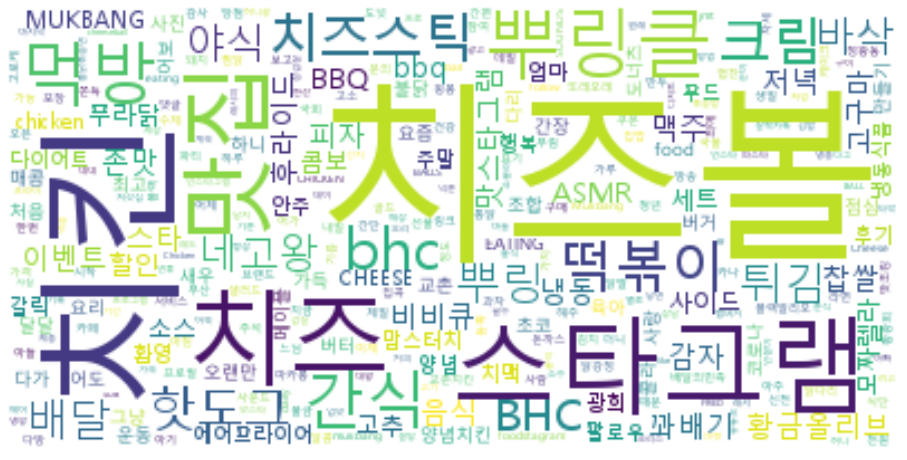

In [27]:
wordcloude_img = WordCloud(background_color = 'white', max_words=300, font_path=fontpath).generate_from_frequencies(textdict)
plt.figure(figsize=(16,16))
plt.imshow(wordcloude_img, interpolation='bilinear')
plt.axis('off')
plt.show()